#Rainfall Forecasting Model

##**BUSINESS UNDERSTANDING**

Rainfall variability in Kenya has long posed a challenge for sectors like agriculture, water management, disaster preparedness, and infrastructure planning. The country's reliance on rain-fed agriculture, which contributes approximately 30% of GDP, makes it highly vulnerable to unpredictable rainfall patterns.

Historically, rainfall forecasting in Kenya has evolved through various methods:

- **Traditional Methods –** Indigenous knowledge based on natural signs like cloud formations and animal behavior.

- **Statistical Models –** Time-series approaches using past meteorological records, but with limited accuracy.

- **Numerical Weather Prediction (NWP) Models –** Large-scale atmospheric models from agencies like the Kenya Meteorological Department (KMD), NOAA, and ECMWF have improved forecasting but often lack fine-grained, localized accuracy.

- **Machine Learning & Deep Learning –** Emerging research suggests Recurrent Neural Networks (RNNs), LSTMs, and Convolutional Neural Networks (CNNs) offer superior accuracy by learning complex weather patterns from vast datasets.


##**PROBLEM OF THE STATEMENT**

Despite these advancements, existing models struggle with capturing localized variations, leading to inaccurate short-term predictions. This project aims to leverage deep learning to improve rainfall forecasting accuracy, helping stakeholders—farmers, policymakers, and businesses—make better-informed decisions.

##**OBJECTIVES**

1.	Develop an accurate rainfall prediction model
- Train and evaluate LSTM/GRU models using historical rainfall data.
- Use RMSE and MAE as performance metrics.
2.	Identify seasonal patterns and trends in rainfall
-	Analyze long-term averages and anomalies to understand cyclical patterns.
-	Visualize trends over time for different regions.
3.	Improve early warning systems for extreme weather events
-	Detect and flag significant deviations from historical rainfall norms.
-	Provide timely alerts for flood and drought risks.
4.	Support agricultural and water resource planning
-	Generate forecasts to inform irrigation schedules and crop planning.
-	Assist policymakers in efficient water resource management.

##**STAKEHOLDERS**

1. **Farmers –** Need rainfall forecasts for better crop planning.
2. **Government Agencies –** Use insights for water and disaster management.
3. **Meteorologists –** Enhance traditional weather forecasting with AI.
4. **Insurance Companies –** Assess weather-related risks for crop insurance policies.
5. **Non-Governmental Organizations (NGOs) –** Support humanitarian efforts in flood-prone or drought-affected regions.

##**SUCCESS METRICS**

**Model Performance:** High accuracy in predicting rainfall using RMSE/MSE as evaluation metrics.






##**DATA UNDERSTANDING**

The dataset, sourced from the Humanitarian Data Exchange, provides rainfall indicators at the subnational level in Kenya. The data is derived from CHIRPS (Climate Hazards Group InfraRed Precipitation with Station data) and aggregated by administrative units. The dataset spans multiple decades and includes key rainfall indicators computed for every dekad (10-day period). Key attributes include:
1. **date:** The recorded date of the dekad.
2. **adm2_id:** Administrative unit ID.
3. **ADM2_PCODE:** Pcode reference for the administrative unit.
4. **n_pixels:** Number of satellite pixels used to calculate the rainfall statistics.
5. **rfh:** 10-day total rainfall (mm).
6. **rfh_avg:** Long-term average rainfall for the 10-day period (mm).
7. **r1h:** 1-month rolling aggregated rainfall (mm).
8. **r1h_avg:** Long-term average of 1-month rolling rainfall (mm).
9. **r3h:** 3-month rolling aggregated rainfall (mm).
10. **r3h_avg:** Long-term average of 3-month rolling rainfall (mm).
11. **rfq, r1q, r3q:** Anomalies (%) indicating deviations from the long-term averages.
12. **version:** Status of the dataset entry (e.g., 'final').

There are missing values in the r1h, r1h_avg, r3h, r3h_avg, r1q, and r3q columns, which need to be addressed for modeling purposes. The dataset allows for historical trend analysis and predictive modeling.



In [ ]:
# Loading necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

In [ ]:
# Loading the rainfall dataset
df = pd.read_csv('/content/ken-rainfall-adm2-full.csv')

# Loading the mapping data
mapping_file_path = "/content/ken_adminboundaries_tabulardata.xlsx"
mapping_df = pd.read_excel(mapping_file_path, sheet_name="ADM2")

In [ ]:
class DataUnderstanding:
  def __init__(self, df):
        self.df = df

  def first_rows(self):
        print("\nFirst rows:")
        print(self.df.head)

  def basic_info(self):
        print("\nBasic Information:")
        print(self.df.info())

  def stats_summary(self):
        print("\nBasic summary:")
        print(self.df.describe())

  def basic_shape(self):
        print("\nBasic Shape:")
        print(self.df.shape)
  def column_info(self):
        print("\nColumn Info:")
        print(self.df.columns)

In [ ]:
# Creating an instance for data_understanding
data_understanding = DataUnderstanding(df)

In [ ]:
# Check basic information about the dataset
data_understanding.basic_info()


Basic Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115852 entries, 0 to 115851
Data columns (total 14 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   date        115852 non-null  object
 1   adm2_id     115852 non-null  object
 2   ADM2_PCODE  115852 non-null  object
 3   n_pixels    115852 non-null  object
 4   rfh         115852 non-null  object
 5   rfh_avg     115852 non-null  object
 6   r1h         115706 non-null  object
 7   r1h_avg     115706 non-null  object
 8   r3h         115268 non-null  object
 9   r3h_avg     115268 non-null  object
 10  rfq         115852 non-null  object
 11  r1q         115706 non-null  object
 12  r3q         115268 non-null  object
 13  version     115852 non-null  object
dtypes: object(14)
memory usage: 12.4+ MB
None


From the observation this dataset contains 115852 rows and 14 columns.
All the columns are of object datatype.

In [ ]:
#Check Statistical summary
data_understanding.stats_summary()


Basic summary:
              date adm2_id ADM2_PCODE n_pixels       rfh  rfh_avg     r1h  \
count       115852  115852     115852   115852  115852.0   115852  115706   
unique        1588      75         73       63   79420.0     2660   96849   
top     2003-01-11   51366   KE041236     19.0       2.0  26.6711    97.0   
freq            73    1587       3174     4761      49.0       88      15   

           r1h_avg     r3h   r3h_avg       rfq      r1q         r3q version  
count   115706.000  115268    115268  115852.0   115706  115268.000  115852  
unique    2663.000  106373      2665  111352.0   112304  111913.000       3  
top        131.808   323.0  340.8011     100.0  90.3188     111.068   final  
freq        88.000       8        44      46.0        4       4.000  115632  


## Observations

- `adm2_id` has **11,582 unique values**, suggesting it represents a unique identifier for administrative regions.
- `ADM2_PCODE` has only **73 unique values**, indicating it may be a categorical code for administrative divisions.
- `n_pixels` has **63 unique values**, likely representing different pixel counts in a spatial dataset.
- `rfn`, `rfn_avg`, `rln`, and `rln_avg` contain a high number of unique values, implying they represent continuous numerical data.
- `r3h_avg`, `rfq`, `r1q`, and `r3q` have fewer unique values, suggesting they may represent categorical or aggregated metrics.
- The `version` column appears to store dataset versions, with one frequent value being **"final"**.
- Some numerical columns are stored as objects and may need conversion to proper numerical data types.


In [ ]:
# Checking the shape of the dataset
data_understanding.basic_shape()


Basic Shape:
(115852, 14)


## Observation

- The dataset contains **115,852 rows** with **14 columns**.


In [ ]:
#Check for first 5 rows
data_understanding.first_rows()


First rows:
<bound method NDFrame.head of               date   adm2_id  ADM2_PCODE                 n_pixels  \
0            #date  #adm2+id  #adm2+code  #indicator+n_pixels+num   
1       1981-01-01     51334    KE020101                     48.0   
2       1981-01-11     51334    KE020101                     48.0   
3       1981-01-21     51334    KE020101                     48.0   
4       1981-02-01     51334    KE020101                     48.0   
...            ...       ...         ...                      ...   
115847  2024-12-11     68770    KE029151                     42.0   
115848  2024-12-21     68770    KE029151                     42.0   
115849  2025-01-01     68770    KE029151                     42.0   
115850  2025-01-11     68770    KE029151                     42.0   
115851  2025-01-21     68770    KE029151                     42.0   

                       rfh                 rfh_avg                 r1h  \
0       #indicator+rfh+num  #indicator+rfh_avg+num  #i


This function returns the first five rows of our dataset.

##**DATA CLEANING**

Data cleaning is a crucial step in preparing the dataset for deep learning models. It ensures that the data is accurate, complete, and formatted correctly for analysis and training.

In [ ]:
df =df.drop([0]) #dropping the first row in our dataset
df

,date,adm2_id,ADM2_PCODE,n_pixels,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,version
1,1981-01-01,51334,KE020101,48.0,5.9583,13.5361,NaN,NaN,NaN,NaN,59.1188,NaN,NaN,final
2,1981-01-11,51334,KE020101,48.0,3.2708,15.65,NaN,NaN,NaN,NaN,40.0525,NaN,NaN,final
3,1981-01-21,51334,KE020101,48.0,4.125,14.1653,13.3542,43.3514,NaN,NaN,47.6121,43.7742,NaN,final
4,1981-02-01,51334,KE020101,48.0,3.7708,8.1097,11.1667,37.925,NaN,NaN,66.9033,44.1662,NaN,final
5,1981-02-11,51334,KE020101,48.0,9.9375,12.0465,17.8333,34.3215,NaN,NaN,87.6278,62.7987,NaN,final
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115847,2024-12-11,68770,KE029151,42.0,31.5,21.273,249.7619,93.619,471.1667,371.946,138.9258,250.6893,125.9777,final
115848,2024-12-21,68770,KE029151,42.0,34.9524,32.1563,84.619,84.0548,465.3333,359.5635,107.525,100.6,128.6202,final
115849,2025-01-01,68770,KE029151,42.0,4.8333,19.4063,71.2857,72.8357,441.6905,336.4794,40.2901,98.1288,130.3658,prelim
115850,2025-01-11,68770,KE029151,42.0,6.5714,27.7302,46.3571,79.2929,384.5714,316.0103,35.354,63.115,121.0304,prelim


We opted to drop the first row because, the first row contains column headers like `#indicator+rfh+num`, which describe the data and that is not significant for our analysis.

In [ ]:
 # Converting columns to appropriate data types
df["date"] = pd.to_datetime(df["date"], errors="coerce")
numeric_cols = ["n_pixels", "rfh", "rfh_avg", "r1h", "r1h_avg", "r3h", "r3h_avg", "rfq", "r1q", "r3q"]
df[numeric_cols] = df[numeric_cols].apply(pd.to_numeric, errors="coerce")


In [ ]:
# checking null values
df.isna().sum()

,0
date,0
adm2_id,0
ADM2_PCODE,0
n_pixels,0
rfh,0
rfh_avg,0
r1h,146
r1h_avg,146
r3h,584
r3h_avg,584


We checked for null values  in the DataFrame. The results show that some columns have missing values. The number of missing values varies across these columns. Handling these null values will be crucial for further analysis.

In [ ]:
mapping_df.head()

,ADM2_EN,ADM2_PCODE,ADM2_REF,ADM2ALT1_EN,ADM2ALT2_EN,ADM1_EN,ADM1_PCODE,ADM0_EN,ADM0_PCODE,DATE,VALIDON,VALIDTO,AREA_SQKM
0,Ainabkoi,KE027144,NaN,NaN,NaN,Uasin Gishu,KE027,Kenya,KE,2017-11-03,2019-10-31,NaN,502.561920
1,Ainamoi,KE035190,NaN,NaN,NaN,Kericho,KE035,Kenya,KE,2017-11-03,2019-10-31,NaN,245.644440
2,Aldai,KE029152,NaN,NaN,NaN,Nandi,KE029,Kenya,KE,2017-11-03,2019-10-31,NaN,467.744263
3,Alego Usonga,KE041234,NaN,NaN,NaN,Siaya,KE041,Kenya,KE,2017-11-03,2019-10-31,NaN,607.542114
4,Awendo,KE044254,NaN,NaN,NaN,Migori,KE044,Kenya,KE,2017-11-03,2019-10-31,NaN,262.959473


In [ ]:
# Keep only relevant columns from df_adm2
mapping_df = mapping_df[["ADM2_PCODE", "ADM2_EN", "ADM1_EN"]]
mapping_df.head()

,ADM2_PCODE,ADM2_EN,ADM1_EN
0,KE027144,Ainabkoi,Uasin Gishu
1,KE035190,Ainamoi,Kericho
2,KE029152,Aldai,Nandi
3,KE041234,Alego Usonga,Siaya
4,KE044254,Awendo,Migori


Dropped irrelevant columns from our mapping dataframe.

In [ ]:
# Merging the datasets on 'ADM2_PCODE'
df_merged = df.merge(mapping_df, on="ADM2_PCODE", how="left")
df_merged.head()

,date,adm2_id,ADM2_PCODE,n_pixels,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,version,ADM2_EN,ADM1_EN
0,1981-01-01,51334,KE020101,48.0,5.9583,13.5361,NaN,NaN,NaN,NaN,59.1188,NaN,NaN,final,Gichugu,Kirinyaga
1,1981-01-11,51334,KE020101,48.0,3.2708,15.6500,NaN,NaN,NaN,NaN,40.0525,NaN,NaN,final,Gichugu,Kirinyaga
2,1981-01-21,51334,KE020101,48.0,4.1250,14.1653,13.3542,43.3514,NaN,NaN,47.6121,43.7742,NaN,final,Gichugu,Kirinyaga
3,1981-02-01,51334,KE020101,48.0,3.7708,8.1097,11.1667,37.9250,NaN,NaN,66.9033,44.1662,NaN,final,Gichugu,Kirinyaga
4,1981-02-11,51334,KE020101,48.0,9.9375,12.0465,17.8333,34.3215,NaN,NaN,87.6278,62.7987,NaN,final,Gichugu,Kirinyaga


In [ ]:
df_merged.isna().sum()

,0
date,0
adm2_id,0
ADM2_PCODE,0
n_pixels,0
rfh,0
rfh_avg,0
r1h,146
r1h_avg,146
r3h,584
r3h_avg,584


In [ ]:
def drop_unnecessary_columns(df, columns_to_keep):
    """
    Drops unnecessary columns from a DataFrame, keeping only the specified columns.

    Parameters:
    - df (pd.DataFrame): The DataFrame to clean.
    - columns_to_keep (list): List of column names to retain.

    Returns:
    - pd.DataFrame: Cleaned DataFrame with only the necessary columns.
    """
    # Filter columns that actually exist in the DataFrame
    existing_columns = [col for col in columns_to_keep if col in df_merged.columns]

    return df_merged[existing_columns]

# Dropping the unnecessary columns:
columns_to_keep = ["date", "rfh", "rfh_avg", "r1h", "r1h_avg", "r3h",	"r3h_avg", "rfq", "r1q",	"r3q", "ADM2_EN", "ADM1_EN"]
df_cleaned = drop_unnecessary_columns(df_merged, columns_to_keep)

# Display the first few rows
df_cleaned.head()

,date,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,ADM2_EN,ADM1_EN
0,1981-01-01,5.9583,13.5361,NaN,NaN,NaN,NaN,59.1188,NaN,NaN,Gichugu,Kirinyaga
1,1981-01-11,3.2708,15.6500,NaN,NaN,NaN,NaN,40.0525,NaN,NaN,Gichugu,Kirinyaga
2,1981-01-21,4.1250,14.1653,13.3542,43.3514,NaN,NaN,47.6121,43.7742,NaN,Gichugu,Kirinyaga
3,1981-02-01,3.7708,8.1097,11.1667,37.9250,NaN,NaN,66.9033,44.1662,NaN,Gichugu,Kirinyaga
4,1981-02-11,9.9375,12.0465,17.8333,34.3215,NaN,NaN,87.6278,62.7987,NaN,Gichugu,Kirinyaga


Removed unwanted columns, keeping only the specified ones:
`version`: It mainly contains "prelim" and "final" values, which indicate data verification status.
`adm2_id` and `ADM2_PCODE`: These columns are administrative codes for regions.
Since we already have a separate identifier (Region and county columns) they add no analytical value.


## Handling missing values
We handled the missing values in the DataFrame using two key imputation techniques: **linear interpolation** and **group-wise median filling**. Linear interpolation was applied to specific columns to ensure missing data was filled while preserving trends, which is particularly beneficial for time-series  data analysis. The use of `limit_direction='both'` allowed for interpolation in both forward and backward directions, enhancing robustness.  

Additionally, for rainfall-related columns, we grouped the data by `'ADM1_EN'` (county) and filled missing values using the **median rainfall of each respective county**. This approach ensures that missing values are imputed based on localized rainfall patterns, maintaining consistency across different regions. Specifically, the median imputation was applied to columns `r1h`, `r1h_avg`, `r3h`, `r3h_avg`, `r1q`, and `r3q`, ensuring that missing values were replaced with the median rainfall observed within the corresponding county.

In [ ]:
# Check for missing values
missing_values = df_cleaned[["rfh", "rfh_avg", "r1h", "r1h_avg", "r3h", "r3h_avg"]].isnull().sum()
total_rows = len(df_cleaned)

# Calculating the percentage of missing values
missing_percentage = (missing_values / total_rows) * 100

# Displaying the missing value percentages
print(missing_percentage)

rfh        0.000000
rfh_avg    0.000000
r1h        0.126024
r1h_avg    0.126024
r3h        0.504096
r3h_avg    0.504096
dtype: float64


In [ ]:
# Group by the 'ADM1_EN'(county) and fill in the  missing values with the median rainfall of that County
df_cleaned["r1h"] = df_cleaned.groupby("ADM1_EN")["r1h"].transform(lambda x: x.fillna(x.median()))
df_cleaned["r1h_avg"] = df_cleaned.groupby("ADM1_EN")["r1h_avg"].transform(lambda x: x.fillna(x.median()))
df_cleaned["r3h"] = df_cleaned.groupby("ADM1_EN")["r3h"].transform(lambda x: x.fillna(x.median()))
df_cleaned["r3h_avg"] = df_cleaned.groupby("ADM1_EN")["r3h_avg"].transform(lambda x: x.fillna(x.median()))
df_cleaned["r1q"] = df_cleaned.groupby("ADM1_EN")["r1q"].transform(lambda x: x.fillna(x.median()))
df_cleaned["r3q"] = df_cleaned.groupby("ADM1_EN")["r3q"].transform(lambda x: x.fillna(x.median()))



In [ ]:
# Confirming if there are still missing values
df_cleaned.isna().sum()

,0
date,0
rfh,0
rfh_avg,0
r1h,0
r1h_avg,0
r3h,0
r3h_avg,0
rfq,0
r1q,0
r3q,0


There are no missing values.

In [ ]:
# Checking for duplicates
df_cleaned.duplicated().sum()

0

There were no duplicates in our dataset.

In [ ]:
df_cleaned['date'] = pd.to_datetime(df_cleaned['date']) # changing the datatype of the date column into datetime dtype

Converted the `date` column to datetime dtype for improved date handling and analysis. This allows for more efficient date manipulations, such as filtering, sorting, and time series operations.

In [ ]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115851 entries, 0 to 115850
Data columns (total 12 columns):
 #   Column   Non-Null Count   Dtype         
---  ------   --------------   -----         
 0   date     115851 non-null  datetime64[ns]
 1   rfh      115851 non-null  float64       
 2   rfh_avg  115851 non-null  float64       
 3   r1h      115851 non-null  float64       
 4   r1h_avg  115851 non-null  float64       
 5   r3h      115851 non-null  float64       
 6   r3h_avg  115851 non-null  float64       
 7   rfq      115851 non-null  float64       
 8   r1q      115851 non-null  float64       
 9   r3q      115851 non-null  float64       
 10  ADM2_EN  115851 non-null  object        
 11  ADM1_EN  115851 non-null  object        
dtypes: datetime64[ns](1), float64(9), object(2)
memory usage: 10.6+ MB


In [ ]:
df_cleaned.head()

,date,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,ADM2_EN,ADM1_EN
0,1981-01-01,5.9583,13.5361,60.1667,60.1660,279.5,303.7757,59.1188,93.0947,96.9206,Gichugu,Kirinyaga
1,1981-01-11,3.2708,15.6500,60.1667,60.1660,279.5,303.7757,40.0525,93.0947,96.9206,Gichugu,Kirinyaga
2,1981-01-21,4.1250,14.1653,13.3542,43.3514,279.5,303.7757,47.6121,43.7742,96.9206,Gichugu,Kirinyaga
3,1981-02-01,3.7708,8.1097,11.1667,37.9250,279.5,303.7757,66.9033,44.1662,96.9206,Gichugu,Kirinyaga
4,1981-02-11,9.9375,12.0465,17.8333,34.3215,279.5,303.7757,87.6278,62.7987,96.9206,Gichugu,Kirinyaga


Displayed the first five columns of our dataframe.

In [ ]:
df_cleaned.tail()

,date,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,ADM2_EN,ADM1_EN
115846,2024-12-11,31.5000,21.2730,249.7619,93.6190,471.1667,371.9460,138.9258,250.6893,125.9777,Tinderet,Nandi
115847,2024-12-21,34.9524,32.1563,84.6190,84.0548,465.3333,359.5635,107.5250,100.6000,128.6202,Tinderet,Nandi
115848,2025-01-01,4.8333,19.4063,71.2857,72.8357,441.6905,336.4794,40.2901,98.1288,130.3658,Tinderet,Nandi
115849,2025-01-11,6.5714,27.7302,46.3571,79.2929,384.5714,316.0103,35.3540,63.1150,121.0304,Tinderet,Nandi
115850,2025-01-21,44.6429,23.8310,56.0476,70.9675,400.4048,288.6198,172.1860,81.5730,137.4339,Tinderet,Nandi


##**EXPLORATORY ANALYSIS(EDA)**
Let's do some statistical data analysis to get a better understanding of our data through visualizations.

In [ ]:
# Step 1: Calculate the average yearly rainfall per county
county_avg_rainfall = df_cleaned.groupby("ADM1_EN")["r3h"].mean().reset_index()
county_avg_rainfall.columns = ["ADM1_EN", "r3h_avg"]

# Step 2: Define function to classify counties
def classify_region(rainfall):
    if rainfall < 75:
        return 'Arid'
    elif 75 <= rainfall < 240:
        return 'Semi-arid'
    elif 240 <= rainfall < 480:
        return 'Moderate'
    else:
        return 'High Rainfall'
# Step 3: Apply classification
county_avg_rainfall["ADM2_EN"] = county_avg_rainfall["r3h_avg"].apply(classify_region)

# Step 4: Display grouped counties
regions = county_avg_rainfall.groupby("ADM2_EN")["ADM1_EN"].apply(list).to_dict()

# Print categorized counties
for region, counties in regions.items():
    print(f"\n🌧️ {region} Counties:")
    print(", ".join(counties))



🌧️ Arid Counties:
Turkana

🌧️ High Rainfall Counties:
Vihiga

🌧️ Moderate Counties:
Baringo, Bomet, Bungoma, Busia, Elgeyo-Marakwet, Embu, Homa Bay, Kakamega, Kericho, Kiambu, Kilifi, Kirinyaga, Kisii, Kisumu, Kwale, Meru, Migori, Mombasa, Murang'a, Nakuru, Nandi, Narok, Nyamira, Nyandarua, Nyeri, Siaya, Tharaka-Nithi, Trans Nzoia, Uasin Gishu

🌧️ Semi-arid Counties:
Garissa, Isiolo, Kajiado, Kitui, Laikipia, Lamu, Machakos, Makueni, Mandera, Marsabit, Nairobi, Samburu, Taita Taveta, Tana River, Wajir, West Pokot


In [ ]:
# Statistical summary of numerical columns
df_cleaned.describe()


,date,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q
count,115851,115851.000000,115851.000000,115851.000000,115851.000000,115851.000000,115851.000000,115851.000000,115851.000000,115851.000000
mean,2003-01-10 10:17:55.236294912,32.188470,31.515715,96.606330,94.593083,290.279915,284.232541,101.442587,101.464883,101.874591
min,1981-01-01 00:00:00,0.000000,0.000000,0.175900,0.449200,2.139800,3.654300,9.762100,13.581300,18.159000
25%,1992-01-01 00:00:00,7.311500,13.529400,31.091800,44.179000,143.178450,164.702400,62.510750,72.407900,78.808400
50%,2003-01-11 00:00:00,21.000000,28.008800,76.714300,85.796700,266.588200,278.374200,89.918100,94.605200,97.102100
75%,2014-01-21 00:00:00,45.818000,45.162700,140.735050,136.456500,409.025900,394.985500,121.776000,120.179550,117.680450
max,2025-01-21 00:00:00,476.275800,131.643300,975.482800,332.292200,1498.379300,740.640200,770.968800,505.664200,434.386500
std,NaN,33.958933,22.623954,83.009296,64.283511,186.970550,153.536398,59.221370,44.185023,35.608501


This statistical summary provides us with key  insights into the dataset:

**Date Range:** The data spans from 1981-01-01 to 2025-01-21, with a median date around 2003-01-11. This suggests a long historical record of rainfall observations.

**Rainfall Variables (rfh, rfh_avg, r1h, r1h_avg, r3h, r3h_avg, rfq, r1q, r3q):**

**Mean & Median:** The average (mean) values are slightly higher than the median (50%), indicating a possible right-skewed distribution with extreme values.

**Minimum & Maximum:** Rainfall values range widely, with rfh having a max of 476.28 mm and r1h reaching nearly 975.48 mm, showing significant variability in precipitation.

**Standard Deviation (std):** High standard deviations, particularly in r3h and r1h, indicate substantial fluctuations in rainfall intensity.
Percentiles (25%, 50%, 75%): Most rainfall values fall within a moderate range, but the 75th percentile suggests a sharp increase, highlighting the presence of high-intensity rainfall events.


## 1. **UNIVARIATE ANALYSIS**

1. **Histogram For `RFH`  distribution**

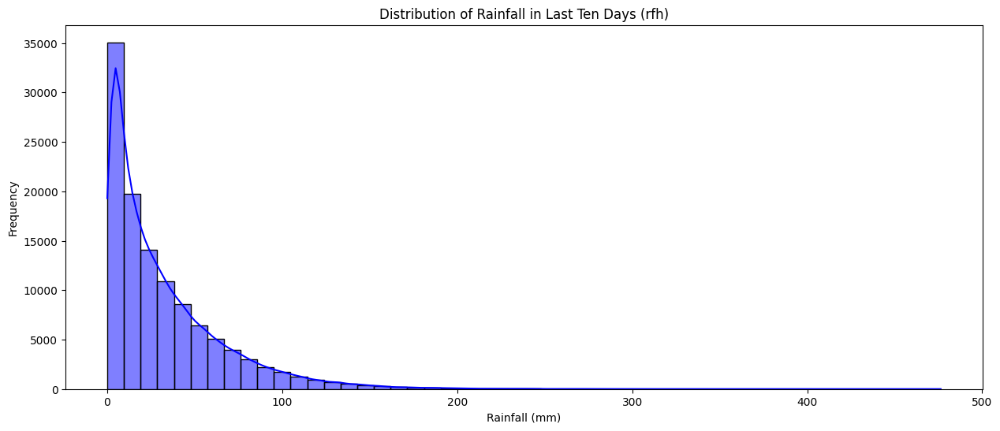

In [ ]:
# Set figure size
plt.figure(figsize=(15, 6))

# Plot histogram for rfh (Rainfall in last hour)
sns.histplot(df_cleaned["rfh"], bins=50, kde=True, color="blue")
plt.title("Distribution of Rainfall in Last Ten Days (rfh)")
plt.xlabel("Rainfall (mm)")
plt.ylabel("Frequency")
plt.show()


**Observation**

This histogram shows the distribution of rainfall in the last ten days across Kenyan counties. The data is heavily skewed toward lower rainfall amounts, with a sharp peak near zero, indicating that most rainfall events are relatively light. As rainfall increases, the frequency of occurrences drops dramatically, and the tail extends toward higher rainfall values, although these are far less common. This suggests that extreme rainfall events (with values above 100mm) are rare, while most rainfalls are light to moderate.

2. **Histograms for `RFH` distribution across the counties**

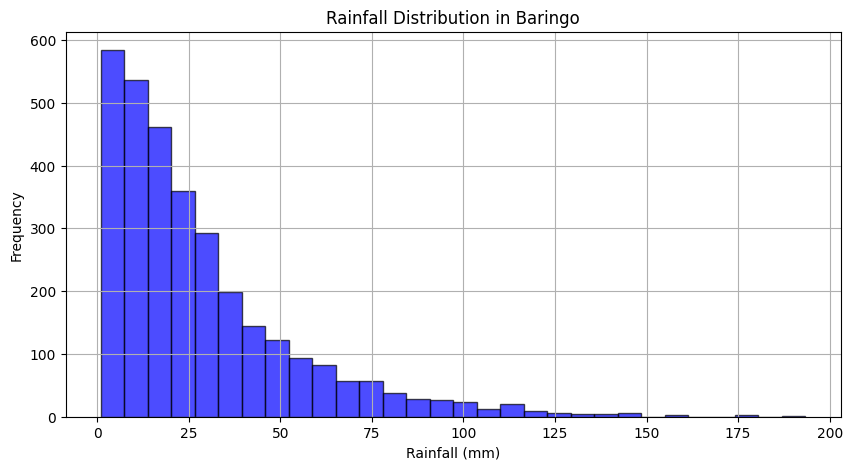

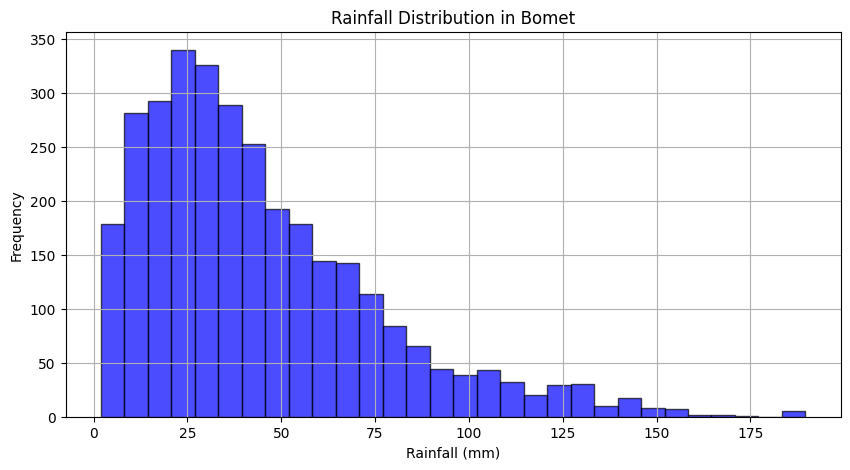

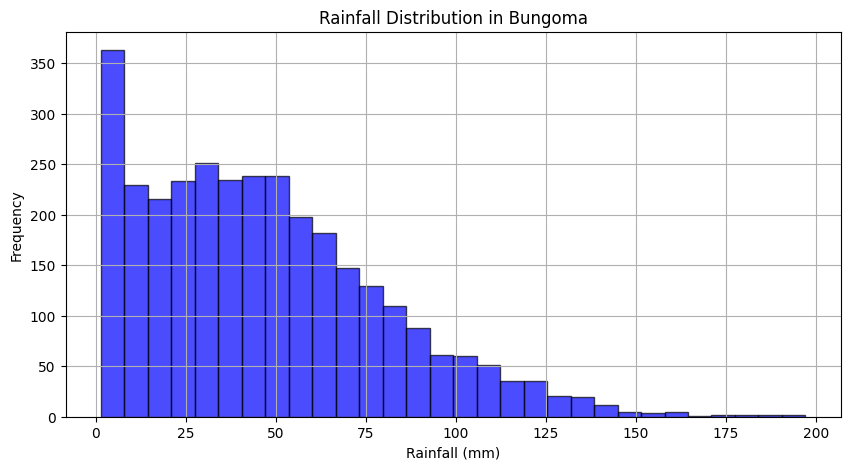

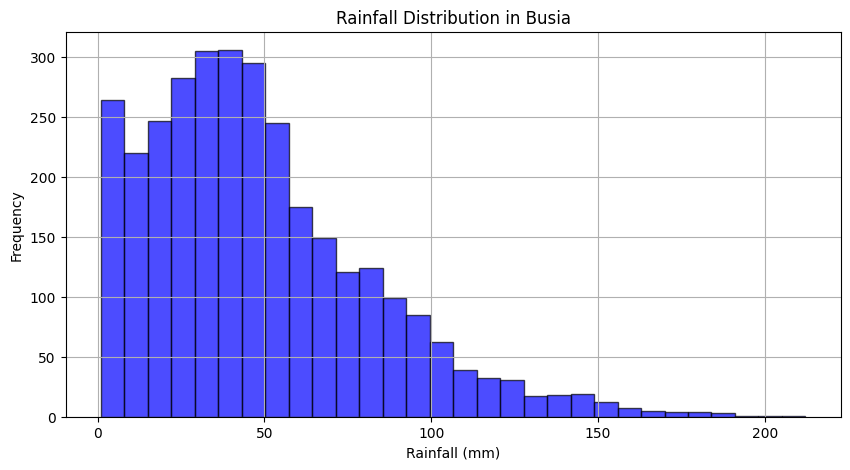

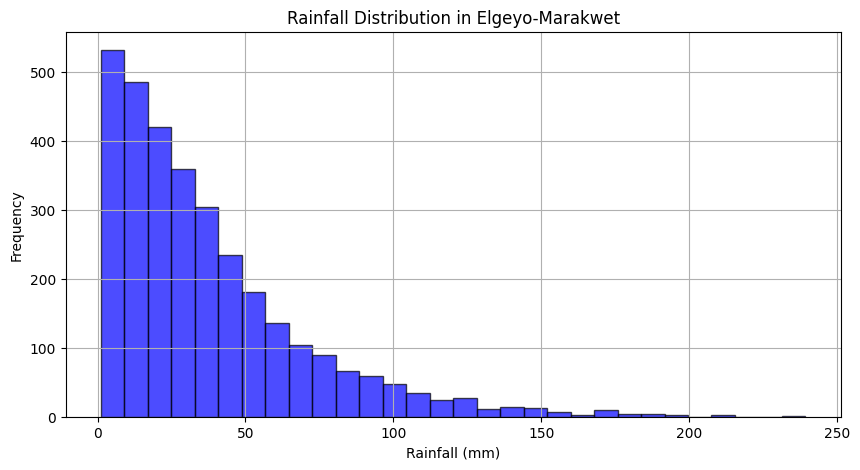

...

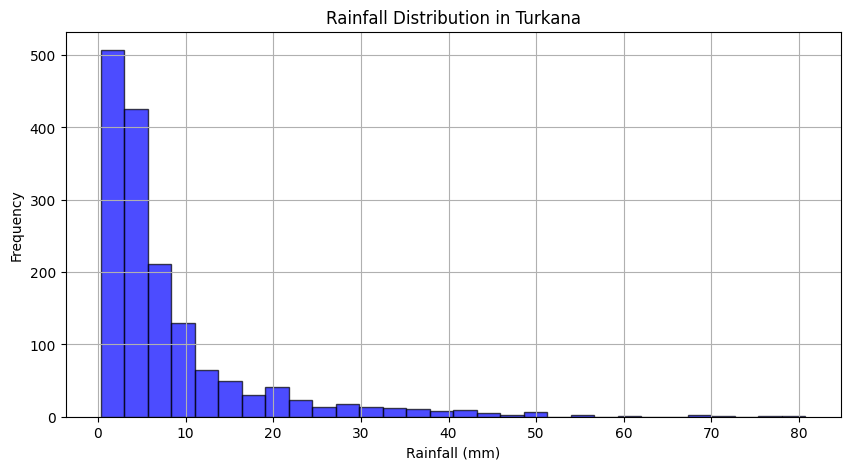

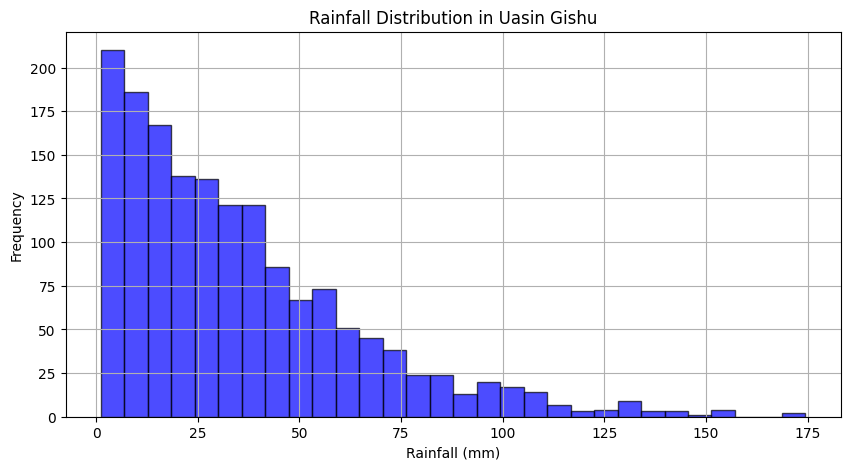

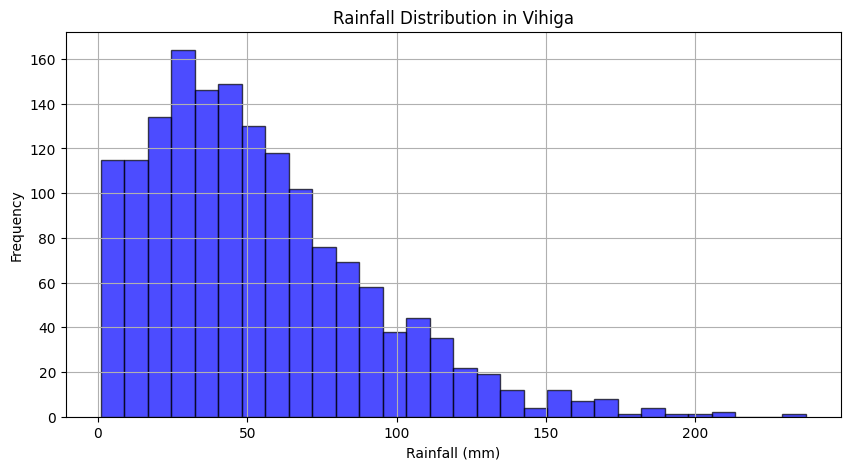

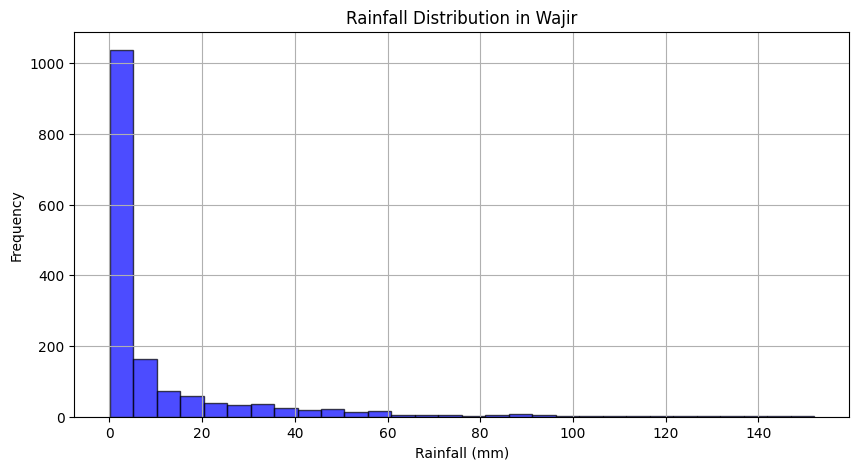

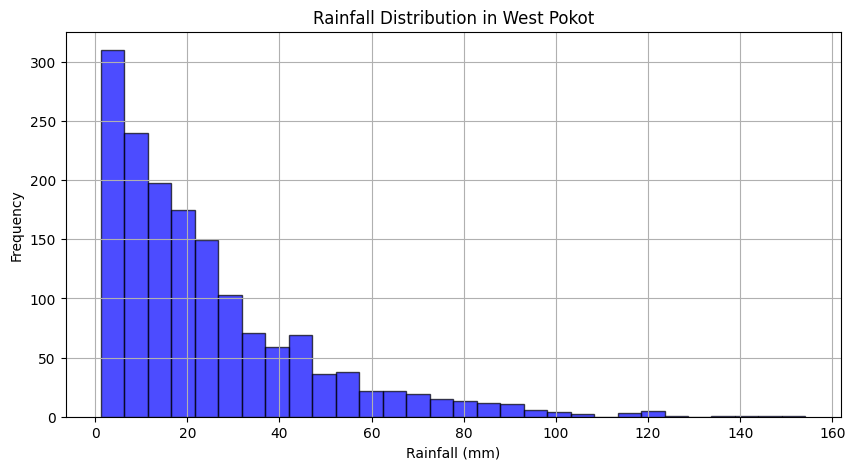

In [ ]:
# Group by County
county_groups = df_cleaned.groupby("ADM1_EN")

for county, group in county_groups:
    plt.figure(figsize=(10, 5))

    # Plot histogram for the county
    plt.hist(group["rfh"], bins=30, alpha=0.7, color='blue', edgecolor='black')

    # Formatting
    plt.title(f"Rainfall Distribution in {county}")
    plt.xlabel("Rainfall (mm)")
    plt.ylabel("Frequency")
    plt.grid(True)

    plt.show()

Most of the graphs here have a right-skewed distribution with most rainfall values falling within a moderate range, but the right skewness  suggests a sharp increase, highlighting the presence of high-intensity rainfall events.

3. **BoxPlot**

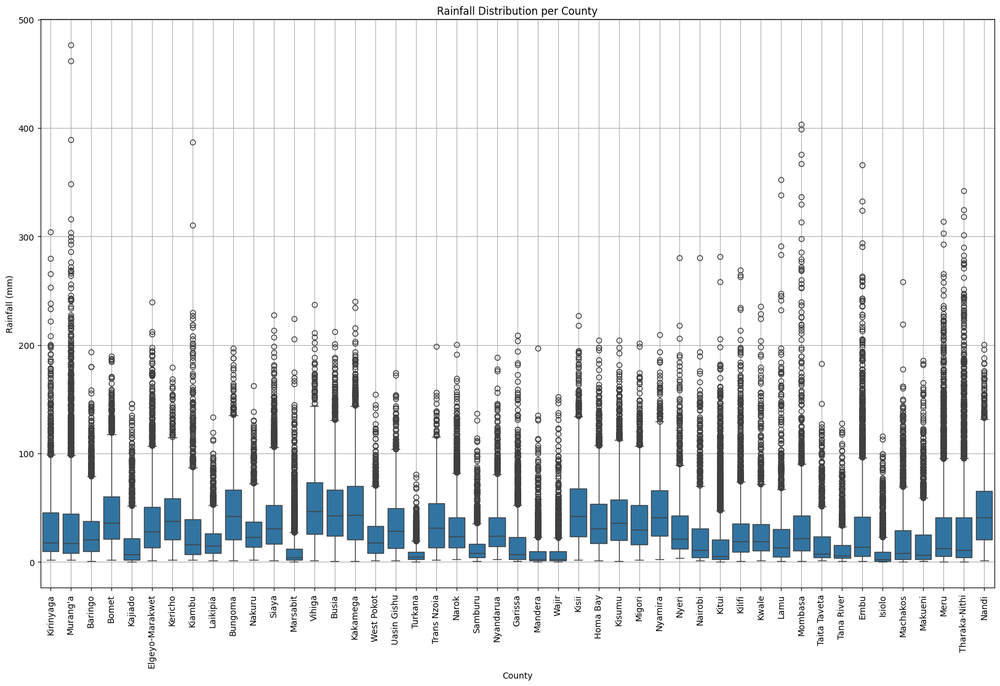

In [ ]:
# Plotting a boxplot for the distribution of rainfall across the counties in kenya
plt.figure(figsize=(20, 12))
sns.boxplot(x="ADM1_EN", y="rfh", data=df_cleaned)
plt.xticks(rotation=90)  # Rotate county names for better visibility
plt.title("Rainfall Distribution per County")
plt.ylabel("Rainfall (mm)")
plt.xlabel("County")
plt.grid(True)
plt.show()


**Observations**

The boxplot shows the distribution of rainfall across various counties, highlighting significant variability. Counties like Kirinyaga, Murang’a, and Kakamega experience high rainfall with substantial fluctuations, while arid regions such as Garissa, Mandera, and Isiolo receive consistently low rainfall. Many counties have outliers, indicating occasional extreme rainfall events. Central-kenya and western-kenya regions generally have higher median rainfall, while coastal and arid areas show lower values.
Some counties exhibit stable rainfall patterns, while others have wider interquartile ranges, reflecting seasonal variations.

4. **Bar Plot**

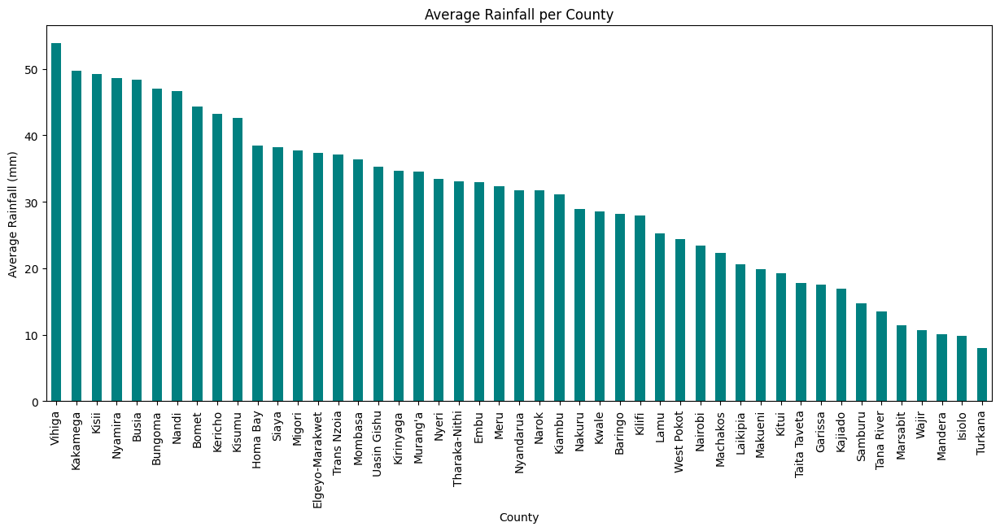

In [ ]:
# Calculate average rainfall per County
rainfall_by_county = df_cleaned.groupby("ADM1_EN")["rfh"].mean().sort_values(ascending=False)

# Plot the average rainfall per County
plt.figure(figsize=(15, 6))
rainfall_by_county.plot(kind="bar", color="teal")
plt.title("Average Rainfall per County")
plt.xlabel("County")
plt.ylabel("Average Rainfall (mm)")
plt.xticks(rotation=90)
plt.show()


 #**Key Findings**
- **Wettest Counties**: The counties on the left side of the chart, such as Vihiga, Kakamega, and Kisii, receive the highest average rainfall. These regions likely experience consistent precipitation due to their geographical and climatic conditions, such as high elevations or proximity to water bodies.  
- **Moderate Rainfall Counties**: The middle section of the chart represents counties with moderate rainfall, indicating a balanced climate suitable for both agriculture and human settlement.  
- **Driest Counties**: On the far right, counties like Turkana and Taita Taveta receive the least rainfall, which suggests arid or semi-arid conditions. These areas may experience frequent droughts and require water conservation strategies.  


5. **HeatMap**

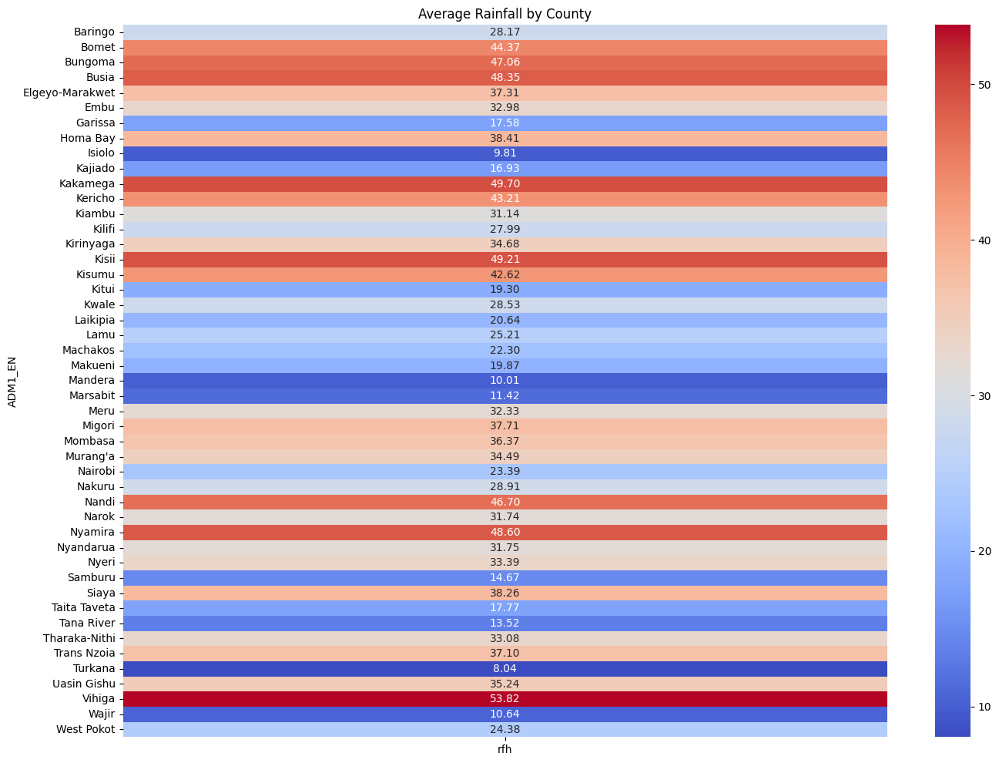

In [ ]:
plt.figure(figsize=(16, 12))  # Adjust width and height as needed
sns.heatmap(df_cleaned.pivot_table(values="rfh", index="ADM1_EN"), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Average Rainfall by County")
plt.show()


**Observations**

**Counties with High Rainfall (Red Shades):**
Counties such as Bungoma (47.05 mm), Kisii (49.21 mm), Kirinyaga (46.88 mm), and Vihiga (53.84 mm) receive higher average rainfall.
These counties are located in the western, central, and highland regions of Kenya, which generally experience high precipitation due to their geographical position (e.g., proximity to Lake Victoria, highland effects, and forest cover).

**Counties with Low Rainfall (Blue Shades):**
Counties such as Isiolo (9.81 mm), Kitui (19.00 mm), Wajir (10.87 mm), and West Pokot (12.38 mm) receive significantly lower average rainfall.
These regions are typically arid and semi-arid (ASAL) areas, characterized by dry conditions and prolonged droughts.

**Moderate Rainfall (Neutral Shades - Beige/Light Blue):**
Counties like Nairobi (23.59 mm), Nakuru (28.31 mm), and Meru (37.71 mm) have moderate rainfall levels.
These counties experience a mix of wet and dry conditions depending on seasonal variations.

**Geographical Influence on Rainfall Distribution:**
Western Kenya (high rainfall): More rainfall due to the Lake Victoria basin's influence and the western highlands, which experience orographic rainfall.

**Central Kenya (moderate to high rainfall):** Higher rainfall due to the presence of mountains (Mt. Kenya and Aberdare Ranges) that contribute to consistent precipitation.

**Coastal and Eastern Kenya (moderate to low rainfall):** More variable rainfall, with drier conditions in areas like Tana River and Kilifi, but slightly more rainfall in Kwale and Mombasa due to coastal influence.


In [ ]:
import plotly.express as px

fig = px.line(df_cleaned, x="date", y="rfh", color="ADM1_EN",
              title="Rainfall Trend per County (Interactive)")
fig.show()

In [ ]:
import plotly.express as px

# Define the county you want to zoom into
selected_county = "Nyamira"  # Change this to the county you want

# Filter the DataFrame for the selected county
df_filtered = df_cleaned[df_cleaned["ADM1_EN"] == selected_county]

# Plot the rainfall trend for the selected county
fig = px.line(df_filtered, x="date", y="rfh", title=f"Rainfall Trend for {selected_county}")

fig.show()


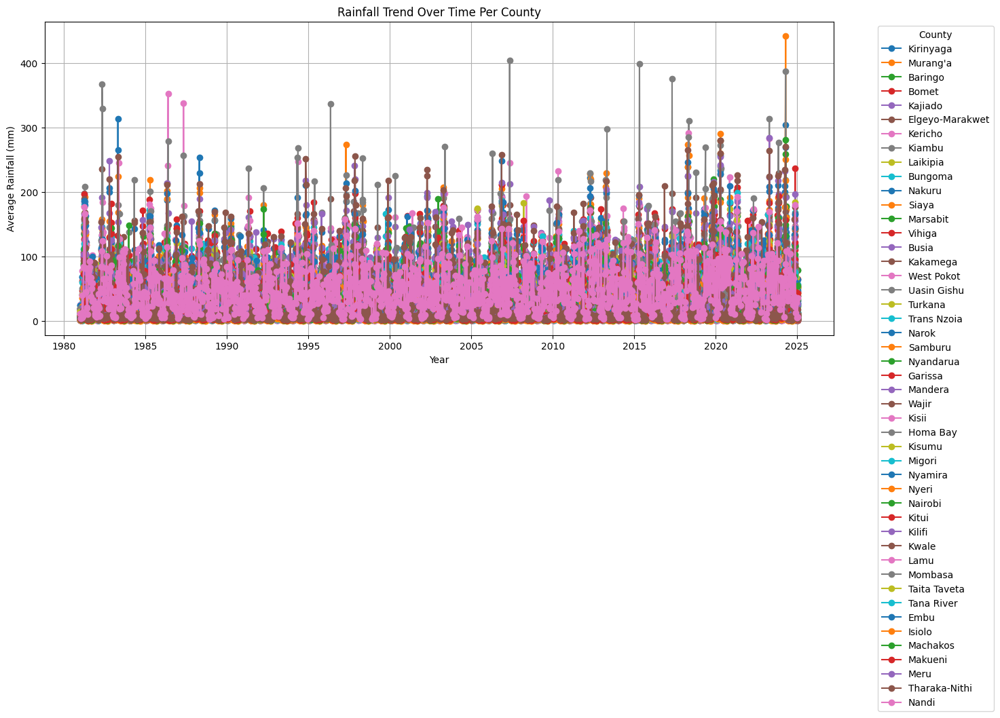

In [ ]:


# Get unique counties
counties = df_cleaned["ADM1_EN"].unique()

# Set figure size
plt.figure(figsize=(15, 6))

# Loop through each County
for county in counties:
    county_data = df_cleaned[df_cleaned["ADM1_EN"] == county]  # Filter for the county
    rainfall_trend = county_data.groupby("date")["rfh"].mean()  # Calculate mean rainfall per date

    # Plot time series for the county
    plt.plot(rainfall_trend, marker="o", linestyle="-", label=county)

# Add plot details
plt.title("Rainfall Trend Over Time Per County")
plt.xlabel("Year")
plt.ylabel("Average Rainfall (mm)")
plt.legend(title="County", bbox_to_anchor=(1.05, 1), loc="upper left")  # Place legend outside
plt.grid(True)
plt.show()


6. **Line plot**

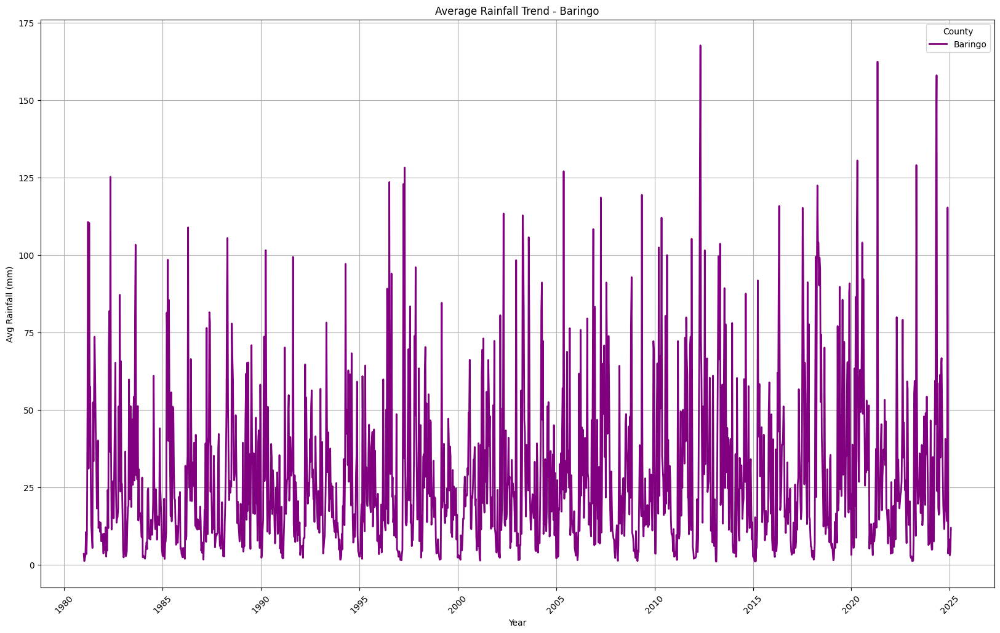

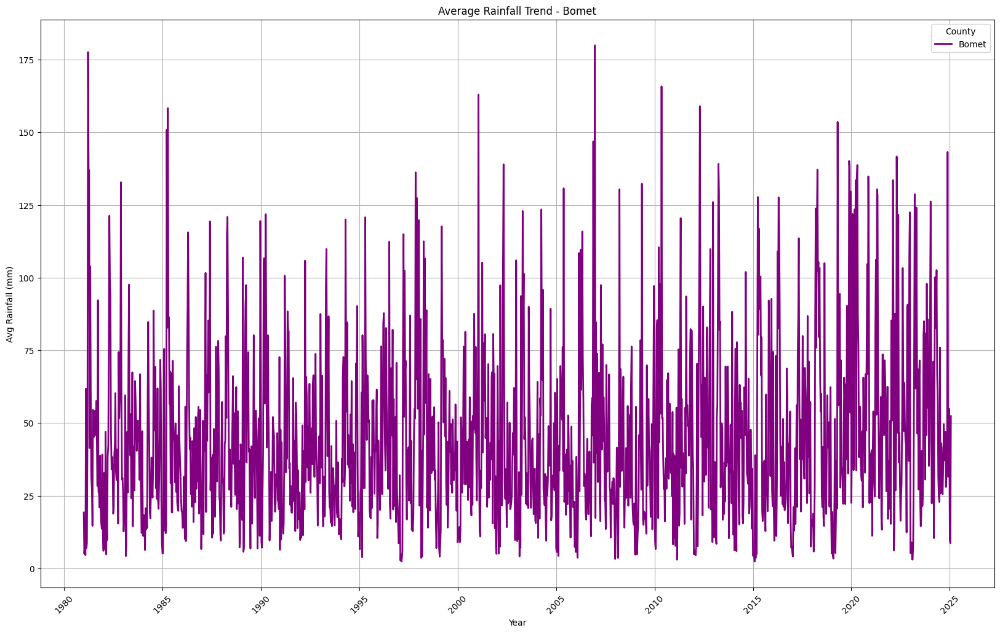

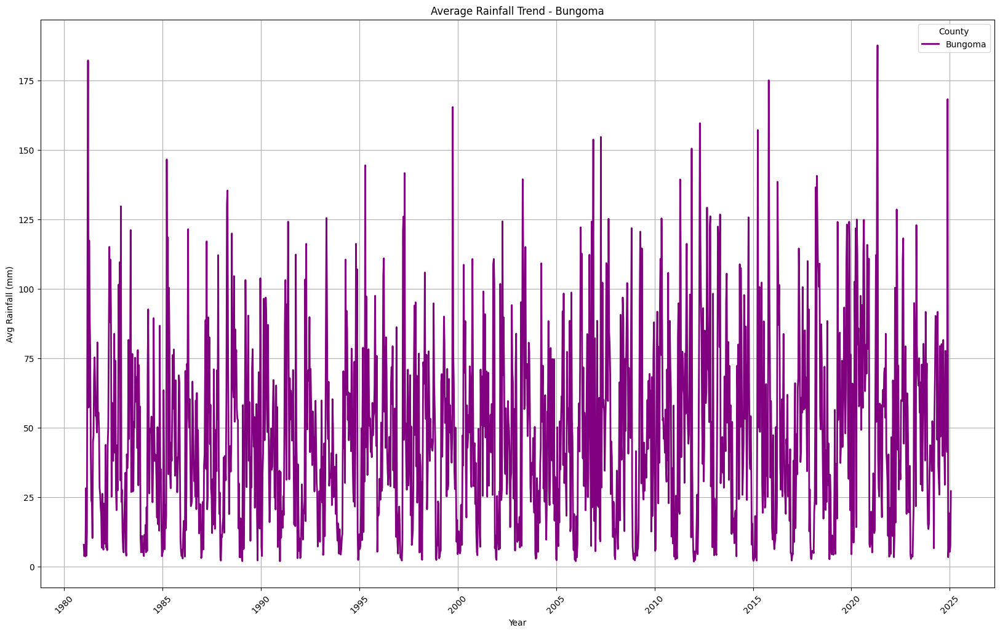

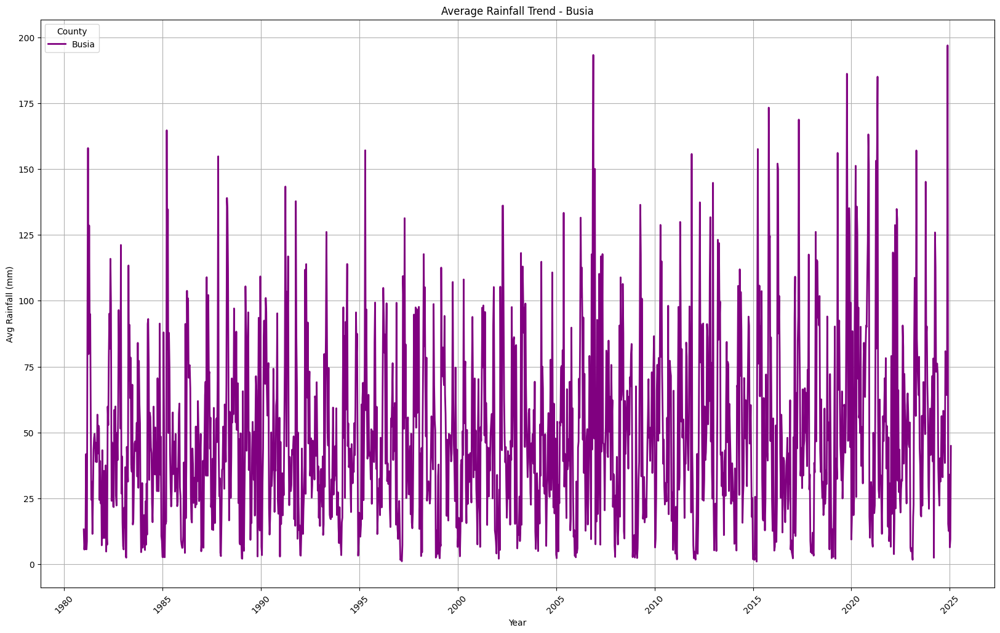

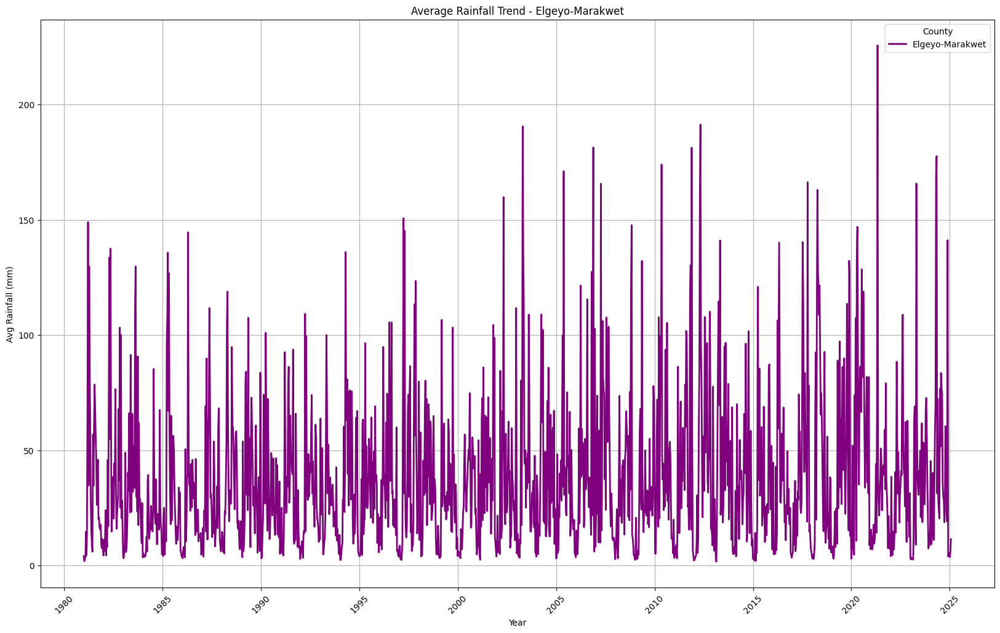

...

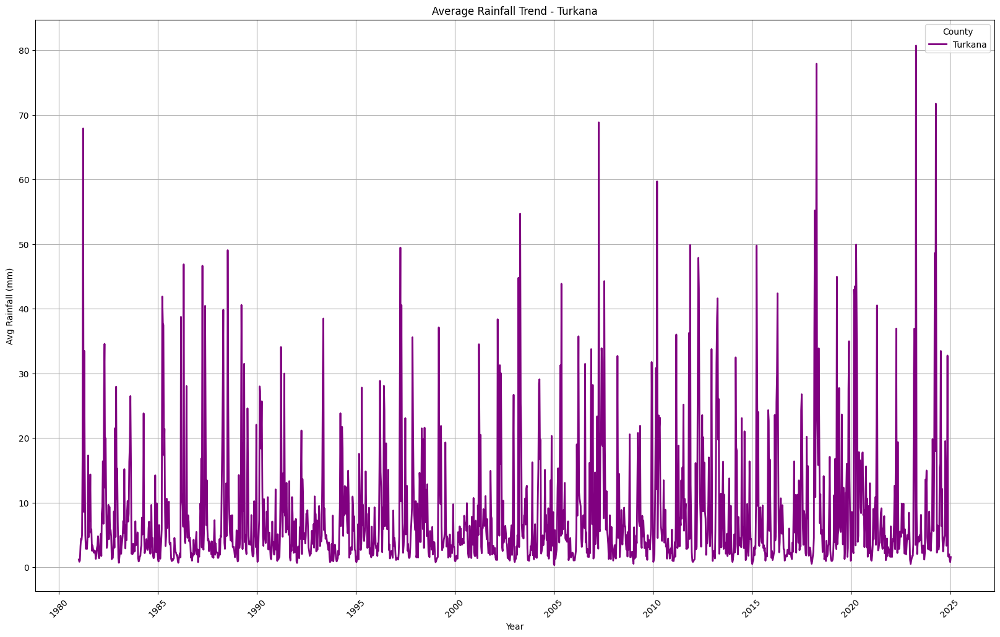

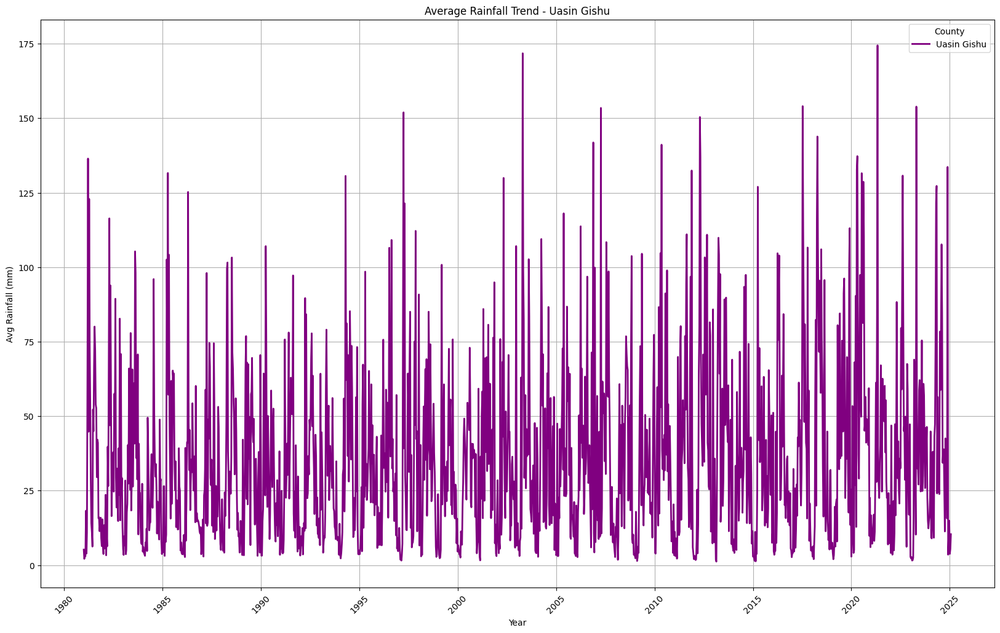

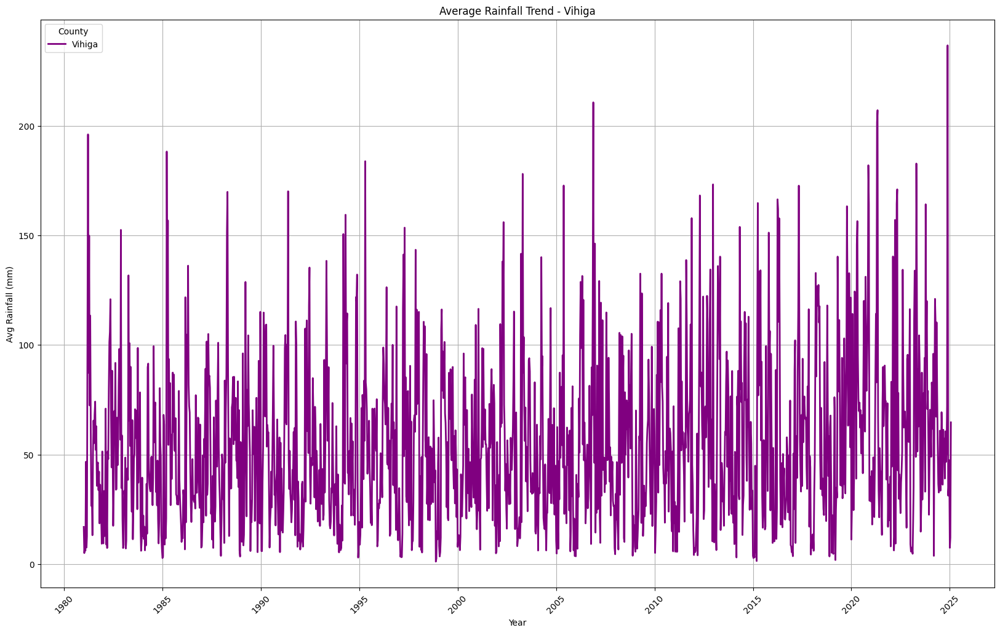

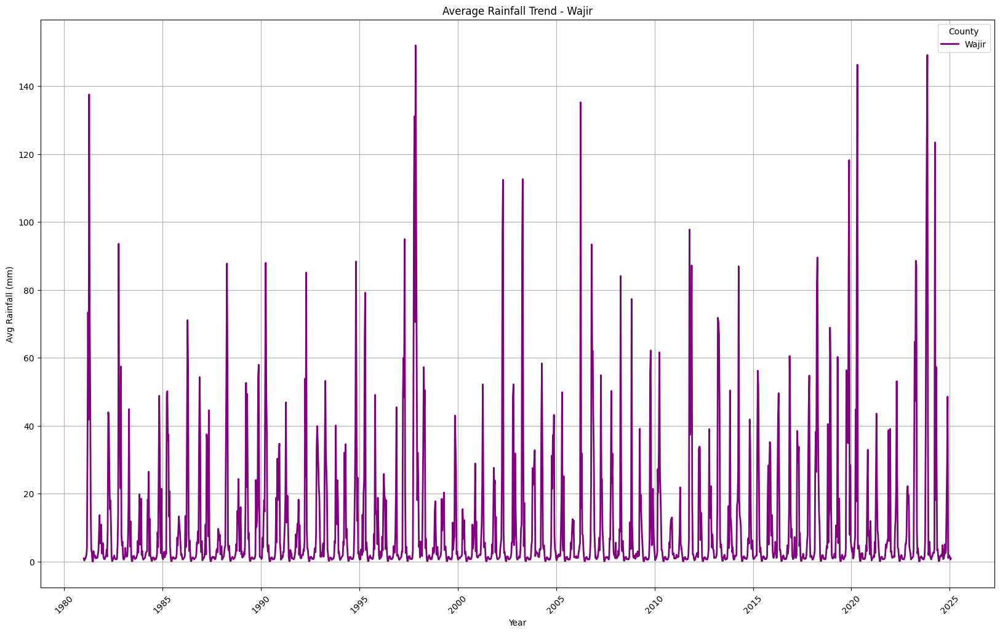

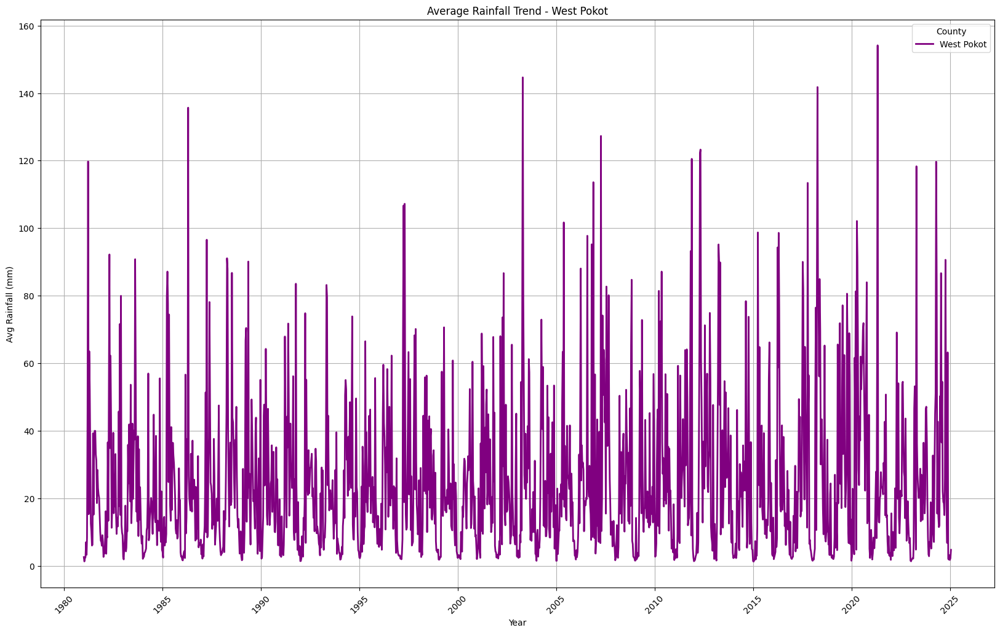

In [ ]:
# Group by County and Date, then calculate the mean rainfall
df_county_avg = df_cleaned.groupby(["ADM1_EN", "date"])["rfh"].mean().reset_index()

# Plot rainfall trends for each county
for county in df_county_avg["ADM1_EN"].unique():
    county_data = df_county_avg[df_county_avg["ADM1_EN"] == county]

    plt.figure(figsize=(20, 12))  # Set figure size
    plt.plot(county_data["date"], county_data["rfh"], label=county, linewidth=2, color="purple")  # Single line per county

    # Formatting
    plt.xlabel("Year")
    plt.ylabel("Avg Rainfall (mm)")
    plt.title(f"Average Rainfall Trend - {county}")
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
    plt.grid(True)  # Add grid for better visibility
    plt.legend(title="County")

    # Show plot for each county separately
    plt.show()


**Observations**

The rainfall data across various counties in Kenya shows significant variability, with some regions experiencing extreme fluctuations while others have more stable patterns. Counties like Bomet and Bungoma exhibit highly variable and frequent extreme rainfall events, while coastal regions such as Mombasa and Lamu show distinct wet seasons with occasional heavy downpours. Semi-arid areas like Garissa and Mandera have lower, less frequent rainfall, reflecting their drier climates. Overall, most counties display noticeable year-to-year variability, with recent trends suggesting an increase in extreme weather events in several regions.

2. ## **Bivariate Analysis**
**Heat map showing correlation between columns**

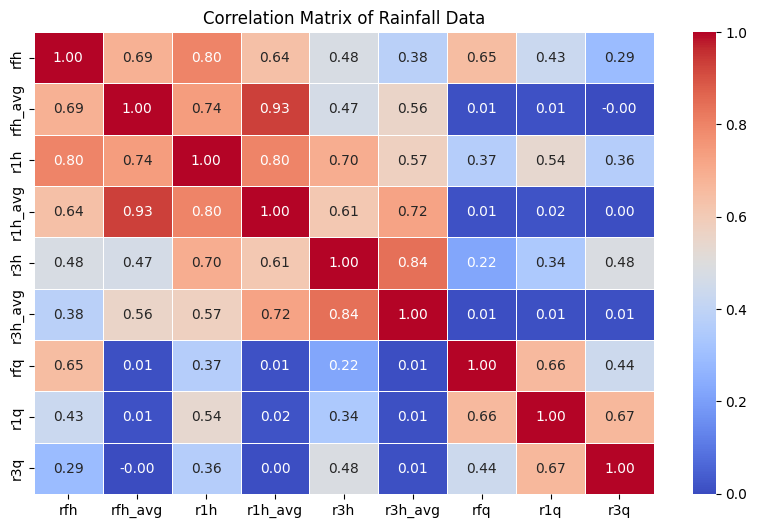

In [ ]:
# Select only numeric columns for correlation
numeric_df = df_cleaned.select_dtypes(include=["number"])

# Compute correlation matrix
plt.figure(figsize=(10, 6))
sns.heatmap(numeric_df.corr(), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)

# Formatting
plt.title("Correlation Matrix of Rainfall Data")
plt.show()


**Observations**

**Strong Positive Correlations:**
`rfh` and `r1h` (0.80), `rfh` and `rfh_avg` (0.69), and `r1h` and `r1h_avg` (0.80) suggest that recent rainfall measurements closely follow their respective long-term averages.

`r1h` and `r3h` (0.70), and `r1h_avg` and `r3h_avg` (0.61) indicate that aggregated rainfall over different periods tends to be strongly related.

**Long-term Aggregates Are Highly Correlated:**
`r1h_avg` and `rfh_avg` (0.93), `r3h_avg` and `rfh_avg` (0.84), and `r1h_avg` and `r3h_avg` (0.61) suggest that historical rainfall patterns are stable and closely related over different timescales.

**Rainfall Anomalies and Aggregated Rainfall:**
`rfq` (rainfall anomaly) correlates moderately with `rfh` (0.65), implying that recent deviations from expected rainfall are influenced by short-term rainfall trends.
`r1q` (1-month anomaly) and r3q (3-month anomaly) have a moderate correlation (0.67), suggesting that anomalies in monthly rainfall tend to persist over longer periods.

## **Decomposition**

Decomposition is a technique used in time series analysis to break down a dataset into its core components: **trend**, **seasonality**, and **residual (random noise)**. This helps in understanding underlying patterns and making better forecasts. The **trend** shows long-term movement, **seasonality** captures repeating patterns, and the **residual** represents irregular fluctuations. Decomposition is especially useful for identifying seasonal effects and making data-driven decisions in forecasting models.

<Figure size 1200x800 with 0 Axes>

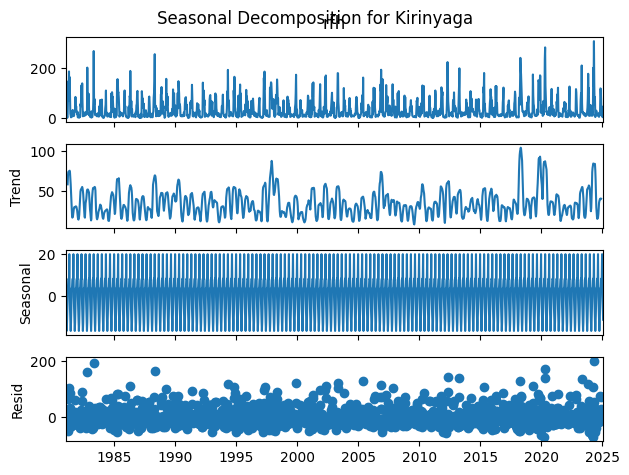

<Figure size 1200x800 with 0 Axes>

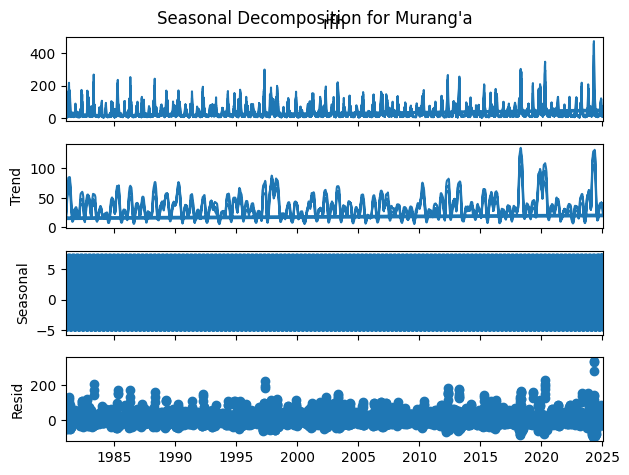

<Figure size 1200x800 with 0 Axes>

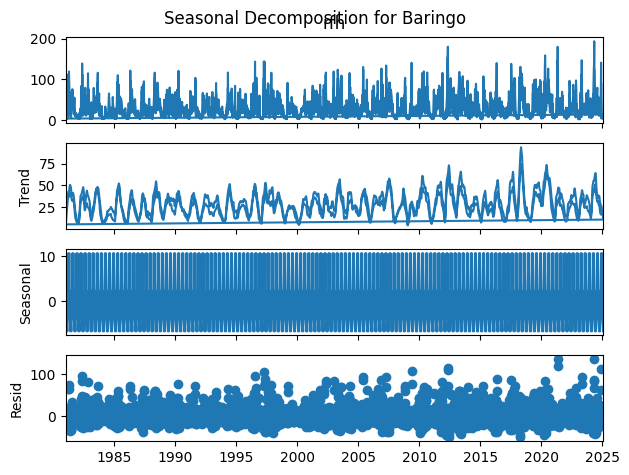

<Figure size 1200x800 with 0 Axes>

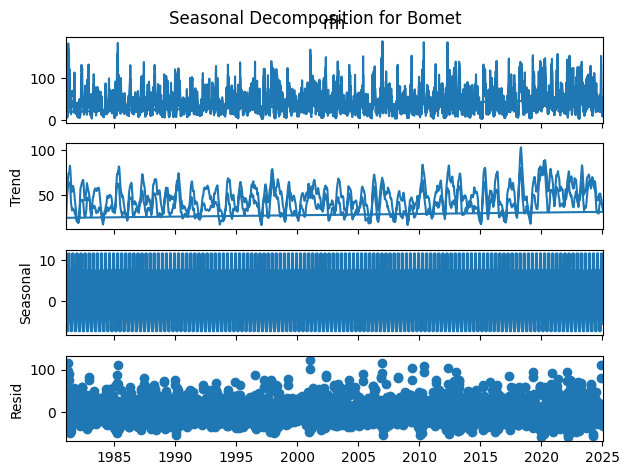

<Figure size 1200x800 with 0 Axes>

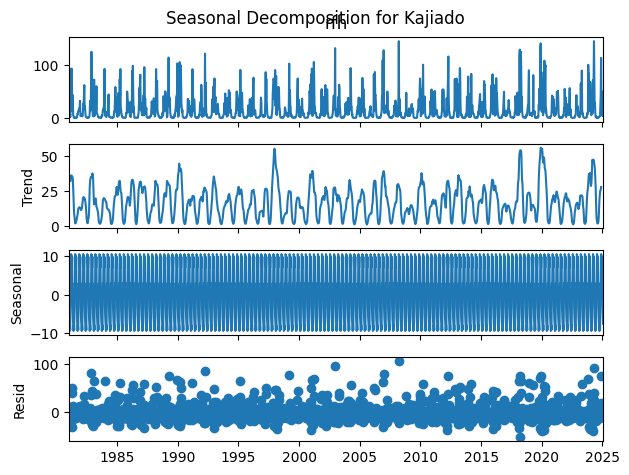

<Figure size 1200x800 with 0 Axes>

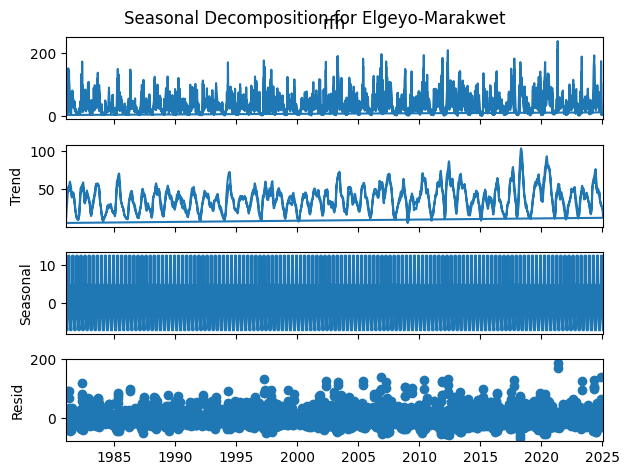

<Figure size 1200x800 with 0 Axes>

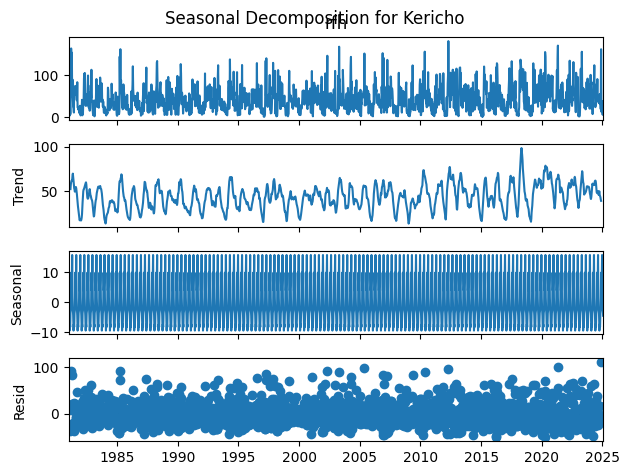

<Figure size 1200x800 with 0 Axes>

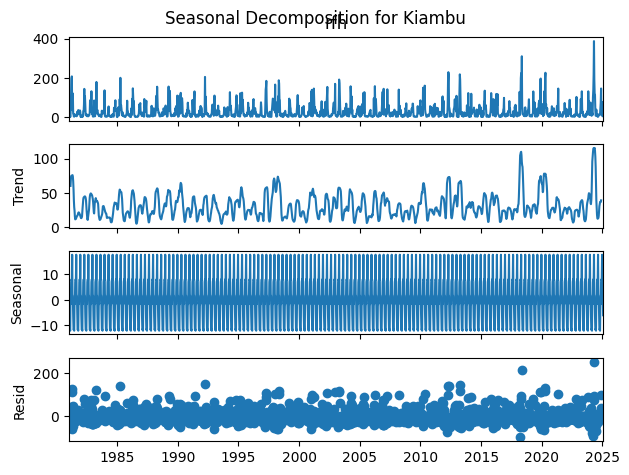

<Figure size 1200x800 with 0 Axes>

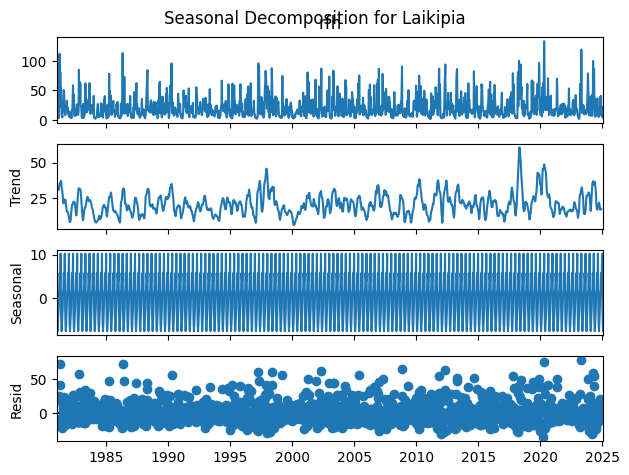

<Figure size 1200x800 with 0 Axes>

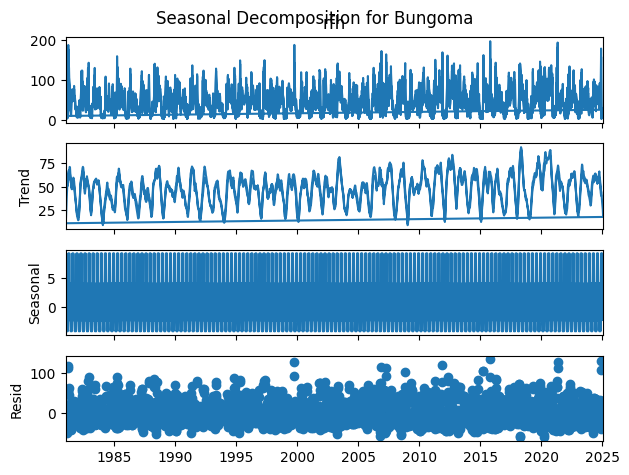

<Figure size 1200x800 with 0 Axes>

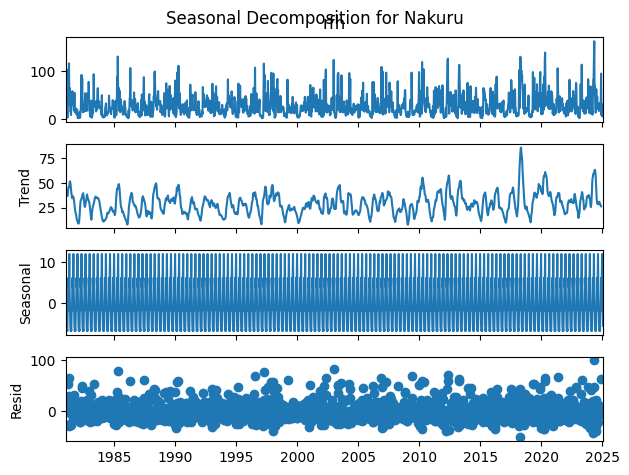

<Figure size 1200x800 with 0 Axes>

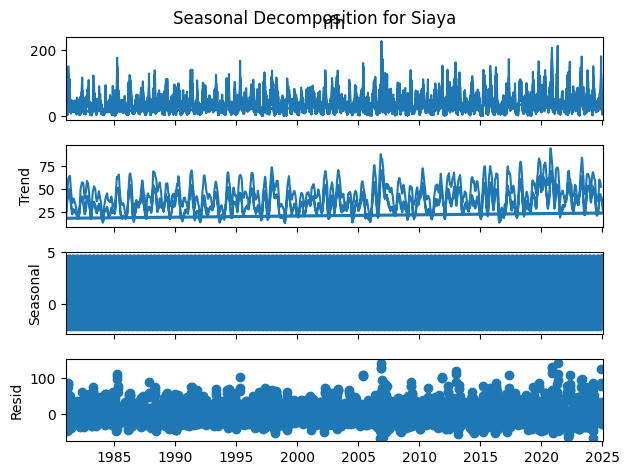

<Figure size 1200x800 with 0 Axes>

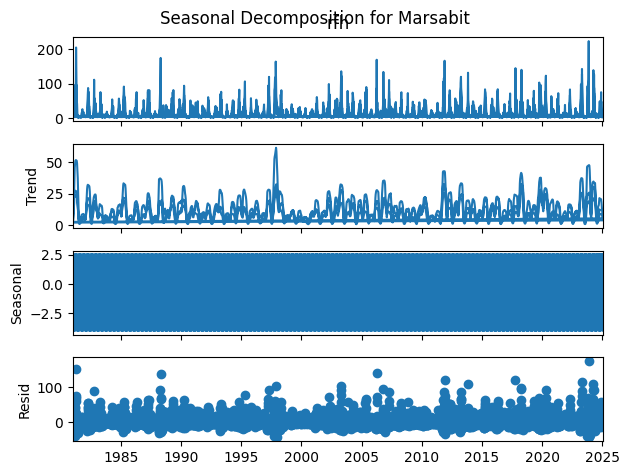

<Figure size 1200x800 with 0 Axes>

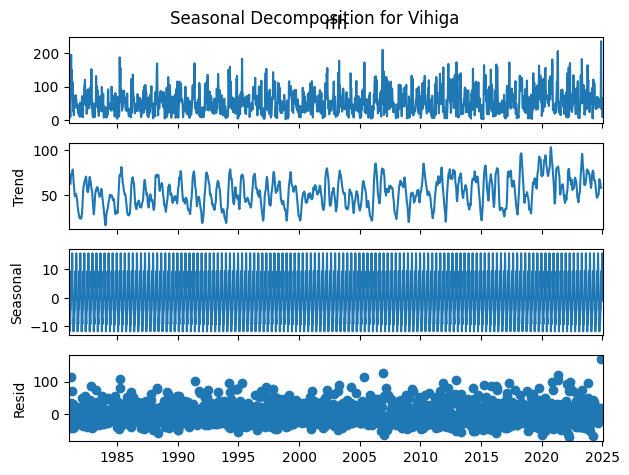

<Figure size 1200x800 with 0 Axes>

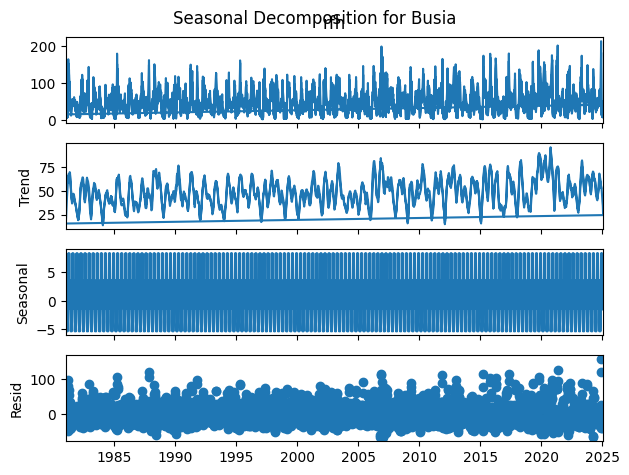

<Figure size 1200x800 with 0 Axes>

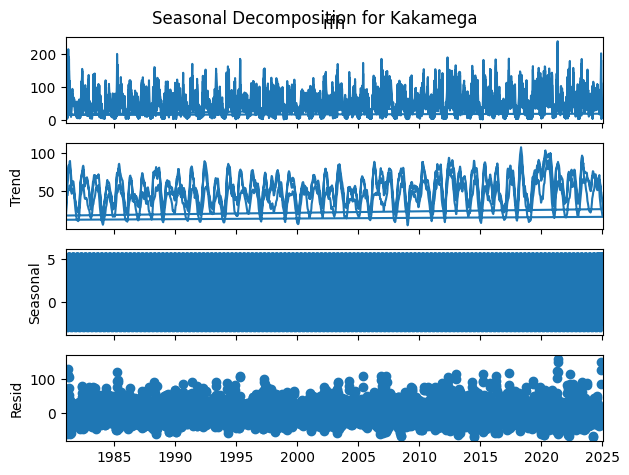

<Figure size 1200x800 with 0 Axes>

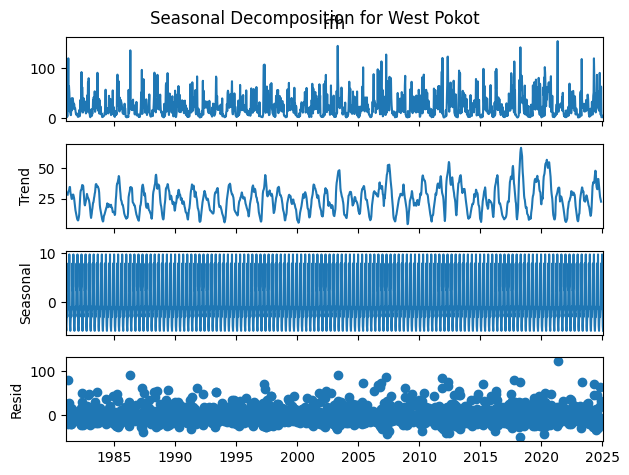

<Figure size 1200x800 with 0 Axes>

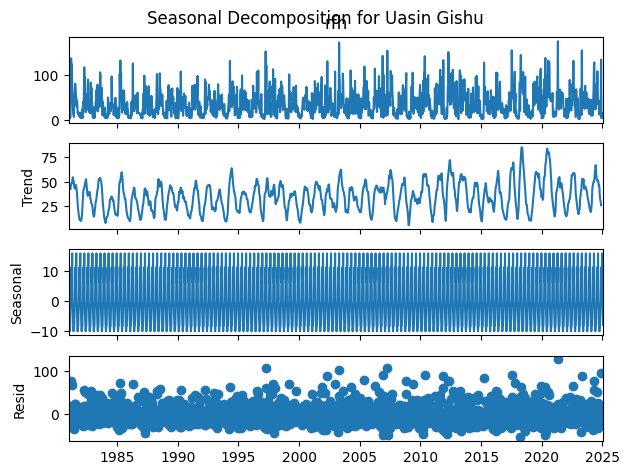

<Figure size 1200x800 with 0 Axes>

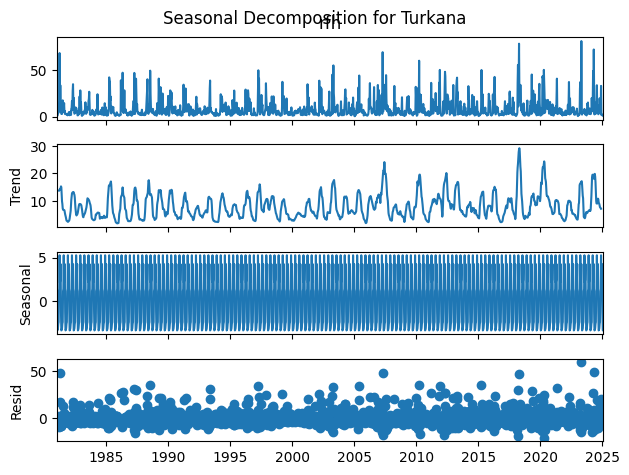

<Figure size 1200x800 with 0 Axes>

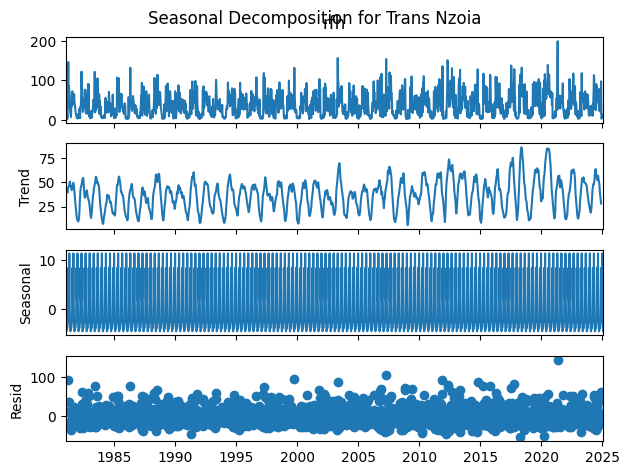

<Figure size 1200x800 with 0 Axes>

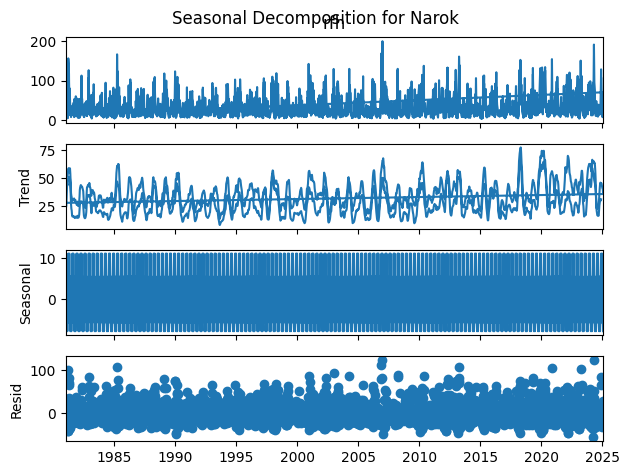

<Figure size 1200x800 with 0 Axes>

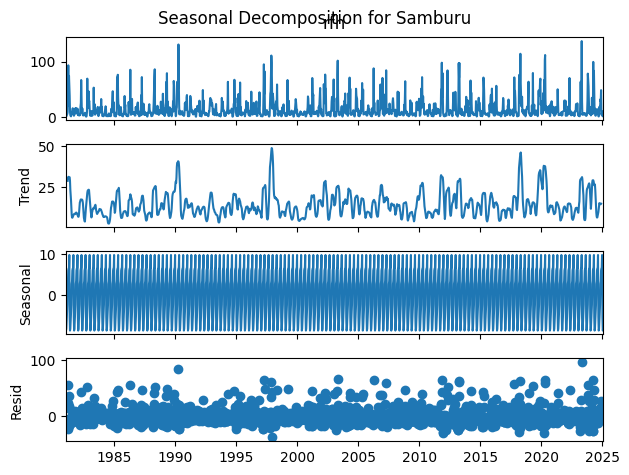

<Figure size 1200x800 with 0 Axes>

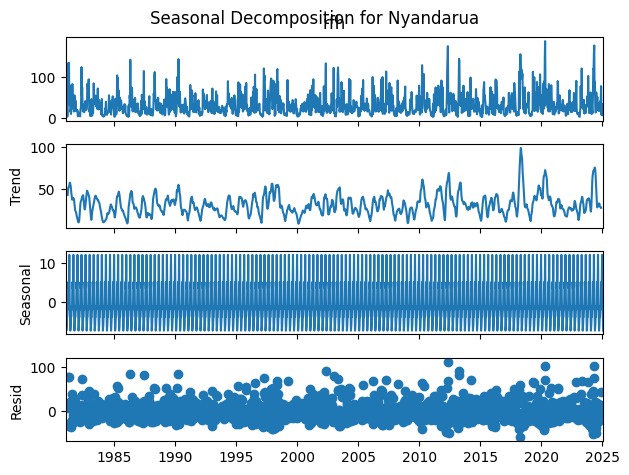

<Figure size 1200x800 with 0 Axes>

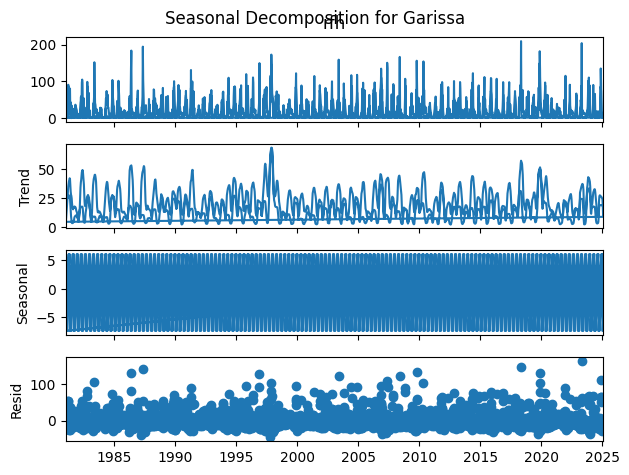

<Figure size 1200x800 with 0 Axes>

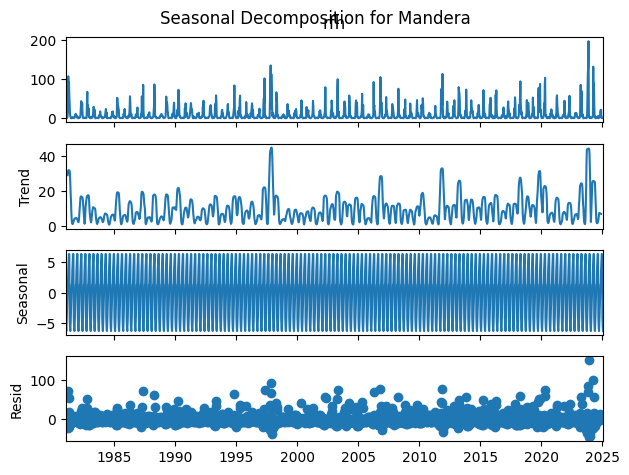

<Figure size 1200x800 with 0 Axes>

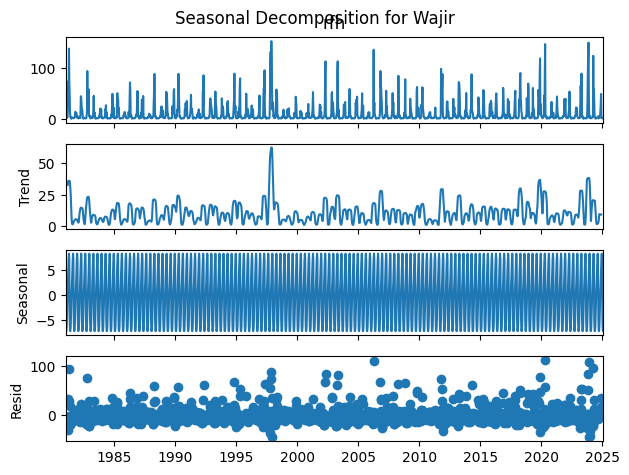

<Figure size 1200x800 with 0 Axes>

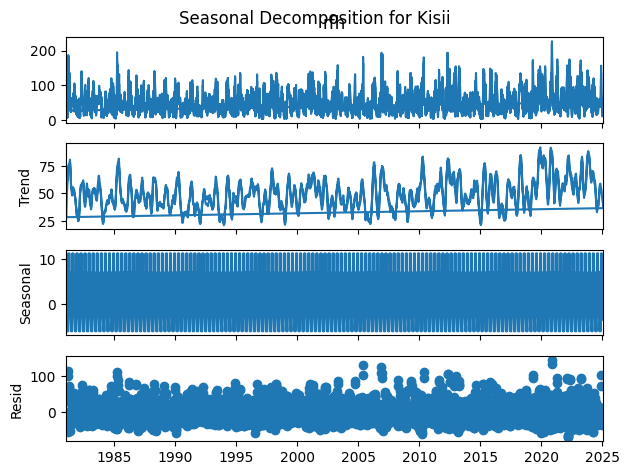

<Figure size 1200x800 with 0 Axes>

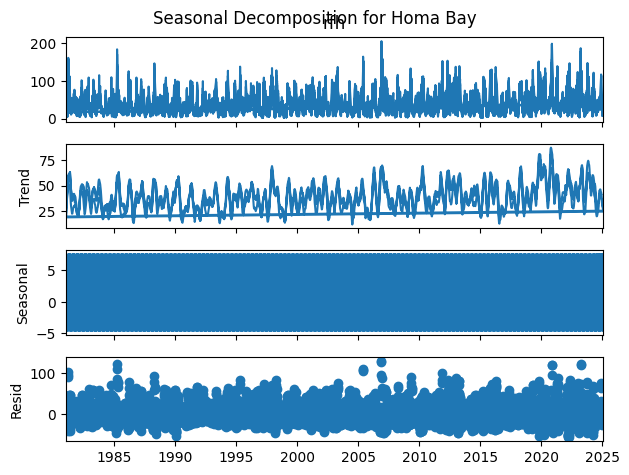

<Figure size 1200x800 with 0 Axes>

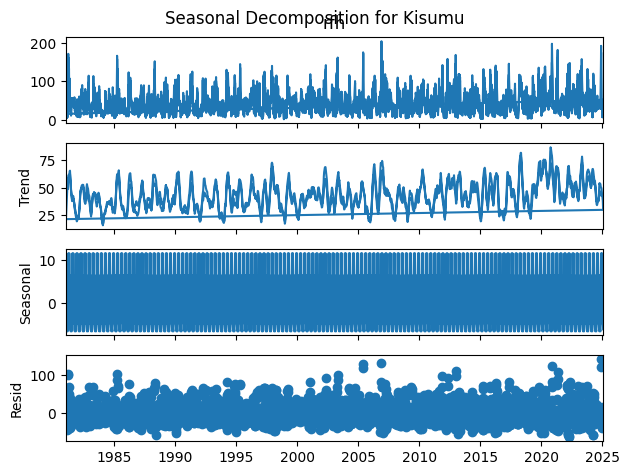

<Figure size 1200x800 with 0 Axes>

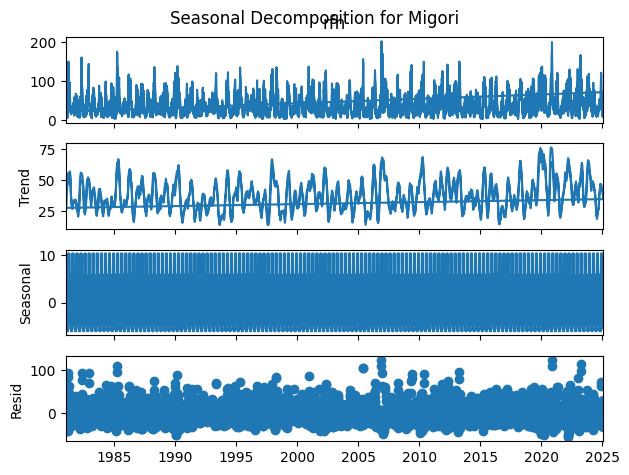

<Figure size 1200x800 with 0 Axes>

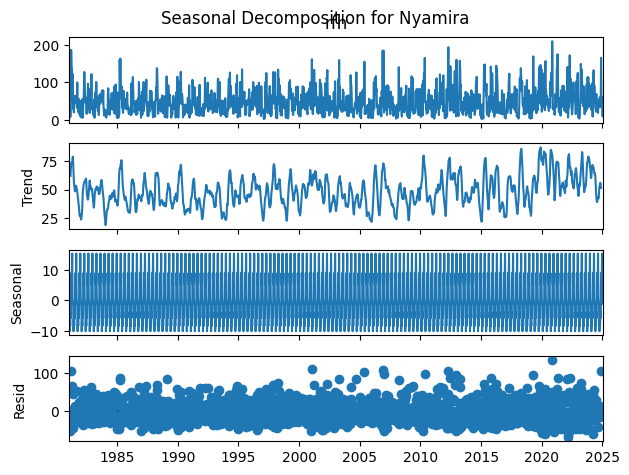

<Figure size 1200x800 with 0 Axes>

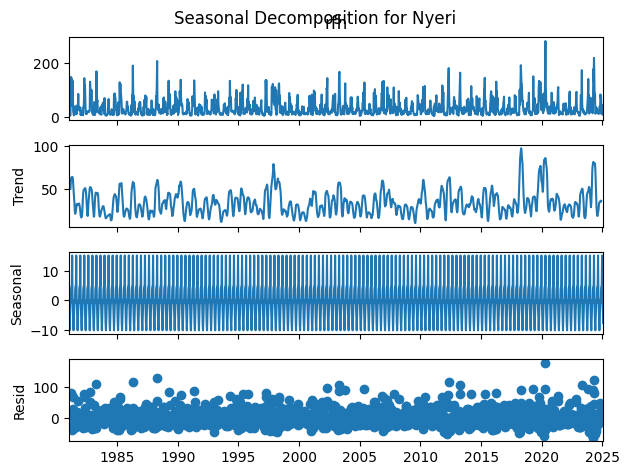

<Figure size 1200x800 with 0 Axes>

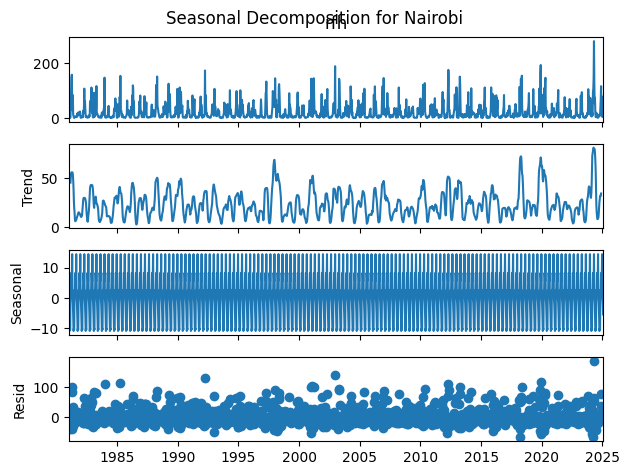

<Figure size 1200x800 with 0 Axes>

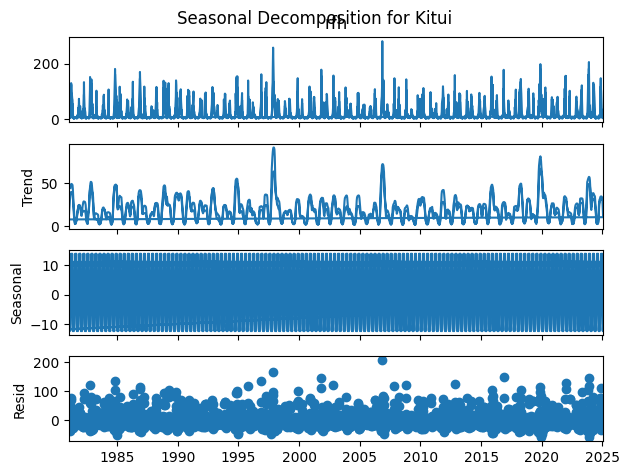

<Figure size 1200x800 with 0 Axes>

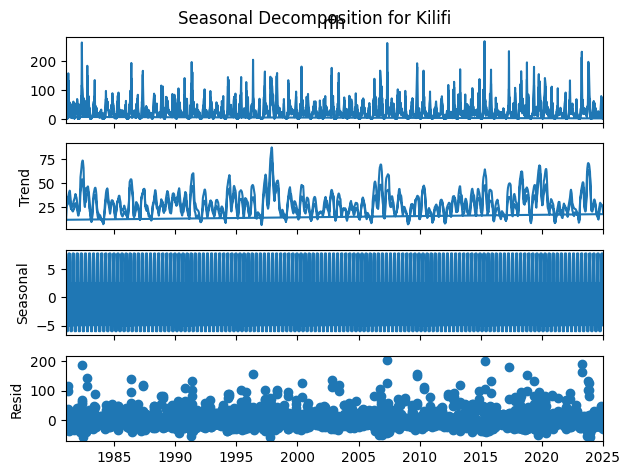

<Figure size 1200x800 with 0 Axes>

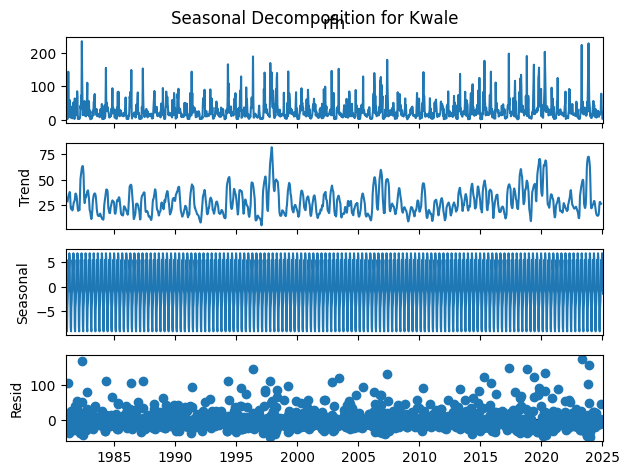

<Figure size 1200x800 with 0 Axes>

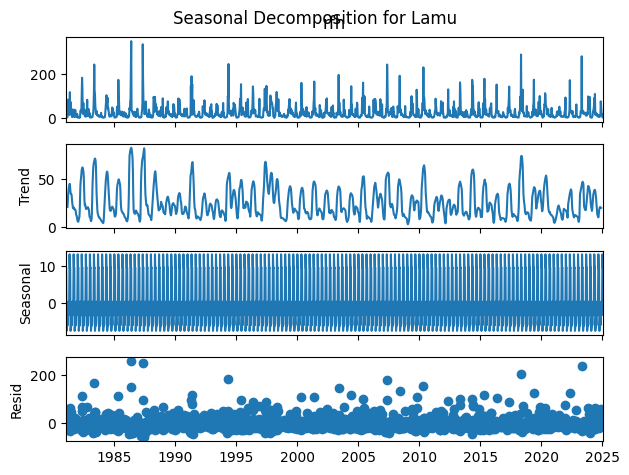

<Figure size 1200x800 with 0 Axes>

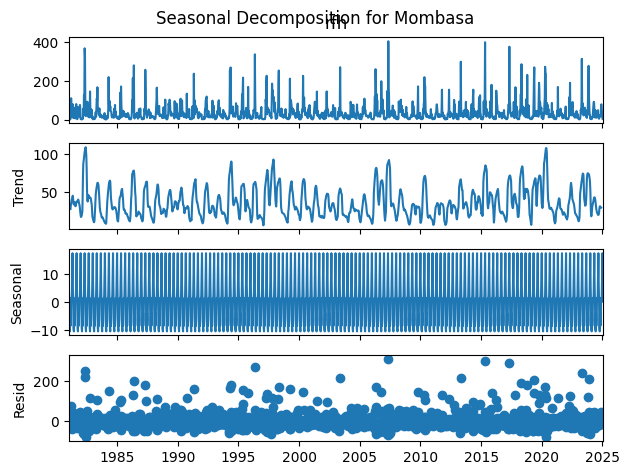

<Figure size 1200x800 with 0 Axes>

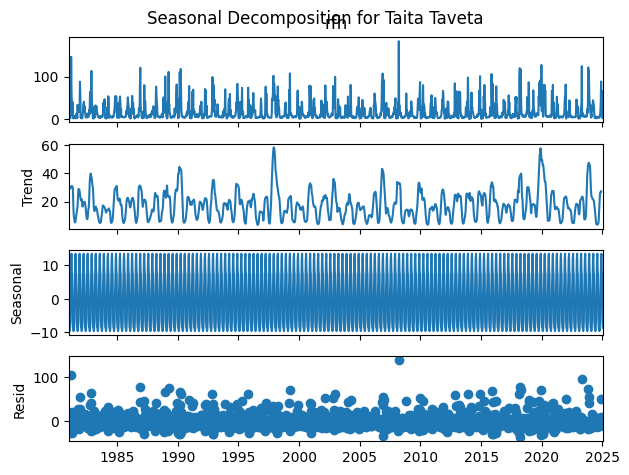

<Figure size 1200x800 with 0 Axes>

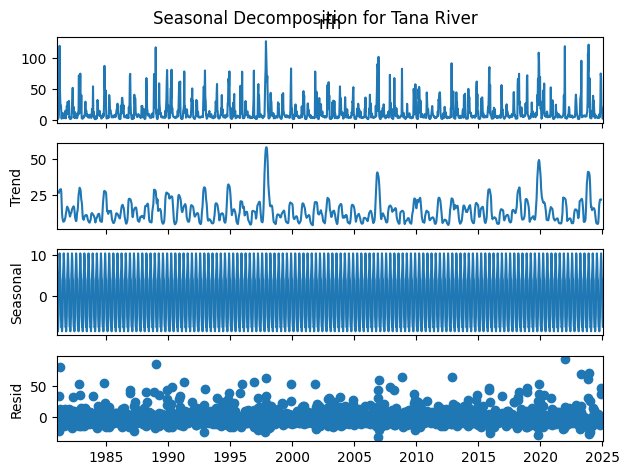

<Figure size 1200x800 with 0 Axes>

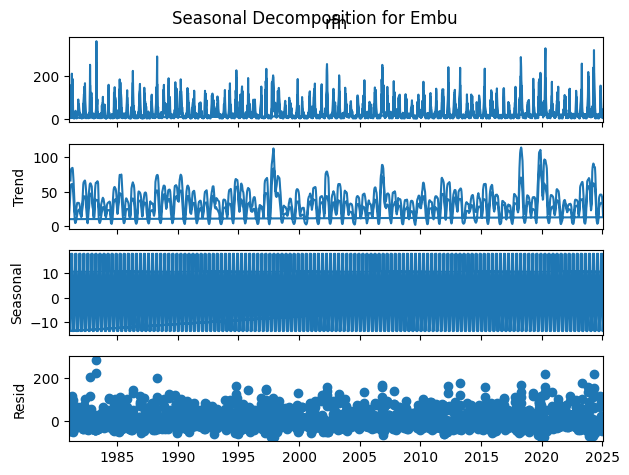

<Figure size 1200x800 with 0 Axes>

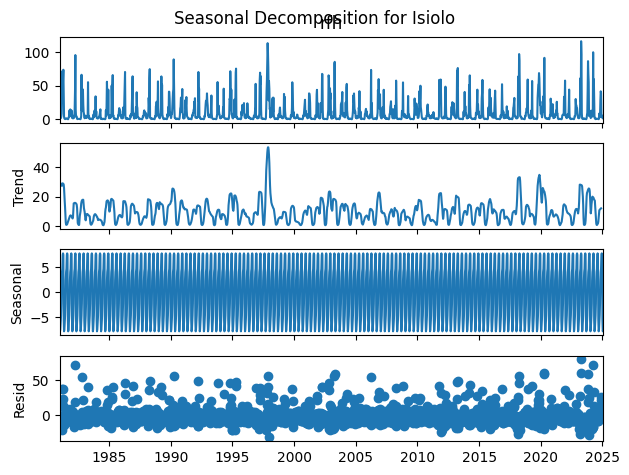

<Figure size 1200x800 with 0 Axes>

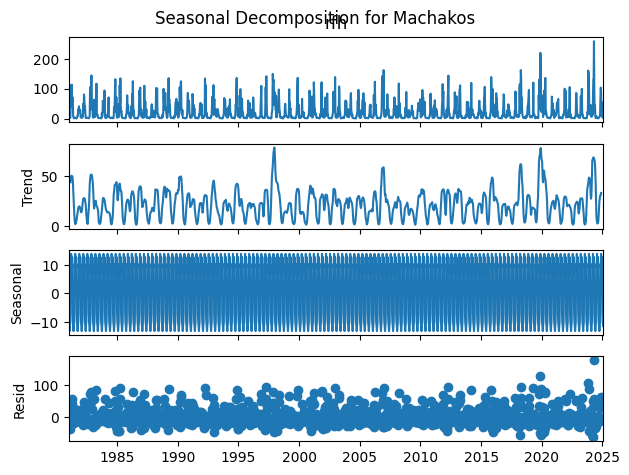

<Figure size 1200x800 with 0 Axes>

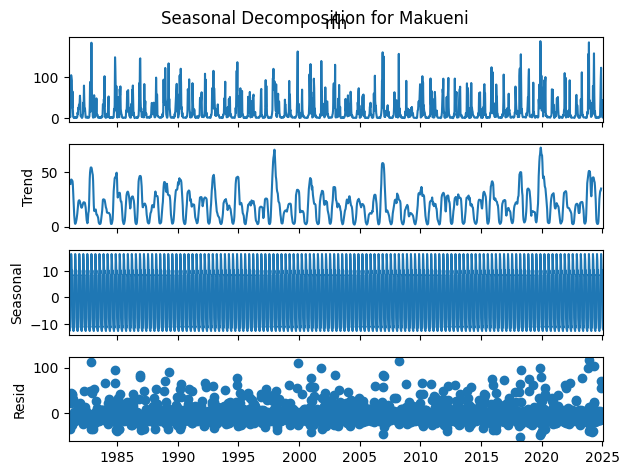

<Figure size 1200x800 with 0 Axes>

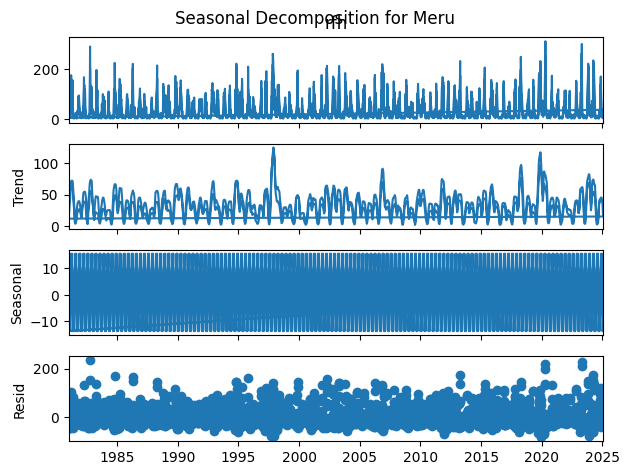

<Figure size 1200x800 with 0 Axes>

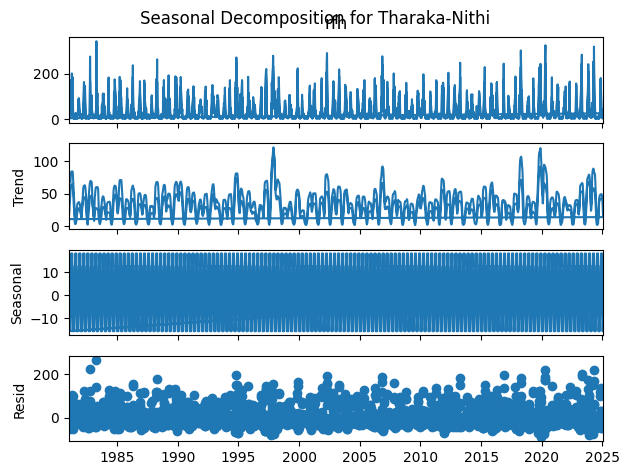

<Figure size 1200x800 with 0 Axes>

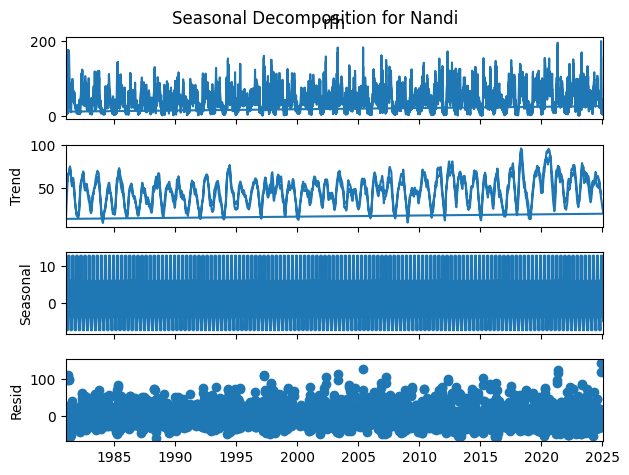

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
counties = df_cleaned["ADM1_EN"].unique()  # Get list of all counties

for county in counties:
    try:
        county_data = df_cleaned[df_cleaned["ADM1_EN"] == county].set_index("date")["rfh"]

        # Ensure there are enough data points for decomposition
        if len(county_data) >= 12:  # At least 12 data points for seasonal decomposition
            decomp = seasonal_decompose(county_data, model="additive", period=12)

            # Plot the decomposition
            plt.figure(figsize=(12, 8))
            decomp.plot()
            plt.suptitle(f"Seasonal Decomposition for {county}")
            plt.show()
        else:
            print(f"Not enough data for decomposition in {county}")

    except Exception as e:
        print(f"Error processing {county}: {e}")


There is a clear seasonal pattern in the graphs, meaning rainfall follows a predictable cycle.

The trend suggests fluctuations in overall rainfall, with increasing peaks in recent years.

Residual variations indicate some level of unpredictability, possibly due to climate variability or extreme weather events.

##**Stationarity**
Stationarity is essential for time series modeling, as many forecasting methods, like ARIMA, assume the data is stationary. If a series shows trends or seasonal patterns, it is non-stationary and may need transformations such as differencing or log scaling to stabilize it. Checking for stationarity can be done using visual inspection or statistical tests like the Augmented Dickey-Fuller (ADF) test.


In [ ]:
from statsmodels.tsa.stattools import adfuller

# Get list of all counties
counties = df_cleaned["ADM1_EN"].unique()

# Dictionary to store results
stationarity_results = {}

# Loop through each county
for county in counties:
    county_data = df_cleaned[df_cleaned["ADM1_EN"] == county].set_index("date")["rfh"]

    # Drop missing values
    county_data = county_data.dropna()

    if len(county_data) > 0:  # Ensure there is enough data for ADF test
        adf_test = adfuller(county_data)
        p_value = adf_test[1]

        # Store result
        stationarity_results[county] = "Stationary ✅" if p_value < 0.05 else "Non-Stationary ❌"

# Print results
for county, result in stationarity_results.items():
    print(f"{county}: {result}")


Kirinyaga: Stationary ✅
Murang'a: Stationary ✅
Baringo: Stationary ✅
Bomet: Stationary ✅
Kajiado: Stationary ✅
Elgeyo-Marakwet: Stationary ✅
Kericho: Stationary ✅
Kiambu: Stationary ✅
Laikipia: Stationary ✅
Bungoma: Stationary ✅
Nakuru: Stationary ✅
Siaya: Stationary ✅
Marsabit: Stationary ✅
Vihiga: Stationary ✅
Busia: Stationary ✅
Kakamega: Stationary ✅
West Pokot: Stationary ✅
Uasin Gishu: Stationary ✅
Turkana: Stationary ✅
Trans Nzoia: Stationary ✅
Narok: Stationary ✅
Samburu: Stationary ✅
Nyandarua: Stationary ✅
Garissa: Stationary ✅
Mandera: Stationary ✅
Wajir: Stationary ✅
Kisii: Stationary ✅
Homa Bay: Stationary ✅
Kisumu: Stationary ✅
Migori: Stationary ✅
Nyamira: Stationary ✅
Nyeri: Stationary ✅
Nairobi: Stationary ✅
Kitui: Stationary ✅
Kilifi: Stationary ✅
Kwale: Stationary ✅
Lamu: Stationary ✅
Mombasa: Stationary ✅
Taita Taveta: Stationary ✅
Tana River: Stationary ✅
Embu: Stationary ✅
Isiolo: Stationary ✅
Machakos: Stationary ✅
Makueni: Stationary ✅
Meru: Stationary ✅
Tharaka

We used Augmented Dickey-Fuller (ADF) test to check for stationarity in our data and the data across all the counties was stationary

##**Autocorelation**

**Autocorrelation** measures the relationship between a time series and its past values (lagged versions of itself). It helps identify patterns, such as trends or seasonality, by showing how past observations influence future ones. A high positive autocorrelation means past values strongly impact future values, while a negative autocorrelation suggests an alternating pattern. Autocorrelation is useful in time series analysis for detecting repeating cycles and making forecasts.

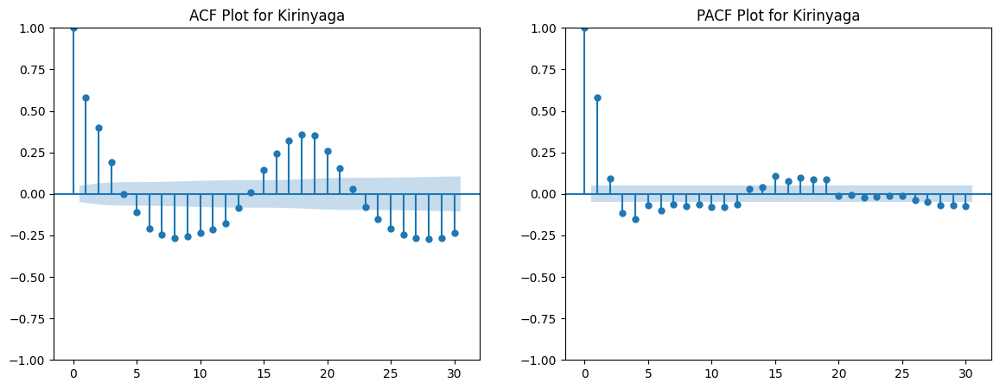

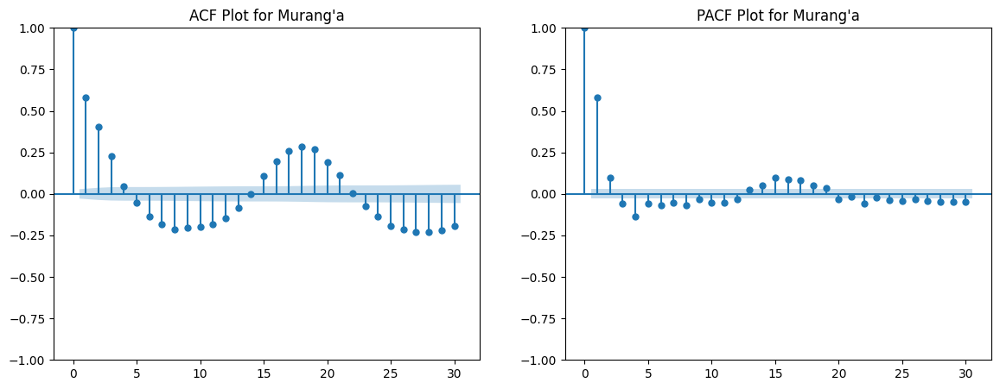

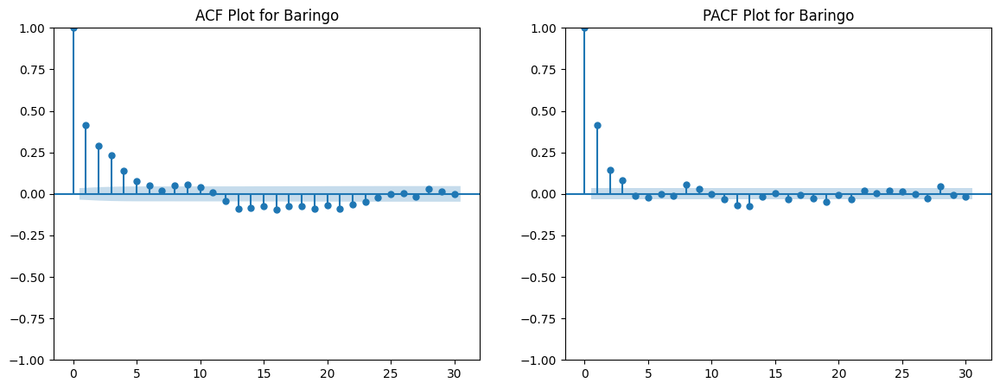

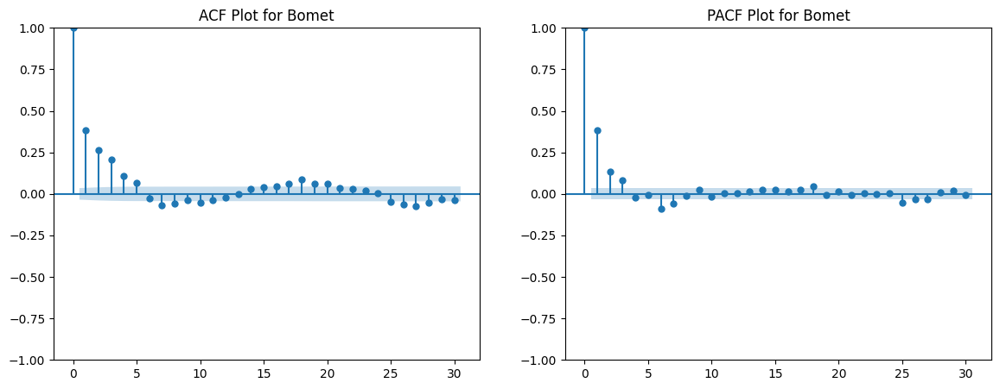

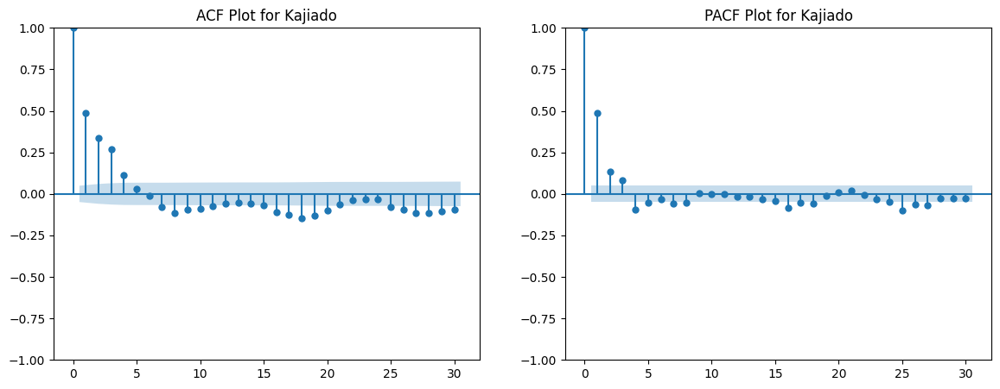

...

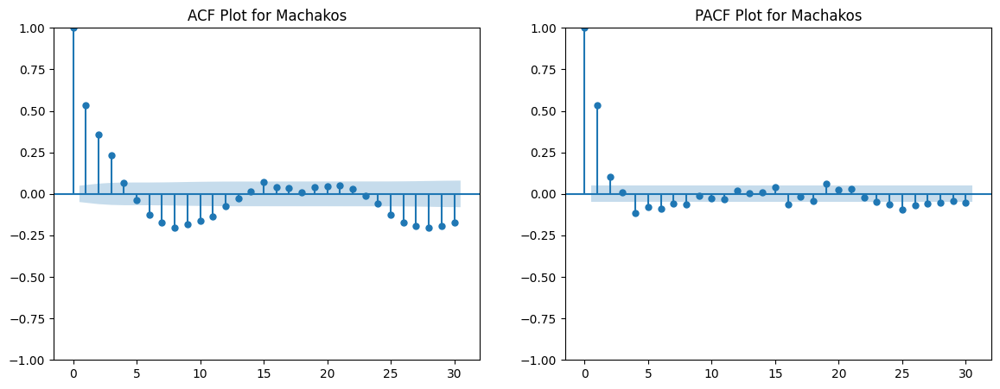

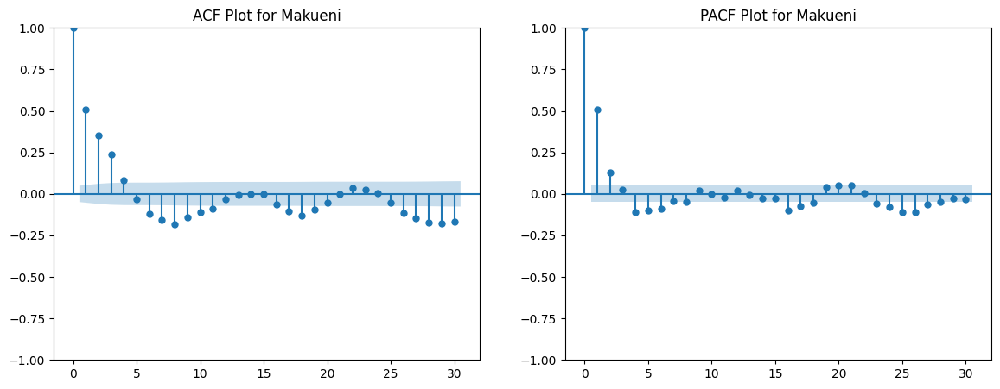

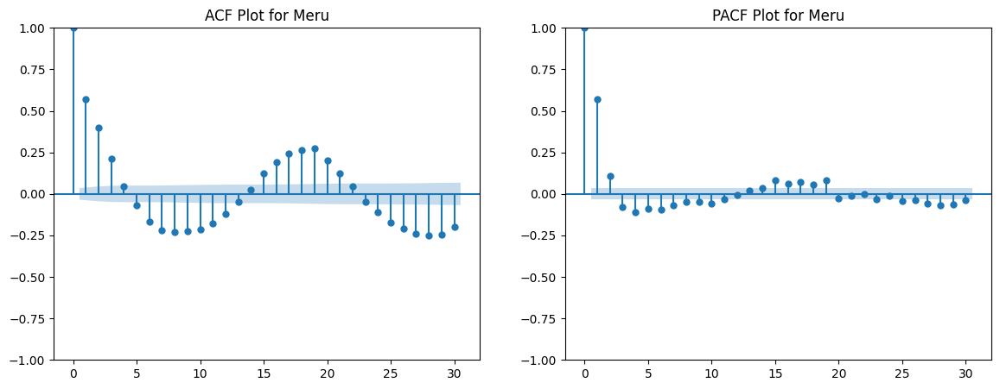

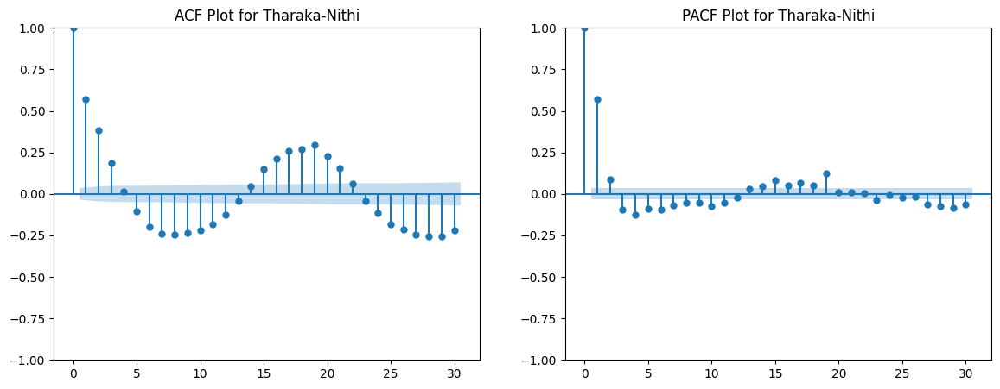

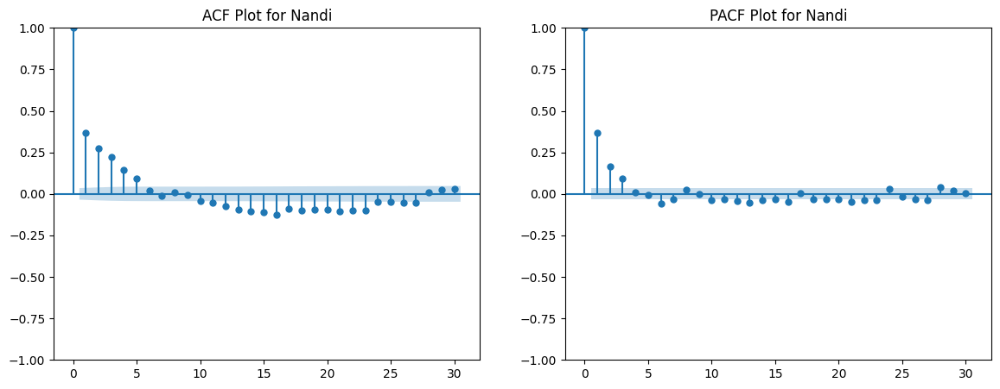

In [ ]:
import statsmodels.api as sm

# Get unique counties
counties = df_cleaned["ADM1_EN"].unique()

# Loop through each county and plot ACF & PACF
for county in counties:
    county_data = df_cleaned[df_cleaned["ADM1_EN"] == county].set_index("date")["rfh"].dropna()

    if len(county_data) > 0:  # Ensure enough data
        fig, axes = plt.subplots(1, 2, figsize=(14, 5))

        # ACF Plot
        sm.graphics.tsa.plot_acf(county_data, lags=30, ax=axes[0])
        axes[0].set_title(f"ACF Plot for {county}")

        # PACF Plot
        sm.graphics.tsa.plot_pacf(county_data, lags=30, ax=axes[1])
        axes[1].set_title(f"PACF Plot for {county}")

        plt.show()


**Observation**

ACF Interpretation:

The slow decay of the ACF plots  indicates a strong seasonal pattern rather than a trend-driven non-stationarity.
Since the ADF test shows that there is stationarity, the persistence of autocorrelation could be due to seasonal effects rather than a unit root.

PACF Interpretation:

The significant spike at lag 1 in the PACF plots suggests an AR(1) process, meaning an autoregressive model of order 1.

## **Handling outliers And Skewness**
Used isolationforest method

In [ ]:
import pandas as pd
from sklearn.ensemble import IsolationForest

# Convert date column to datetime format
df_cleaned["date"] = pd.to_datetime(df_cleaned["date"], errors="coerce")
# Extract year and month
df_cleaned["year"] = df_cleaned["date"].dt.year
df_cleaned["month"] = df_cleaned["date"].dt.month

# Group by month and sum rainfall per county
df_grouped = df_cleaned.groupby(["ADM1_EN", "year", "month"])["rfh"].sum().reset_index()

# Fit Isolation Forest model
model = IsolationForest(n_estimators=100, contamination=0.01, random_state=42)
df_grouped["anomaly"] = model.fit_predict(df_grouped[["rfh"]])

# Visualize anomalies
anomalies = df_grouped[df_grouped["anomaly"] == -1]
print(f"Total anomalies detected: {len(anomalies)}")
print(anomalies.head())


Total anomalies detected: 238
     ADM1_EN  year  month       rfh  anomaly
1897   Busia  2006     11  760.5784       -1
2010   Busia  2016      4  779.4444       -1
2052   Busia  2019     10  814.6765       -1
2065   Busia  2020     11  874.6634       -1
2070   Busia  2021      4  779.9478       -1


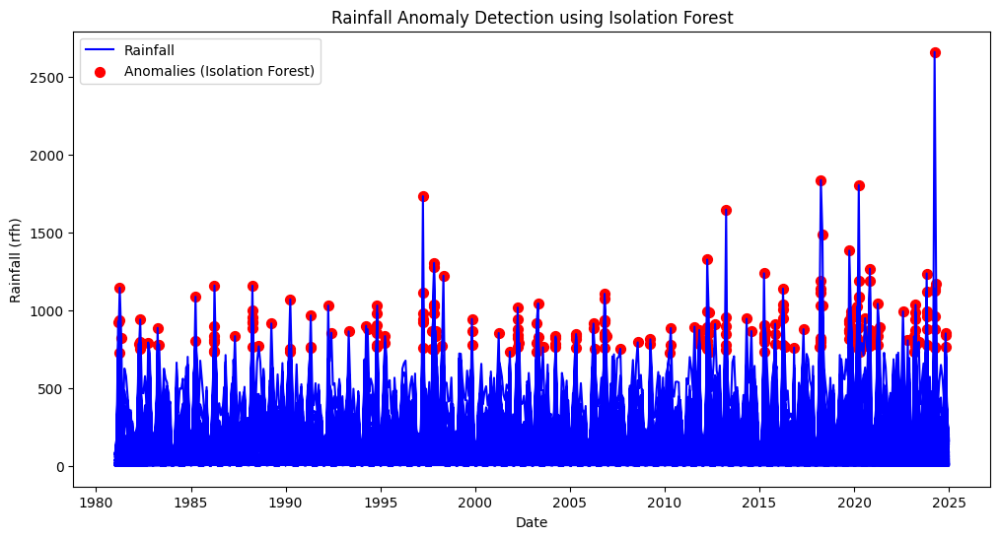

In [ ]:
import matplotlib.pyplot as plt

# Create a date column for plotting (using first day of each month)
df_grouped["date"] = pd.to_datetime(df_grouped[["year", "month"]].assign(day=1))
plt.figure(figsize=(12, 6))

# Plot normal rainfall data
plt.plot(df_grouped["date"], df_grouped["rfh"], label="Rainfall", color="blue")

# Plot detected anomalies
plt.scatter(df_grouped.loc[df_grouped["anomaly"] == -1, "date"],
            df_grouped.loc[df_grouped["anomaly"] == -1, "rfh"],
            color="red", label="Anomalies (Isolation Forest)", marker="o", s=50)

# Labels and title
plt.xlabel("Date")
plt.ylabel("Rainfall (rfh)")
plt.title("Rainfall Anomaly Detection using Isolation Forest")
plt.legend()
plt.show()

In [ ]:
df_grouped["rfh"] = df_grouped["rfh"].where(df_grouped["anomaly"] != -1,
                                            df_grouped["rfh"].rolling(7, min_periods=1).median())

We used this method to handle anomalies in the **`rfh`** column by replacing unusual values with more natural ones. Instead of keeping extreme outliers, we checked if a value was flagged as an anomaly (**`-1`**). If it was normal, we left it unchanged. But if it was an anomaly, we replaced it with the **median of the last 7 values** to smooth out sudden spikes or drops. This helped to keep the data more consistent and realistic while preserving overall trends.

In [ ]:
df_cleaned.columns

Index(['date', 'rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq',
       'r1q', 'r3q', 'ADM2_EN', 'ADM1_EN', 'year', 'month'],
      dtype='object')

In [ ]:
df_cleaned.drop(['ADM2_EN'], axis = 1, inplace = True)

dropped the `ADM2_EN` column since it was unnecessary for our modelling

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Assuming df_cleaned is your cleaned DataFrame
# Feature Engineering
def create_lag_features(df, lags):
    for lag in lags:
        df[f'rfh_lag_{lag}'] = df['rfh'].shift(lag)
    return df.dropna()

df_cleaned = create_lag_features(df_cleaned, [1, 2, 3, 4, 5])

# Normalization
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(df_cleaned[['rfh'] + [f'rfh_lag_{lag}' for lag in [1, 2, 3, 4, 5]]])

# Train-Validation-Test Split
X = scaled_data[:, 1:]  # Features (rfh lagged values)
y = scaled_data[:, 0]   # Target variable (rfh)

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, shuffle=False)  # 70% train, 30% temp
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)  # 15% val, 15% test

# Reshape input to be [samples, time steps, features]
X_train = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_val = X_val.reshape((X_val.shape[0], 1, X_val.shape[1]))
X_test = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

# Model Architecture
model = Sequential()
model.add(Bidirectional(LSTM(50, return_sequences=True), input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(50, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Learning Rate Scheduler
def scheduler(epoch, lr):
    return lr if epoch < 10 else lr * np.exp(-0.1)

lr_scheduler = LearningRateScheduler(scheduler)

# Early Stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_val, y_val),
                    callbacks=[lr_scheduler, early_stopping], verbose=1)

# Evaluate the model on test set
test_loss = model.evaluate(X_test, y_test, verbose=0)
print(f'Test Loss: {test_loss}')

# Make predictions
test_predict = model.predict(X_test)

test_predict = scaler.inverse_transform(np.concatenate((test_predict, X_test.reshape(X_test.shape[0], X_test.shape[2])), axis=1))[:, 0]
y_test = scaler.inverse_transform(np.concatenate((y_test.reshape(-1, 1), X_test.reshape(X_test.shape[0], X_test.shape[2])), axis=1))[:, 0]

# Calculate RMSE and MAE
test_rmse = np.sqrt(mean_squared_error(y_test, test_predict))
test_mae = mean_absolute_error(y_test, test_predict)

print(f'Test RMSE: {test_rmse}')
print(f'Test MAE: {test_mae}')

Epoch 1/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - loss: 0.0035 - val_loss: 0.0037 - learning_rate: 0.0010
Epoch 2/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 17s 5ms/step - loss: 0.0032 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 3/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - loss: 0.0032 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 4/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 14s 6ms/step - loss: 0.0032 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 5/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - loss: 0.0032 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 6/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 14s 6ms/step - loss: 0.0033 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 7/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 14s 5ms/step - loss: 0.0033 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 8/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 15s 6ms/step - loss: 0.0032 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 9/100
2522/2522 ━━━━━━━━━━━━━━━━━━━━ 14s 6ms/step - loss: 0.0032 - val_loss: 0.003

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
# Split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=False)

# Define LSTM model
model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(12, 1)),
    Dropout(0.2),
    LSTM(64, return_sequences=False),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dense(1, activation='linear')
])

# Compile model
model.compile(optimizer='adam', loss='mse')

# Train model
model.fit(X_train, y_train, epochs=30, batch_size=16, validation_split=0.2, verbose=1)

Epoch 1/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 44s 9ms/step - loss: 0.0035 - val_loss: 0.0036
Epoch 2/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 40s 9ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 3/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 39s 8ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 4/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 40s 8ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 5/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 36s 8ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 6/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 41s 8ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 7/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 42s 8ms/step - loss: 0.0033 - val_loss: 0.0034
Epoch 8/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 40s 8ms/step - loss: 0.0033 - val_loss: 0.0035
Epoch 9/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 42s 8ms/step - loss: 0.0032 - val_loss: 0.0034
Epoch 10/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 40s 8ms/step - loss: 0.0033 - val_loss: 0.0035
Epoch 11/30
4611/4611 ━━━━━━━━━━━━━━━━━━━━ 40s 8ms/step - loss: 0.0033 - val_loss: 0.0035
Epoch 12/30
4611/46

In [ ]:
def build_model(hp):
    model = Sequential()

    # LSTM Layers (Tunable units & dropout)
    model.add(LSTM(units=hp.Int('units1', min_value=32, max_value=128, step=16),
                   return_sequences=True, input_shape=(12, 1)))
    model.add(Dropout(hp.Float('dropout1', 0.1, 0.5, step=0.1)))

    model.add(LSTM(units=hp.Int('units2', min_value=32, max_value=128, step=16),
                   return_sequences=False))
    model.add(Dropout(hp.Float('dropout2', 0.1, 0.5, step=0.1)))

    # Dense Layers
    model.add(Dense(units=hp.Int('dense_units', 16, 64, step=16), activation='relu'))
    model.add(Dense(1, activation='linear'))

    # Compile model
    model.compile(
        optimizer=Adam(learning_rate=hp.Float('learning_rate', 1e-4, 1e-2, sampling='log')),
        loss='mse'
    )

    return model


In [ ]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=10,  # Number of different hyperparameter combinations
    executions_per_trial=2,  # Run each combination twice
    directory='tuning_results',
    project_name='rainfall_lstm'
)

# Early stopping to prevent overfitting
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

tuner.search(X_train, y_train, epochs=50, validation_split=0.2, callbacks=[early_stop])

# Get best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print(f"Best Hyperparameters: {best_hps.values}")


In [ ]:
best_model = tuner.hypermodel.build(best_hps)
history = best_model.fit(X_train, y_train, epochs=100, batch_size=16, validation_split=0.2, callbacks=[early_stop])

# Evaluate model
y_pred = best_model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Optimized Model Performance:\nMAE: {mae:.4f}\nMSE: {mse:.4f}\nR2 Score: {r2:.4f}")

In [ ]:
# Inverse transform predictions and true values
y_pred_original = scaler.inverse_transform(y_pred.reshape(-1, 1))
y_test_original = scaler.inverse_transform(y_test.reshape(-1, 1))

# Evaluate model performance on original scale
mae = mean_absolute_error(y_test_original, y_pred_original)
mse = mean_squared_error(y_test_original, y_pred_original)
r2 = r2_score(y_test_original, y_pred_original)

print(f"Optimized Model Performance:\nMAE: {mae:.4f}\nMSE: {mse:.4f}\nR2 Score: {r2:.4f}")


In [ ]:
df_grouped["rolling_mean"] = df_grouped["rfh"].rolling(window=12, min_periods=1).mean()
df_grouped["rolling_std"] = df_grouped["rfh"].rolling(window=12, min_periods=1).std()

# Mark anomalies where rainfall deviates significantly
df_grouped["anomaly_rm"] = (
    (df_grouped["rfh"] > df_grouped["rolling_mean"] + 3 * df_grouped["rolling_std"]) |
    (df_grouped["rfh"] < df_grouped["rolling_mean"] - 3 * df_grouped["rolling_std"])
)

# Display detected anomalies
anomalies_rm = df_grouped[df_grouped["anomaly_rm"]]
print(f"Total anomalies detected by Rolling Mean: {len(anomalies_rm)}")


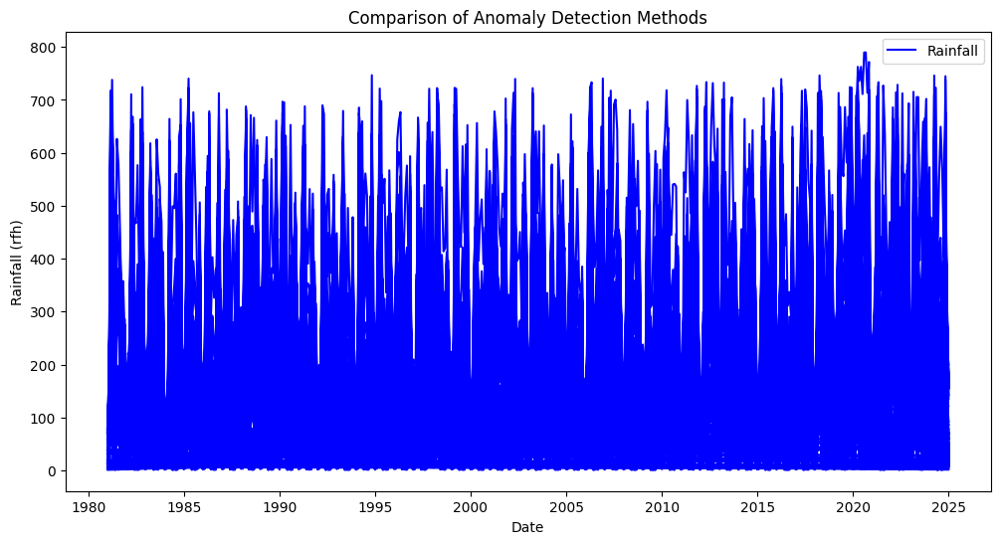

In [ ]:
import pandas as pd

# Create a new date column using the first day of each month
df_grouped["date"] = pd.to_datetime(df_grouped[["year", "month"]].assign(day=1))

# Now, plot the anomalies
import matplotlib.pyplot as plt

plt.figure(figsize=(12,6))
plt.plot(df_grouped["date"], df_grouped["rfh"], label="Rainfall", color="blue")

# If you have anomaly columns, plot them
if "anomaly_rm" in df_grouped.columns:
    plt.scatter(df_grouped.loc[df_grouped["anomaly_rm"], "date"],
                df_grouped.loc[df_grouped["anomaly_rm"], "rfh"],
                color="orange", label="Rolling Mean Anomalies")

if "anomaly_if" in df_grouped.columns:
    plt.scatter(df_grouped.loc[df_grouped["anomaly_if"], "date"],
                df_grouped.loc[df_grouped["anomaly_if"], "rfh"],
                color="red", label="Isolation Forest Anomalies")

plt.legend()
plt.xlabel("Date")
plt.ylabel("Rainfall (rfh)")
plt.title("Comparison of Anomaly Detection Methods")
plt.show()

## MODELLING

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_grouped["scaled_rfh"] = df_grouped.groupby("ADM1_EN")["rfh"].transform(
    lambda x: scaler.fit_transform(x.values.reshape(-1, 1)).flatten()
)

In [ ]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
df_cleaned['ADM1_EN'] = encoder.fit_transform(df_cleaned['ADM1_EN'])

Counties found: ['Kirinyaga' 'Kisii' 'Mombasa' 'Homa Bay' 'Nandi' 'Kakamega'
 'Tharaka-Nithi' 'Elgeyo-Marakwet' 'Wajir' 'Kilifi' 'Bungoma' 'Migori'
 'Trans Nzoia' 'Baringo' 'Kisumu' "Murang'a" 'Nyeri' 'Bomet' 'Turkana'
 'Laikipia' 'Narok' 'Embu' 'Nyandarua' 'Nyamira' 'Marsabit' 'Kitui'
 'West Pokot' 'Busia' 'Uasin Gishu' 'Nairobi' 'Tana River' 'Garissa'
 'Mandera' 'Lamu' 'Kericho' 'Machakos' 'Nakuru' 'Meru' 'Vihiga' 'Samburu'
 'Siaya' 'Kwale' 'Taita Taveta' 'Kiambu' 'Kajiado' 'Isiolo' 'Makueni']

Fitting SARIMA for Kirinyaga...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2013.863
Date:                            Mon, 24 Feb 2025   AIC                          -4017.727
Time:                                    11:24:49   BIC                          -3990.964
Sample:    

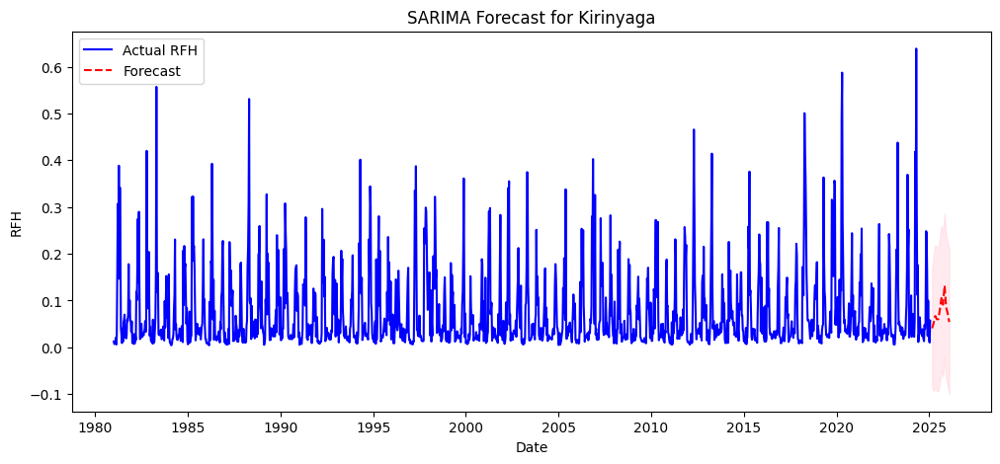


Fitting SARIMA for Kisii...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4744.982
Date:                            Mon, 24 Feb 2025   AIC                          -9479.964
Time:                                    11:25:05   BIC                          -9449.693
Sample:                                         0   HQIC                         -9469.102
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6523      0.011     59.160      0.000       0.631       0.674
ma.L1 

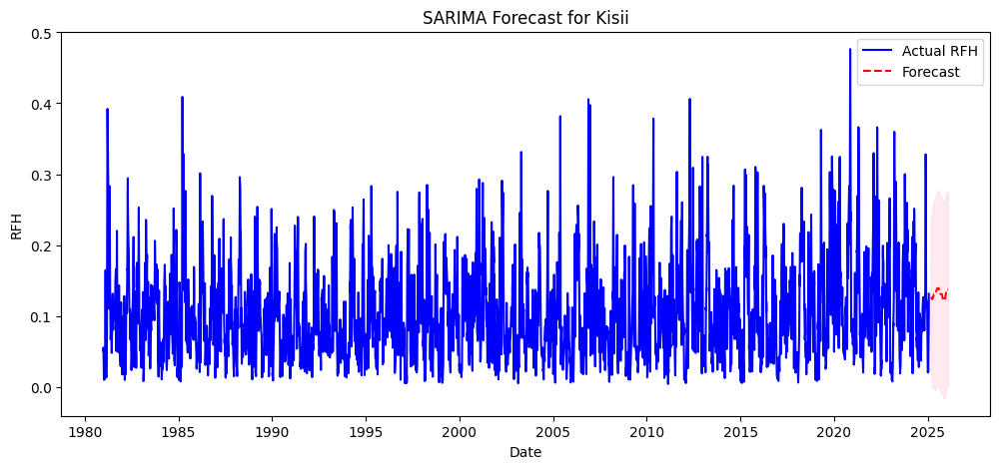


Fitting SARIMA for Mombasa...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                1527.495
Date:                            Mon, 24 Feb 2025   AIC                          -3044.991
Time:                                    11:25:11   BIC                          -3018.229
Sample:                                         0   HQIC                         -3035.040
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3979      0.016     25.280      0.000       0.367       0.429
ma.L

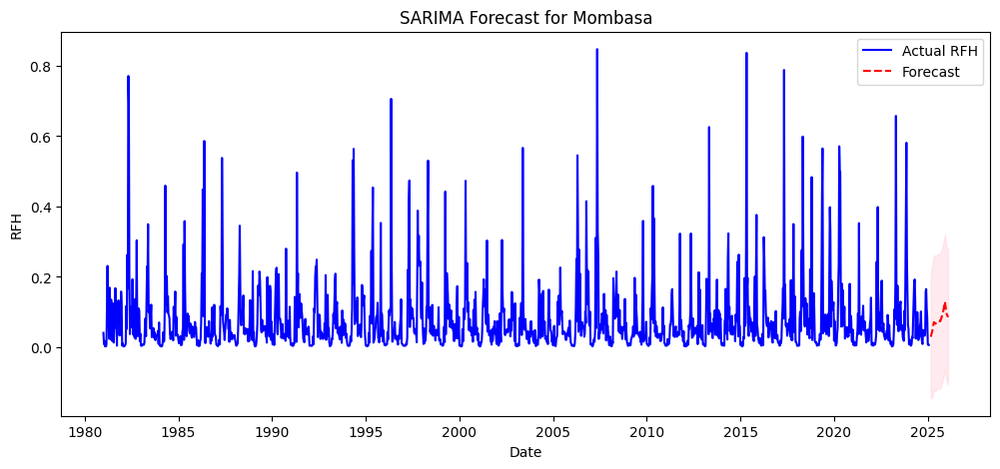


Fitting SARIMA for Homa Bay...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 4761
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                8512.680
Date:                            Mon, 24 Feb 2025   AIC                         -17015.360
Time:                                    11:25:49   BIC                         -16983.047
Sample:                                         0   HQIC                        -17004.003
                                           - 4761                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7511      0.008     95.897      0.000       0.736       0.766
ma.

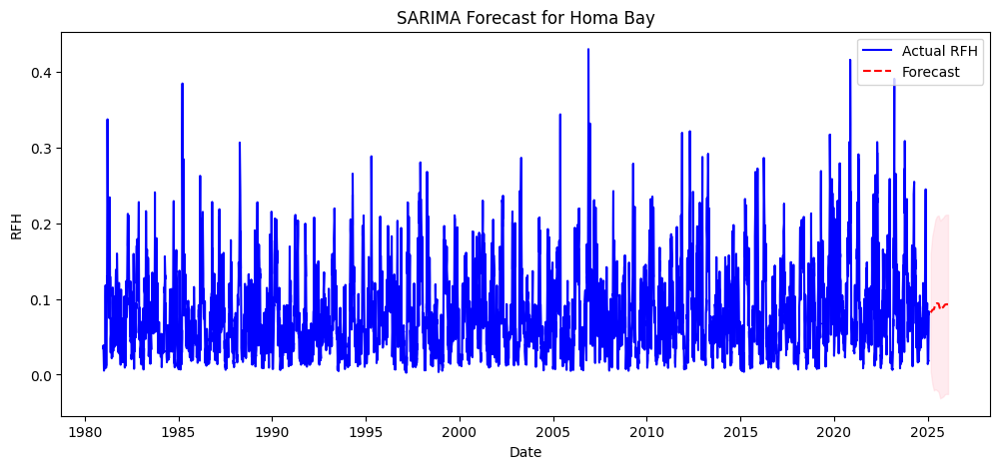


Fitting SARIMA for Nandi...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4760.135
Date:                            Mon, 24 Feb 2025   AIC                          -9510.270
Time:                                    11:26:02   BIC                          -9479.999
Sample:                                         0   HQIC                         -9499.408
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6479      0.012     55.335      0.000       0.625       0.671
ma.L1 

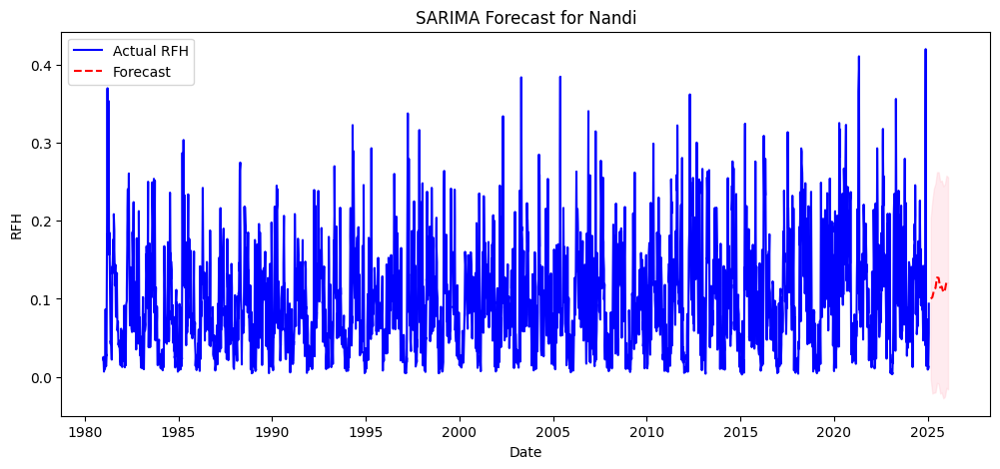


Fitting SARIMA for Kakamega...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 4761
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                6745.380
Date:                            Mon, 24 Feb 2025   AIC                         -13480.760
Time:                                    11:26:17   BIC                         -13448.447
Sample:                                         0   HQIC                        -13469.403
                                           - 4761                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5218      0.016     33.327      0.000       0.491       0.552
ma.

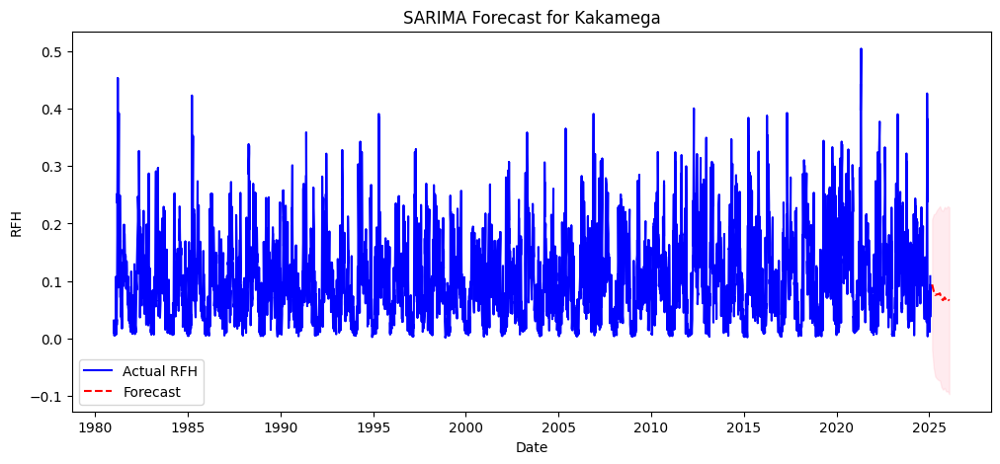


Fitting SARIMA for Tharaka-Nithi...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3925.603
Date:                            Mon, 24 Feb 2025   AIC                          -7841.207
Time:                                    11:26:33   BIC                          -7810.936
Sample:                                         0   HQIC                         -7830.345
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7264      0.007    102.540      0.000       0.713       0.74

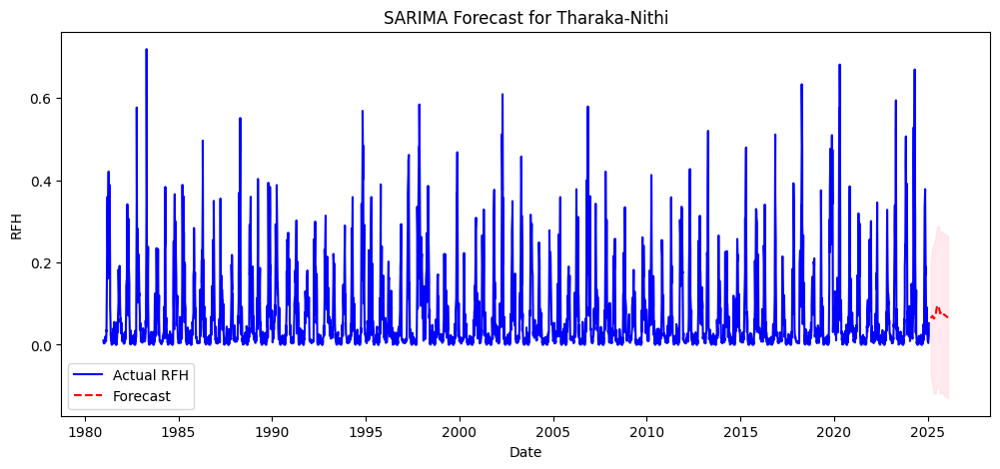


Fitting SARIMA for Elgeyo-Marakwet...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4788.734
Date:                            Mon, 24 Feb 2025   AIC                          -9567.468
Time:                                    11:26:56   BIC                          -9537.197
Sample:                                         0   HQIC                         -9556.606
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6505      0.010     68.320      0.000       0.632       0.

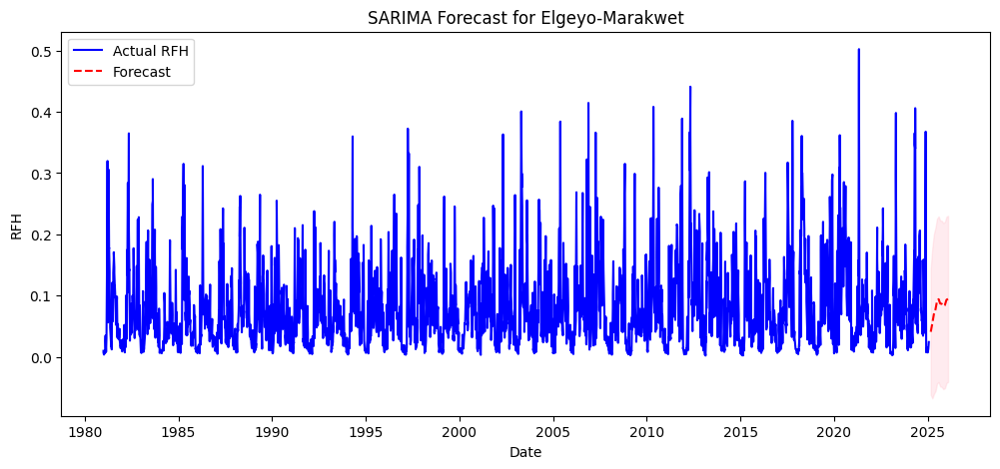


Fitting SARIMA for Wajir...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3145.255
Date:                            Mon, 24 Feb 2025   AIC                          -6280.509
Time:                                    11:27:03   BIC                          -6253.747
Sample:                                         0   HQIC                         -6270.559
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5617      0.010     56.198      0.000       0.542       0.581
ma.L1 

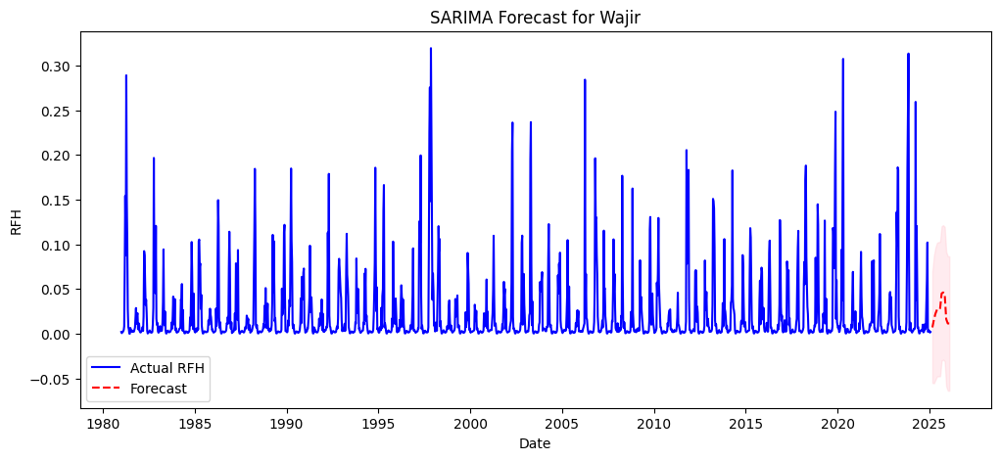


Fitting SARIMA for Kilifi...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4940.995
Date:                            Mon, 24 Feb 2025   AIC                          -9871.990
Time:                                    11:27:16   BIC                          -9841.719
Sample:                                         0   HQIC                         -9861.128
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6270      0.006     97.230      0.000       0.614       0.640
ma.L1

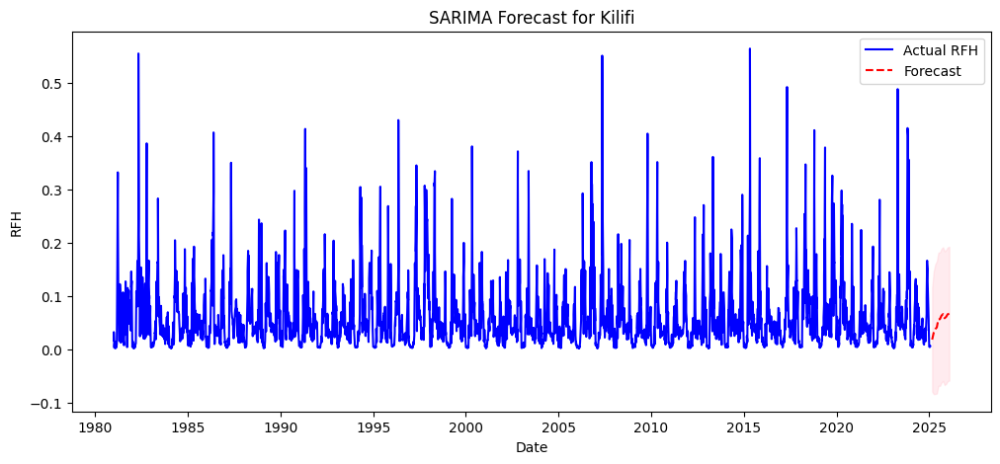


Fitting SARIMA for Bungoma...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4882.809
Date:                            Mon, 24 Feb 2025   AIC                          -9755.619
Time:                                    11:27:38   BIC                          -9725.348
Sample:                                         0   HQIC                         -9744.757
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6815      0.012     56.240      0.000       0.658       0.705
ma.L

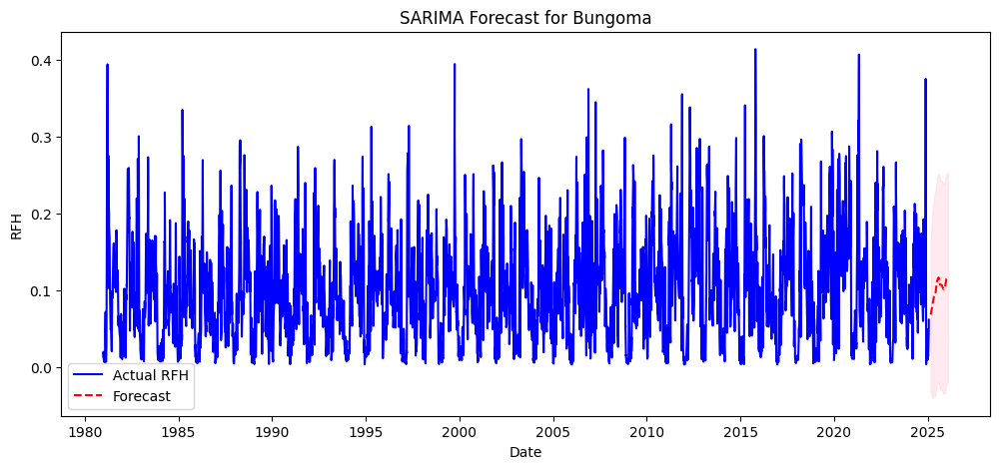


Fitting SARIMA for Migori...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5275.116
Date:                            Mon, 24 Feb 2025   AIC                         -10540.232
Time:                                    11:27:47   BIC                         -10509.961
Sample:                                         0   HQIC                        -10529.370
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6677      0.010     63.995      0.000       0.647       0.688
ma.L1

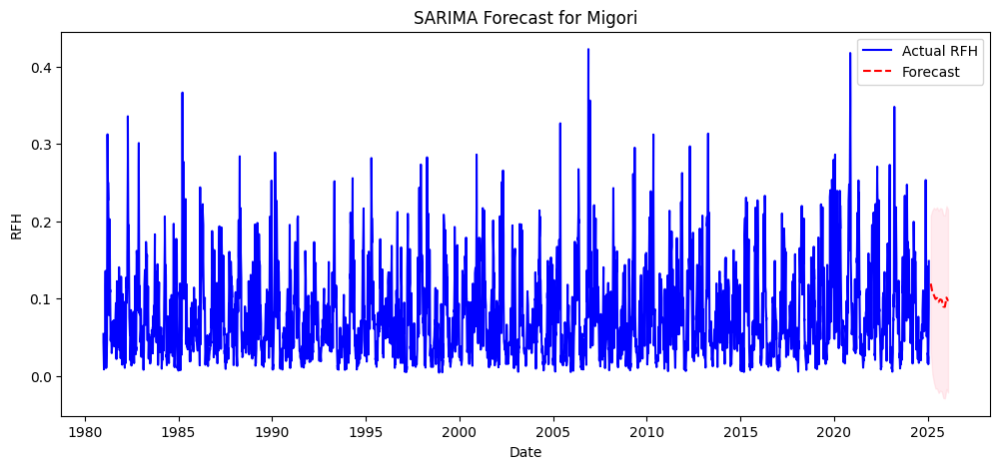


Fitting SARIMA for Trans Nzoia...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2313.727
Date:                            Mon, 24 Feb 2025   AIC                          -4617.454
Time:                                    11:27:53   BIC                          -4590.692
Sample:                                         0   HQIC                         -4607.504
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1879      0.034      5.490      0.000       0.121       0.255


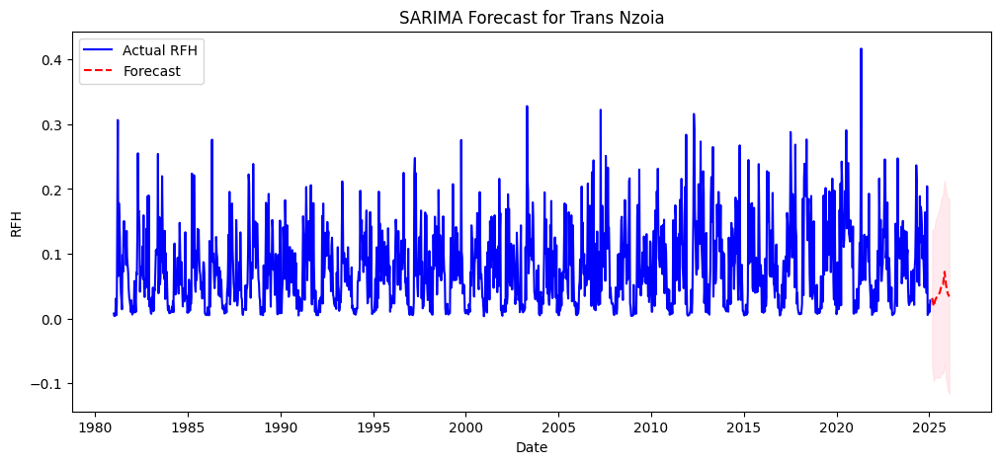


Fitting SARIMA for Baringo...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5444.019
Date:                            Mon, 24 Feb 2025   AIC                         -10878.039
Time:                                    11:28:12   BIC                         -10847.768
Sample:                                         0   HQIC                        -10867.177
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6243      0.010     64.069      0.000       0.605       0.643
ma.L

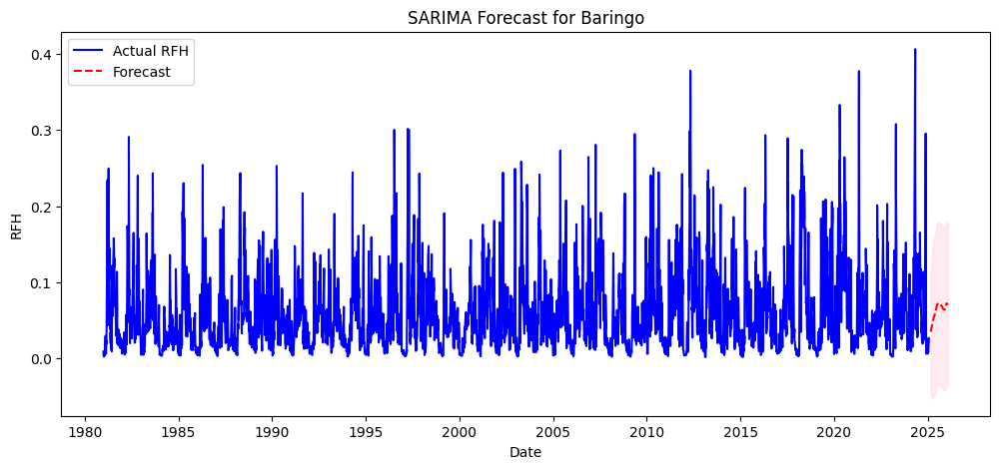


Fitting SARIMA for Kisumu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5030.240
Date:                            Mon, 24 Feb 2025   AIC                         -10050.480
Time:                                    11:28:23   BIC                         -10020.209
Sample:                                         0   HQIC                        -10039.618
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6293      0.011     57.775      0.000       0.608       0.651
ma.L1

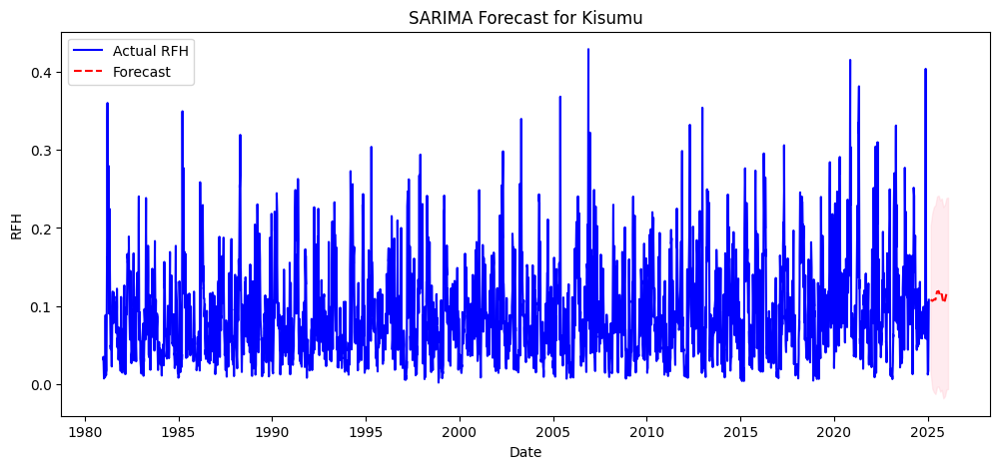


Fitting SARIMA for Murang'a...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 4761
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                7101.888
Date:                            Mon, 24 Feb 2025   AIC                         -14193.776
Time:                                    11:28:44   BIC                         -14161.463
Sample:                                         0   HQIC                        -14182.419
                                           - 4761                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5572      0.031    -18.173      0.000      -0.617      -0.497
ma.

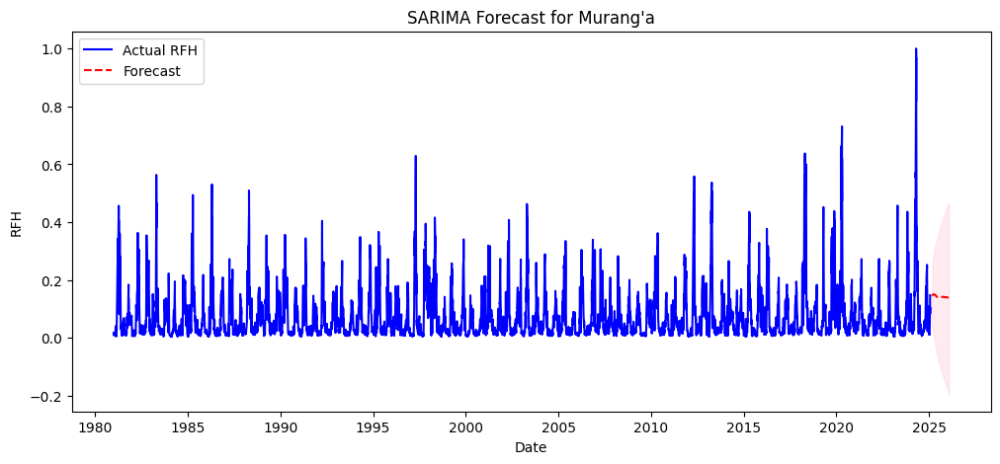


Fitting SARIMA for Nyeri...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2319.346
Date:                            Mon, 24 Feb 2025   AIC                          -4628.692
Time:                                    11:28:55   BIC                          -4601.930
Sample:                                         0   HQIC                         -4618.742
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5500      0.014     38.944      0.000       0.522       0.578
ma.L1 

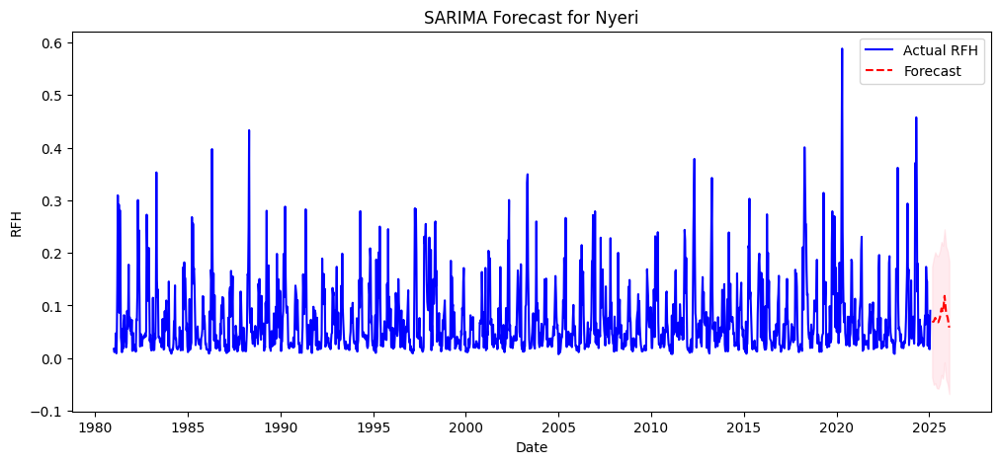


Fitting SARIMA for Bomet...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4723.088
Date:                            Mon, 24 Feb 2025   AIC                          -9436.175
Time:                                    11:29:16   BIC                          -9405.904
Sample:                                         0   HQIC                         -9425.313
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5713      0.011     54.329      0.000       0.551       0.592
ma.L1 

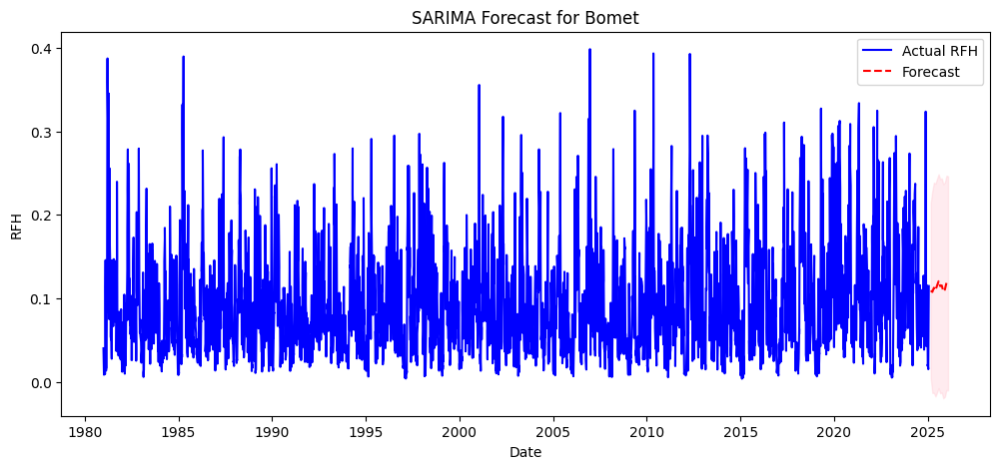


Fitting SARIMA for Turkana...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4013.839
Date:                            Mon, 24 Feb 2025   AIC                          -8017.678
Time:                                    11:29:24   BIC                          -7990.916
Sample:                                         0   HQIC                         -8007.728
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1750      0.022      7.838      0.000       0.131       0.219
ma.L

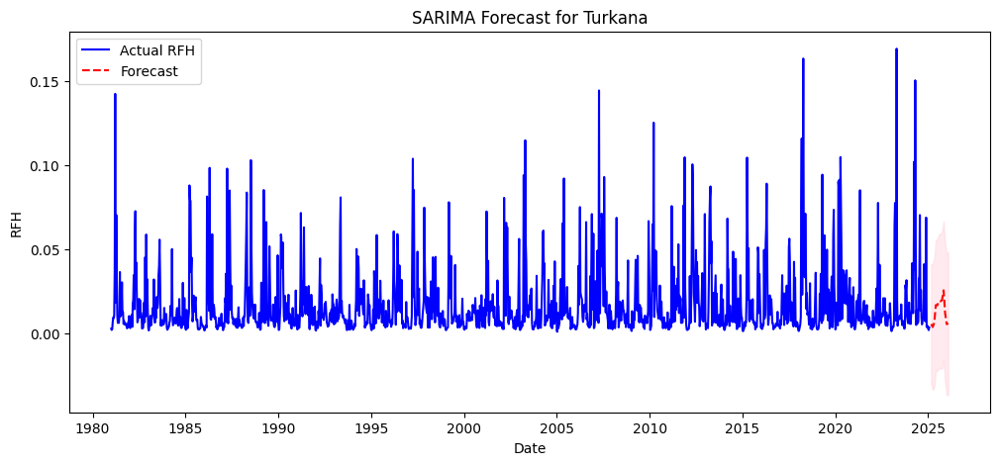


Fitting SARIMA for Laikipia...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3046.272
Date:                            Mon, 24 Feb 2025   AIC                          -6082.543
Time:                                    11:29:32   BIC                          -6055.781
Sample:                                         0   HQIC                         -6072.593
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3814      0.018     20.798      0.000       0.345       0.417
ma.

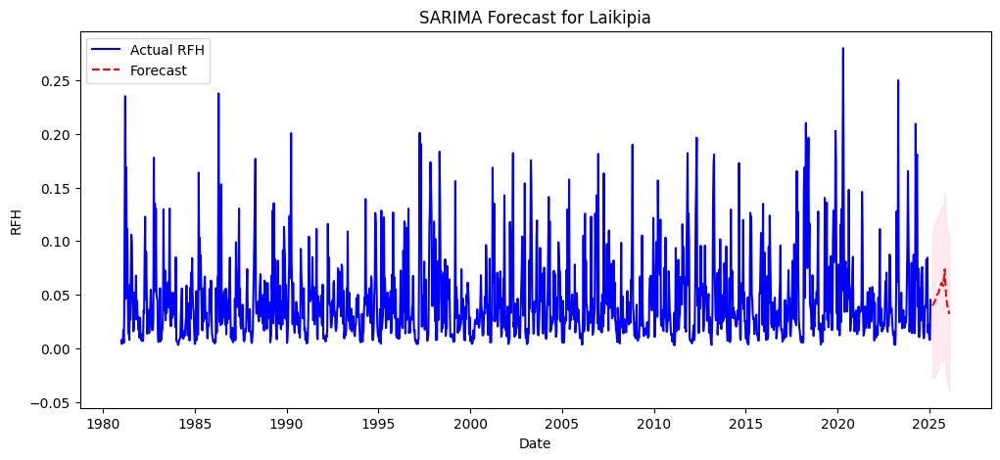


Fitting SARIMA for Narok...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5175.757
Date:                            Mon, 24 Feb 2025   AIC                         -10341.514
Time:                                    11:29:45   BIC                         -10311.243
Sample:                                         0   HQIC                        -10330.652
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5384      0.012     44.951      0.000       0.515       0.562
ma.L1 

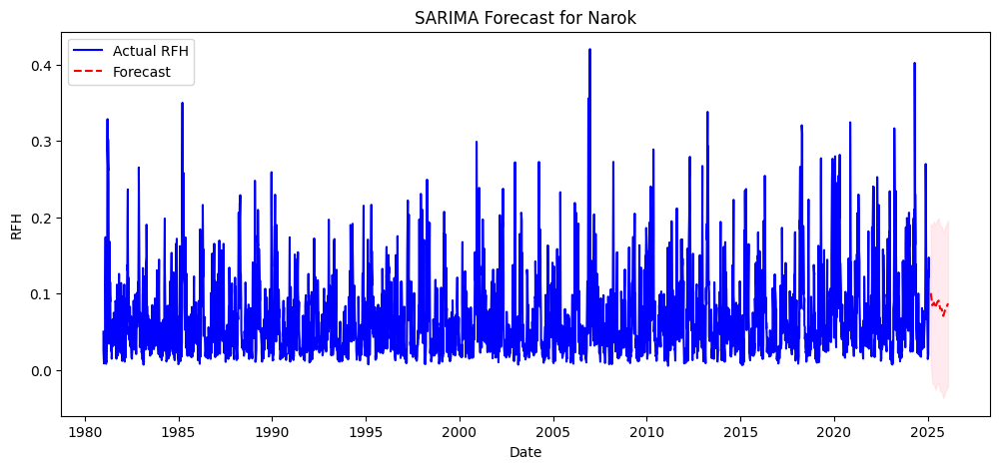


Fitting SARIMA for Embu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4048.136
Date:                            Mon, 24 Feb 2025   AIC                          -8086.271
Time:                                    11:30:00   BIC                          -8056.000
Sample:                                         0   HQIC                         -8075.409
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6902      0.007     97.413      0.000       0.676       0.704
ma.L1  

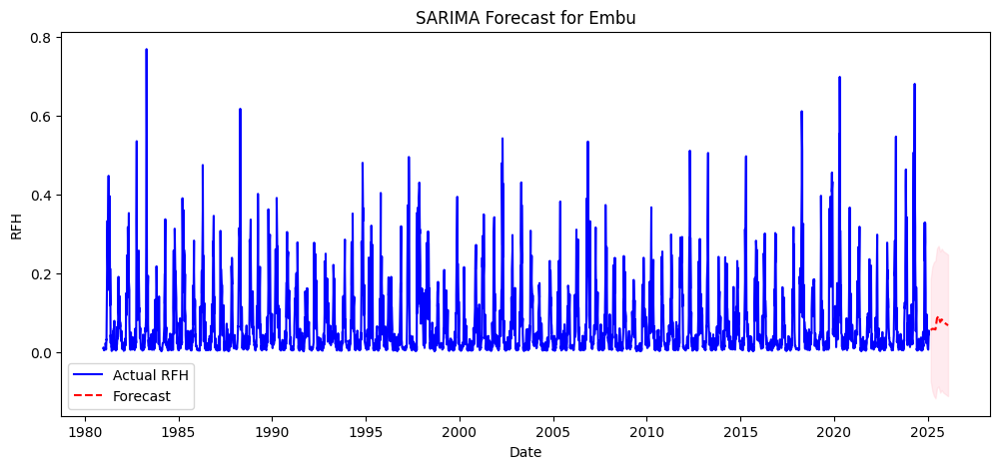


Fitting SARIMA for Nyandarua...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2515.495
Date:                            Mon, 24 Feb 2025   AIC                          -5020.989
Time:                                    11:30:07   BIC                          -4994.227
Sample:                                         0   HQIC                         -5011.039
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4494      0.016     28.019      0.000       0.418       0.481
ma

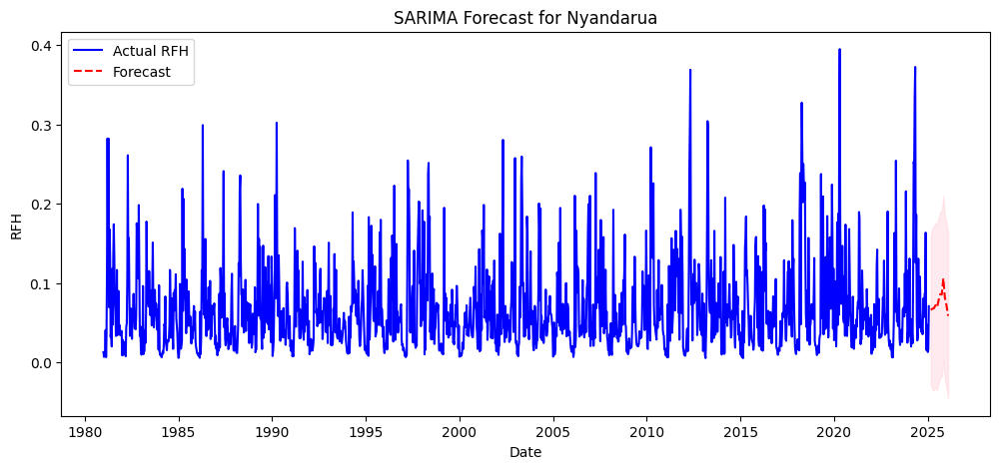


Fitting SARIMA for Nyamira...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2054.570
Date:                            Mon, 24 Feb 2025   AIC                          -4099.140
Time:                                    11:30:14   BIC                          -4072.378
Sample:                                         0   HQIC                         -4089.190
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3146      0.023     13.579      0.000       0.269       0.360
ma.L

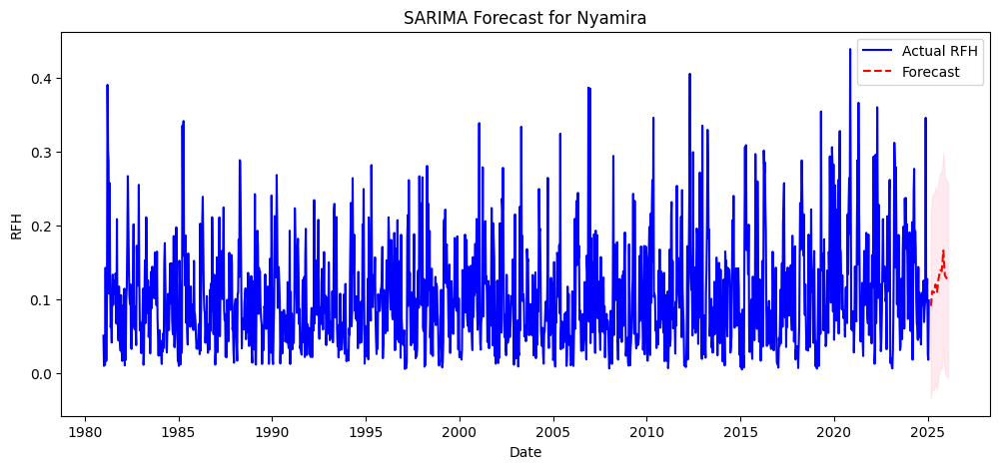


Fitting SARIMA for Marsabit...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 4761
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                9790.956
Date:                            Mon, 24 Feb 2025   AIC                         -19571.911
Time:                                    11:30:36   BIC                         -19539.598
Sample:                                         0   HQIC                        -19560.555
                                           - 4761                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2278      0.012     18.278      0.000       0.203       0.252
ma.

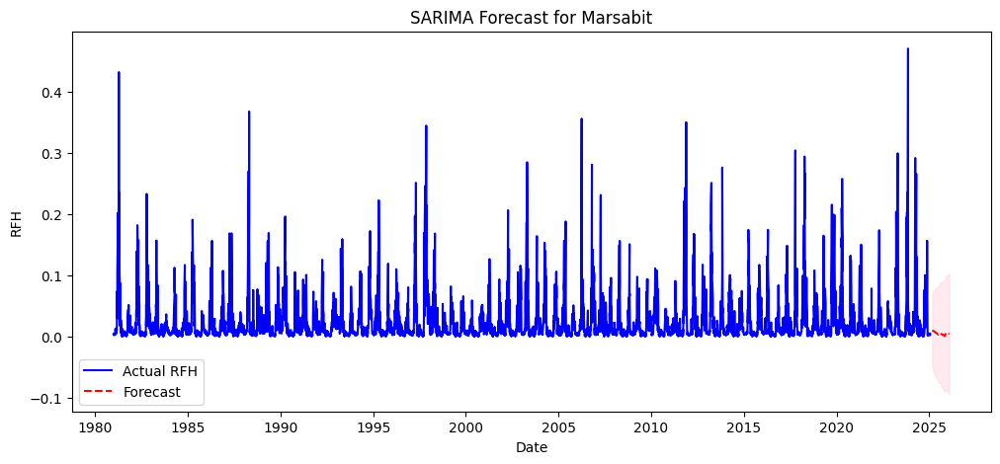


Fitting SARIMA for Kitui...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5231.675
Date:                            Mon, 24 Feb 2025   AIC                         -10453.350
Time:                                    11:30:47   BIC                         -10423.079
Sample:                                         0   HQIC                        -10442.488
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7075      0.006    115.375      0.000       0.695       0.719
ma.L1 

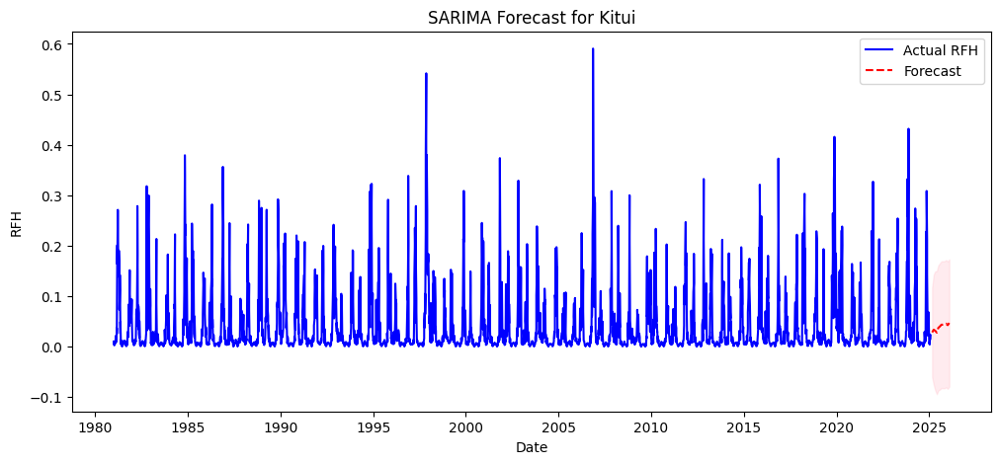


Fitting SARIMA for West Pokot...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2668.620
Date:                            Mon, 24 Feb 2025   AIC                          -5327.240
Time:                                    11:30:57   BIC                          -5300.478
Sample:                                         0   HQIC                         -5317.290
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3635      0.019     19.097      0.000       0.326       0.401
m

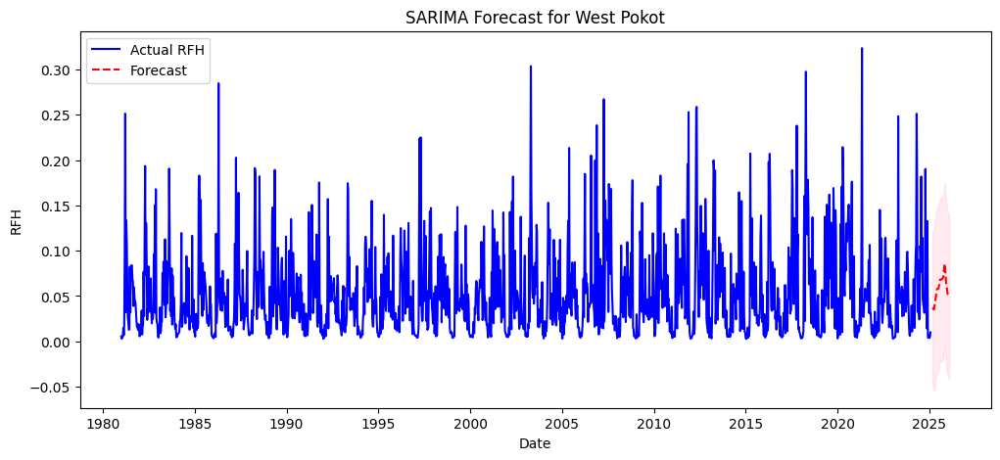


Fitting SARIMA for Busia...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4901.008
Date:                            Mon, 24 Feb 2025   AIC                          -9792.016
Time:                                    11:31:13   BIC                          -9761.745
Sample:                                         0   HQIC                         -9781.154
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6920      0.011     61.318      0.000       0.670       0.714
ma.L1 

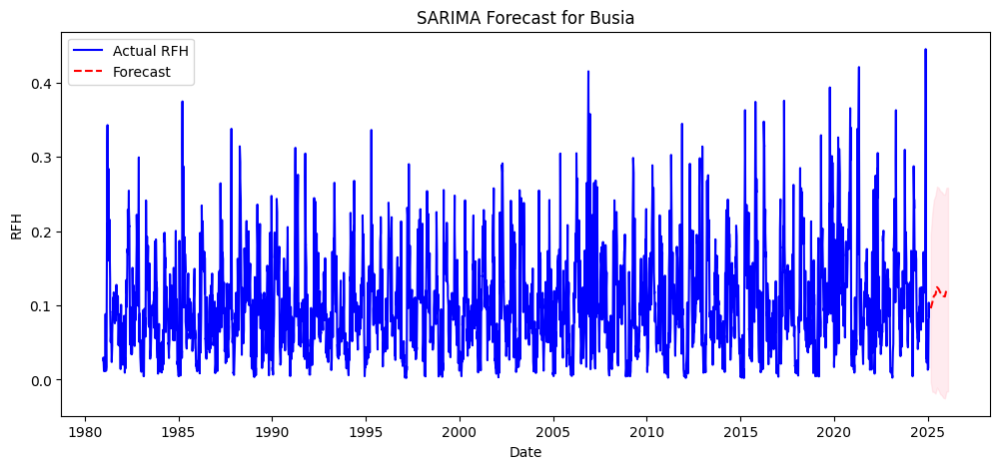


Fitting SARIMA for Uasin Gishu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2301.550
Date:                            Mon, 24 Feb 2025   AIC                          -4593.100
Time:                                    11:31:20   BIC                          -4566.338
Sample:                                         0   HQIC                         -4583.150
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1714      0.030      5.723      0.000       0.113       0.230


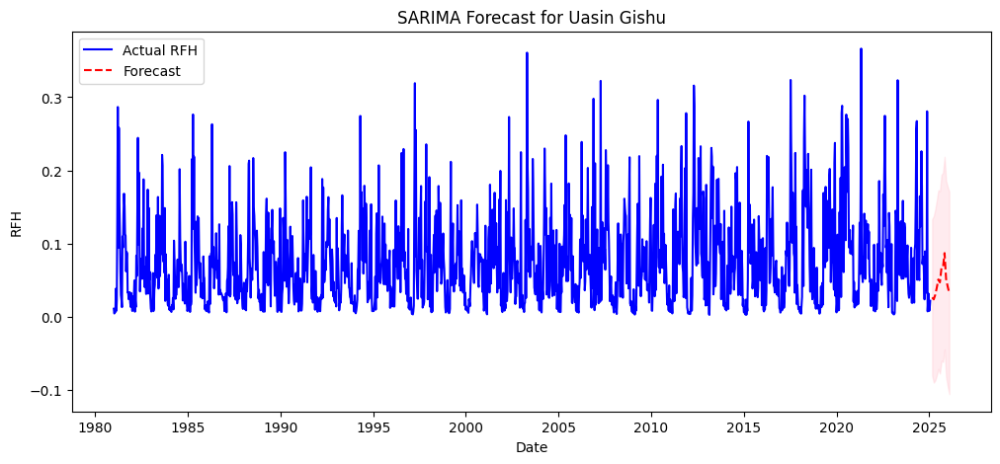


Fitting SARIMA for Nairobi...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2278.243
Date:                            Mon, 24 Feb 2025   AIC                          -4546.486
Time:                                    11:31:32   BIC                          -4519.723
Sample:                                         0   HQIC                         -4536.535
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4614      0.015     30.896      0.000       0.432       0.491
ma.L

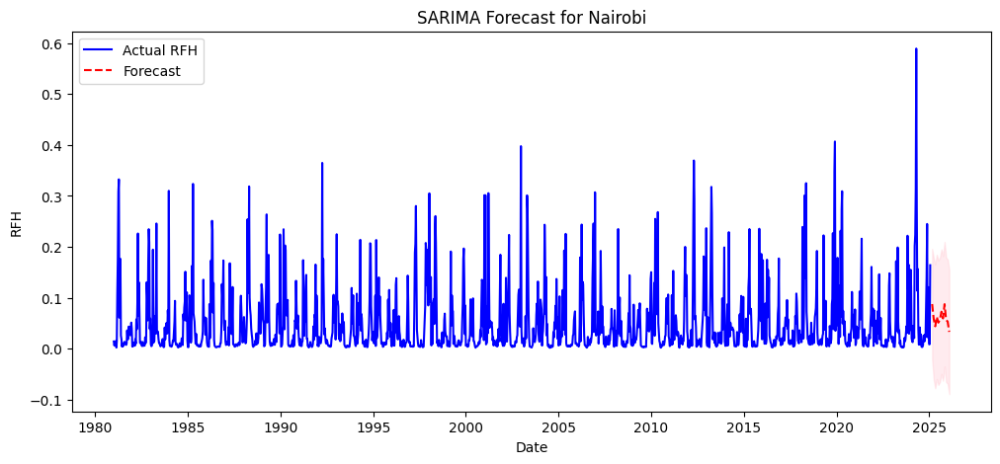


Fitting SARIMA for Tana River...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3248.852
Date:                            Mon, 24 Feb 2025   AIC                          -6487.705
Time:                                    11:31:41   BIC                          -6460.942
Sample:                                         0   HQIC                         -6477.754
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4912      0.013     37.720      0.000       0.466       0.517
m

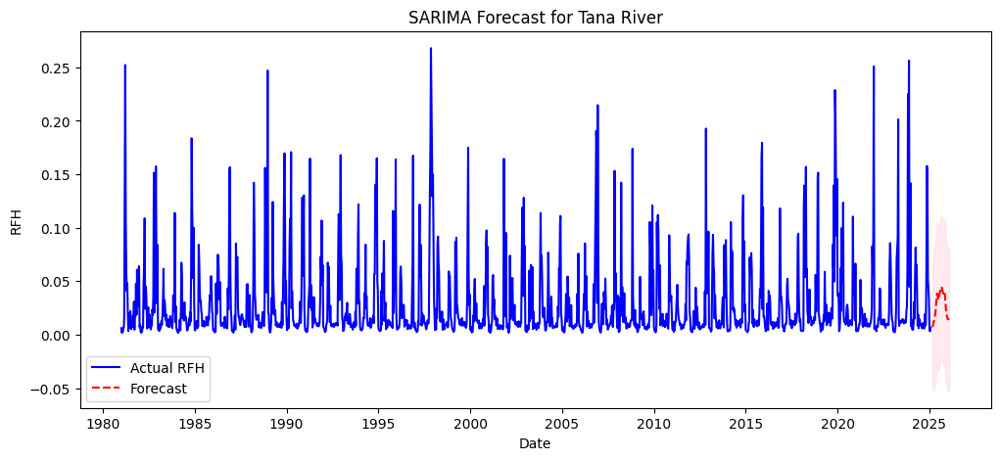


Fitting SARIMA for Garissa...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                5221.817
Date:                            Mon, 24 Feb 2025   AIC                         -10433.633
Time:                                    11:31:50   BIC                         -10403.362
Sample:                                         0   HQIC                        -10422.771
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0649      0.017      3.737      0.000       0.031       0.099
ma.L

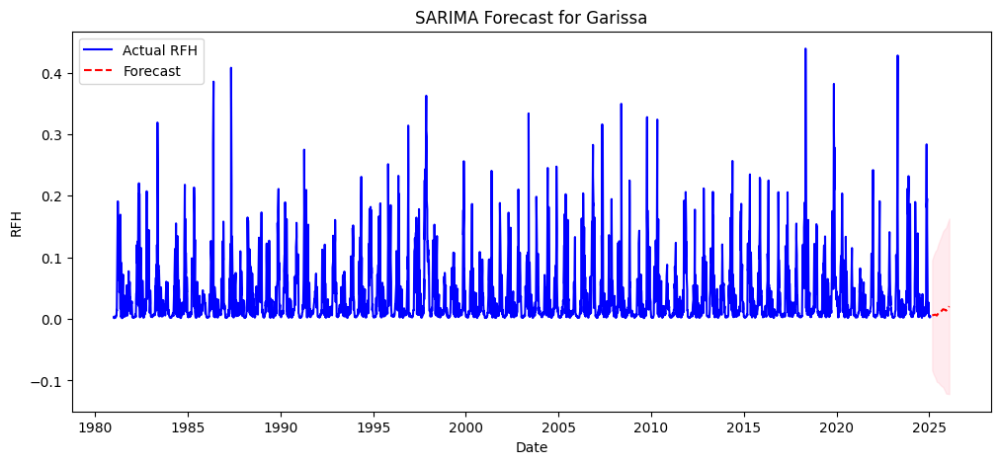


Fitting SARIMA for Mandera...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3207.898
Date:                            Mon, 24 Feb 2025   AIC                          -6405.796
Time:                                    11:31:59   BIC                          -6379.033
Sample:                                         0   HQIC                         -6395.845
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5370      0.010     53.328      0.000       0.517       0.557
ma.L

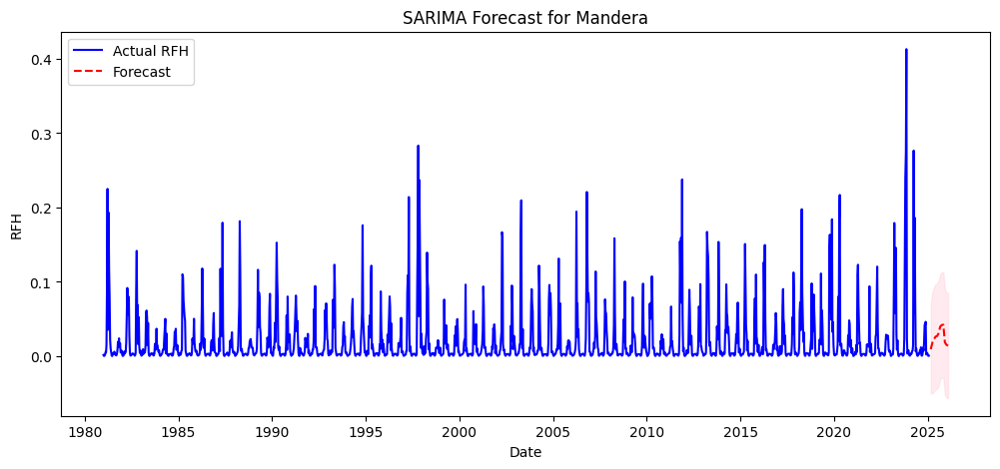


Fitting SARIMA for Lamu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2046.414
Date:                            Mon, 24 Feb 2025   AIC                          -4082.828
Time:                                    11:32:07   BIC                          -4056.066
Sample:                                         0   HQIC                         -4072.877
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4611      0.012     39.999      0.000       0.438       0.484
ma.L1  

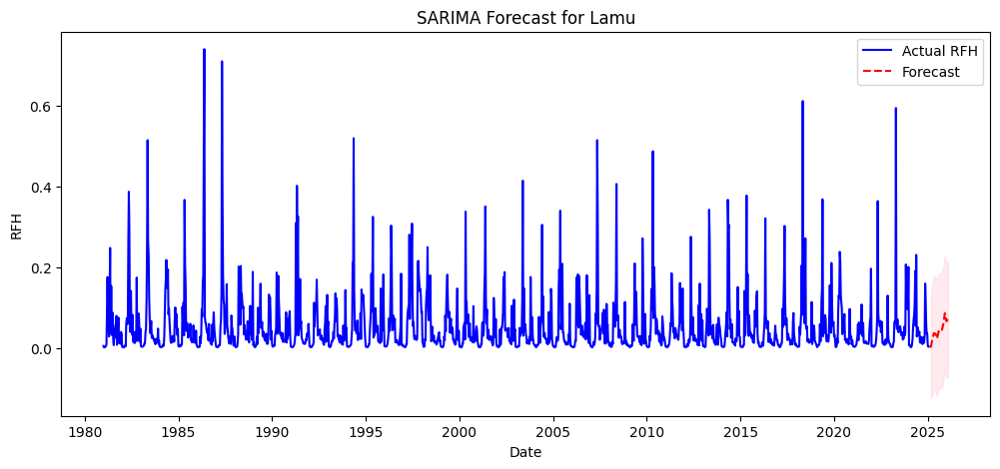


Fitting SARIMA for Kericho...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2215.516
Date:                            Mon, 24 Feb 2025   AIC                          -4421.032
Time:                                    11:32:15   BIC                          -4394.270
Sample:                                         0   HQIC                         -4411.082
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3325      0.022     15.159      0.000       0.290       0.376
ma.L

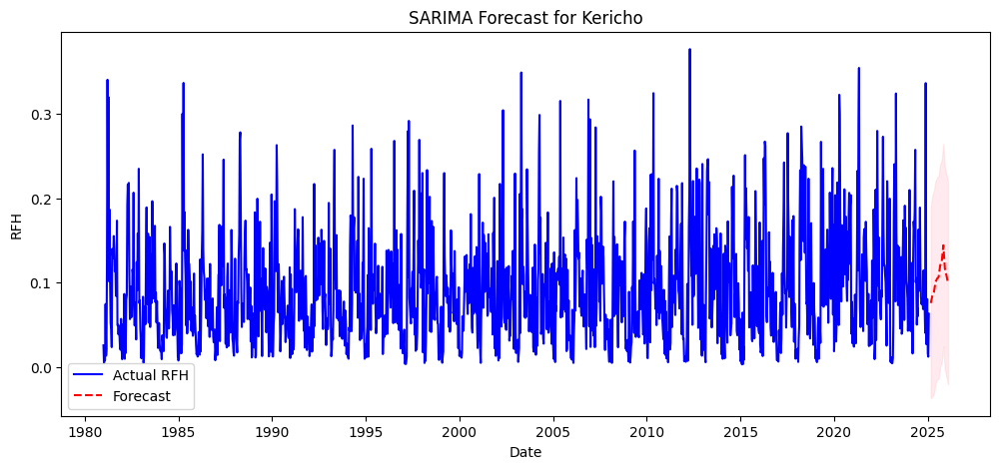


Fitting SARIMA for Machakos...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2332.455
Date:                            Mon, 24 Feb 2025   AIC                          -4654.910
Time:                                    11:32:24   BIC                          -4628.147
Sample:                                         0   HQIC                         -4644.959
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5019      0.015     32.503      0.000       0.472       0.532
ma.

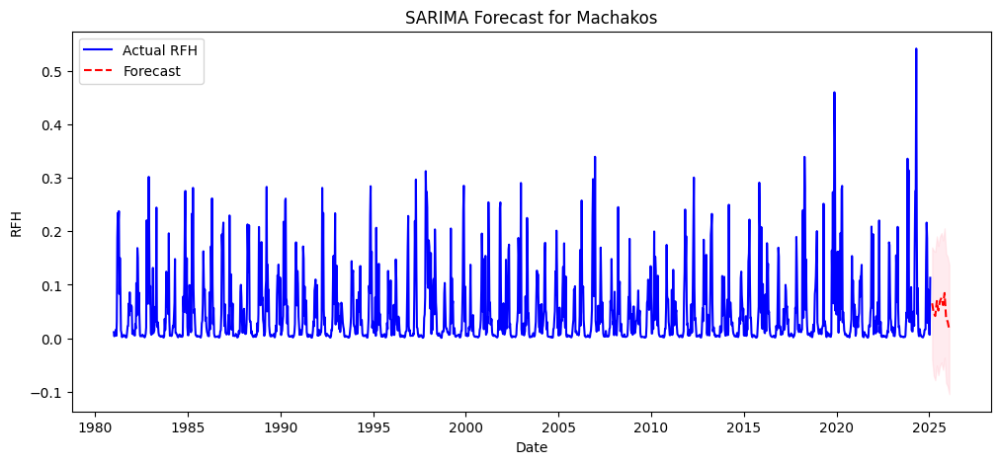


Fitting SARIMA for Nakuru...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2729.921
Date:                            Mon, 24 Feb 2025   AIC                          -5449.842
Time:                                    11:32:31   BIC                          -5423.080
Sample:                                         0   HQIC                         -5439.892
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4148      0.017     23.793      0.000       0.381       0.449
ma.L1

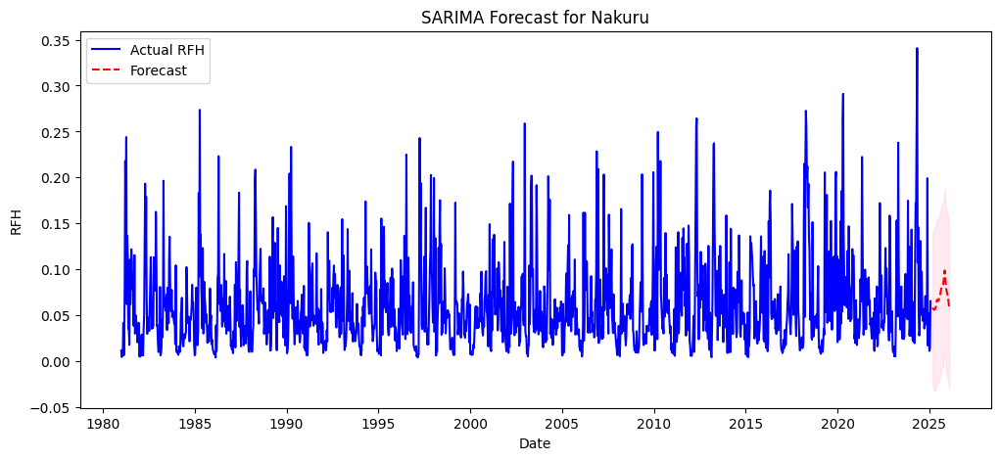


Fitting SARIMA for Meru...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 3174
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                4276.156
Date:                            Mon, 24 Feb 2025   AIC                          -8542.313
Time:                                    11:32:49   BIC                          -8512.042
Sample:                                         0   HQIC                         -8531.451
                                           - 3174                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7345      0.008     97.705      0.000       0.720       0.749
ma.L1  

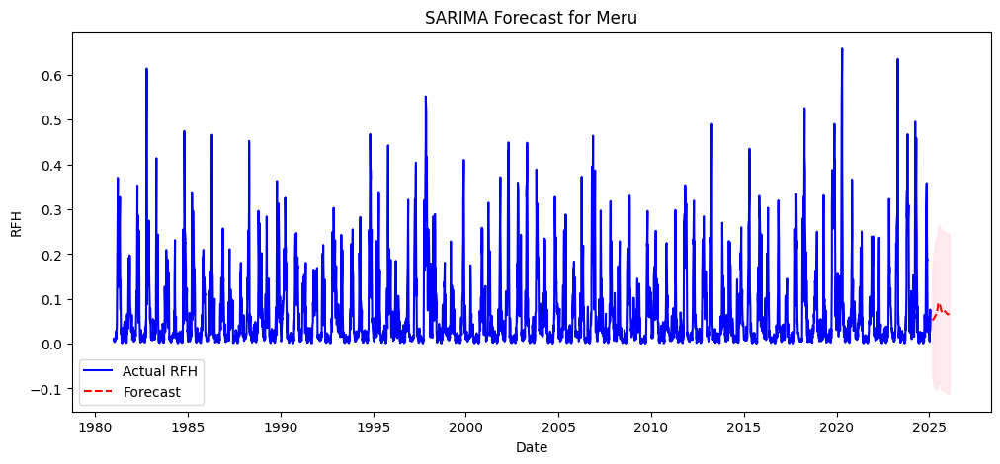


Fitting SARIMA for Vihiga...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                1903.367
Date:                            Mon, 24 Feb 2025   AIC                          -3796.735
Time:                                    11:32:55   BIC                          -3769.972
Sample:                                         0   HQIC                         -3786.784
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3506      0.022     15.773      0.000       0.307       0.394
ma.L1

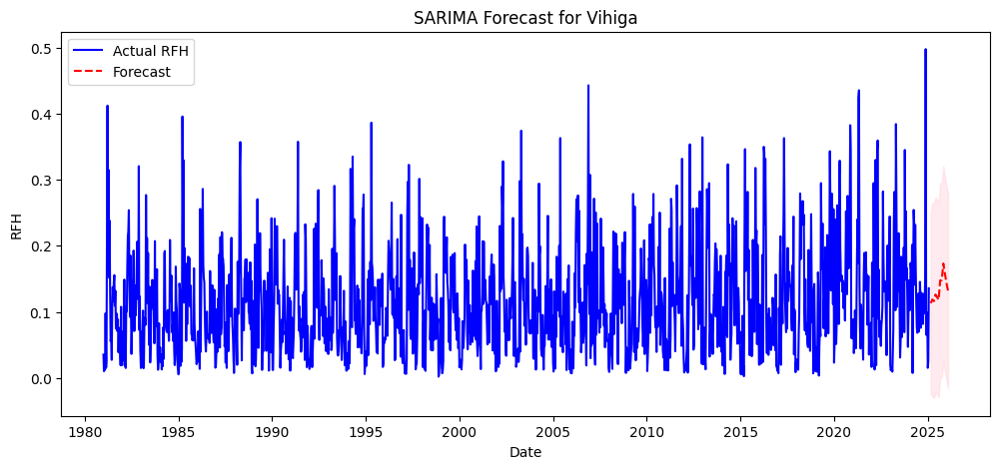


Fitting SARIMA for Samburu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3193.425
Date:                            Mon, 24 Feb 2025   AIC                          -6376.850
Time:                                    11:33:02   BIC                          -6350.088
Sample:                                         0   HQIC                         -6366.899
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4628      0.014     32.187      0.000       0.435       0.491
ma.L

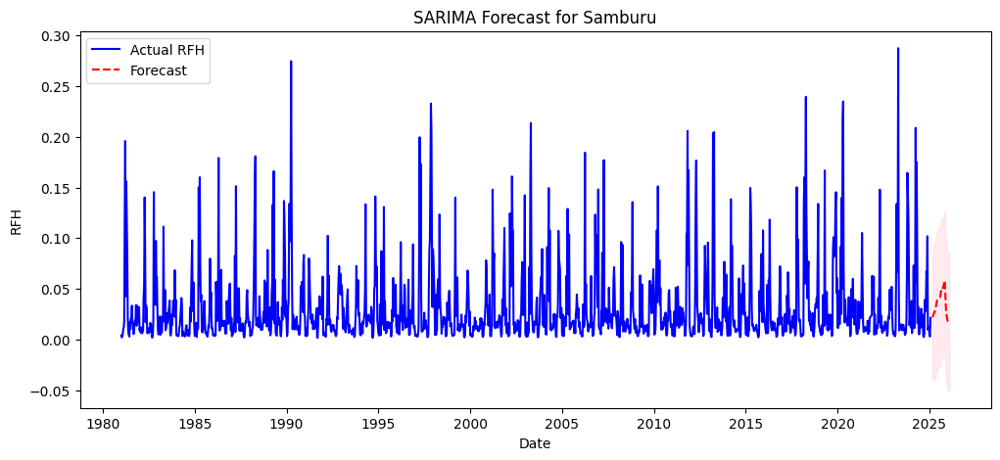


Fitting SARIMA for Siaya...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 4761
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                8118.004
Date:                            Mon, 24 Feb 2025   AIC                         -16226.009
Time:                                    11:33:28   BIC                         -16193.696
Sample:                                         0   HQIC                        -16214.652
                                           - 4761                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7197      0.008     90.560      0.000       0.704       0.735
ma.L1 

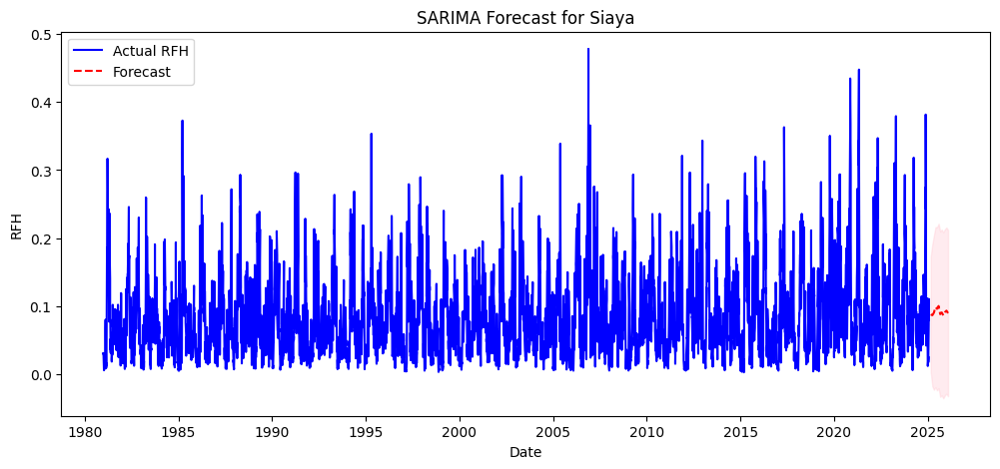


Fitting SARIMA for Kwale...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2231.942
Date:                            Mon, 24 Feb 2025   AIC                          -4453.883
Time:                                    11:33:37   BIC                          -4427.121
Sample:                                         0   HQIC                         -4443.933
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4153      0.016     25.437      0.000       0.383       0.447
ma.L1 

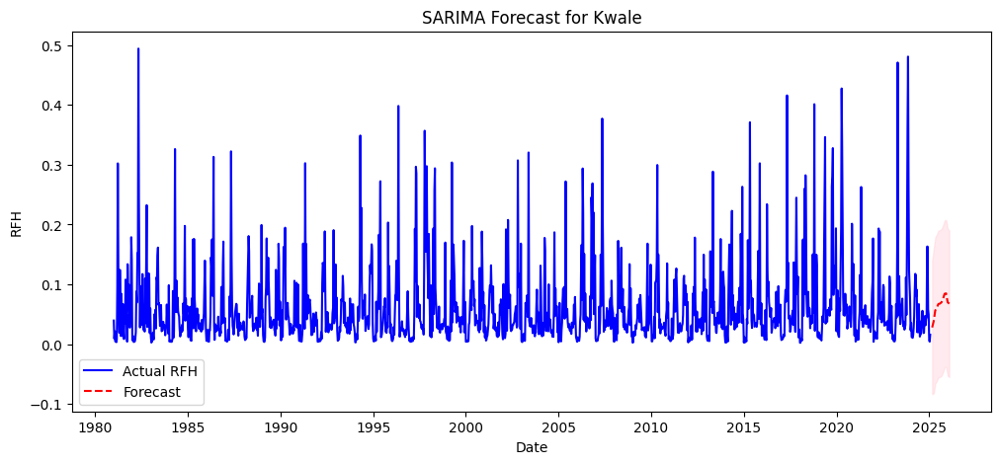


Fitting SARIMA for Taita Taveta...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2855.394
Date:                            Mon, 24 Feb 2025   AIC                          -5700.789
Time:                                    11:33:44   BIC                          -5674.027
Sample:                                         0   HQIC                         -5690.838
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4076      0.015     26.494      0.000       0.377       0.438

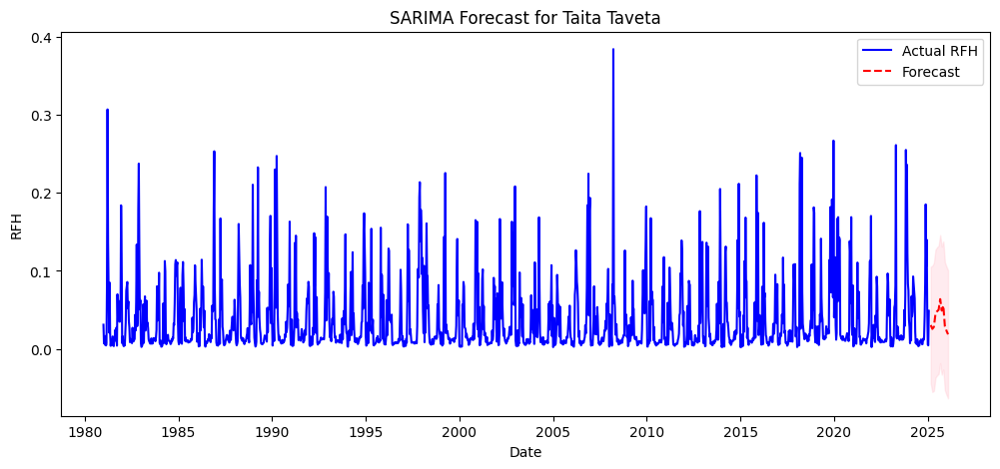


Fitting SARIMA for Kiambu...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                1958.724
Date:                            Mon, 24 Feb 2025   AIC                          -3907.447
Time:                                    11:33:52   BIC                          -3880.685
Sample:                                         0   HQIC                         -3897.497
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5038      0.014     36.287      0.000       0.477       0.531
ma.L1

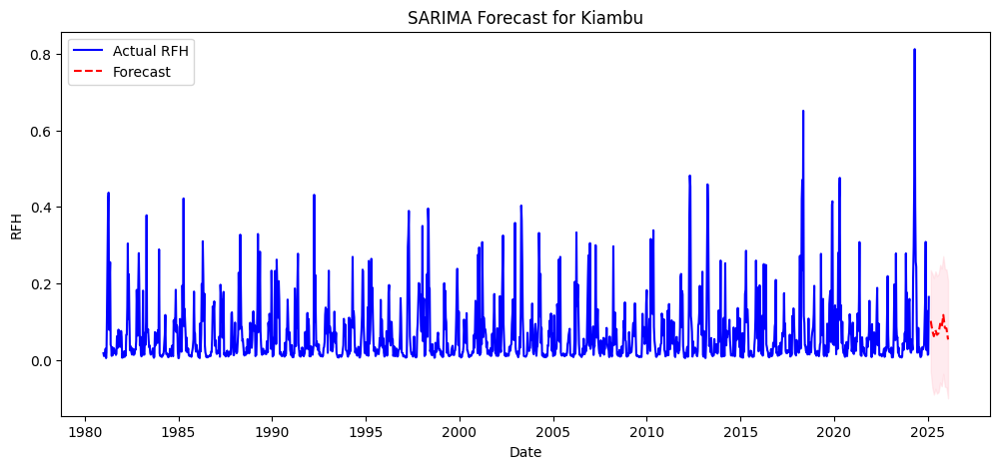


Fitting SARIMA for Kajiado...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2728.779
Date:                            Mon, 24 Feb 2025   AIC                          -5447.558
Time:                                    11:34:01   BIC                          -5420.796
Sample:                                         0   HQIC                         -5437.608
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4420      0.016     28.352      0.000       0.411       0.473
ma.L

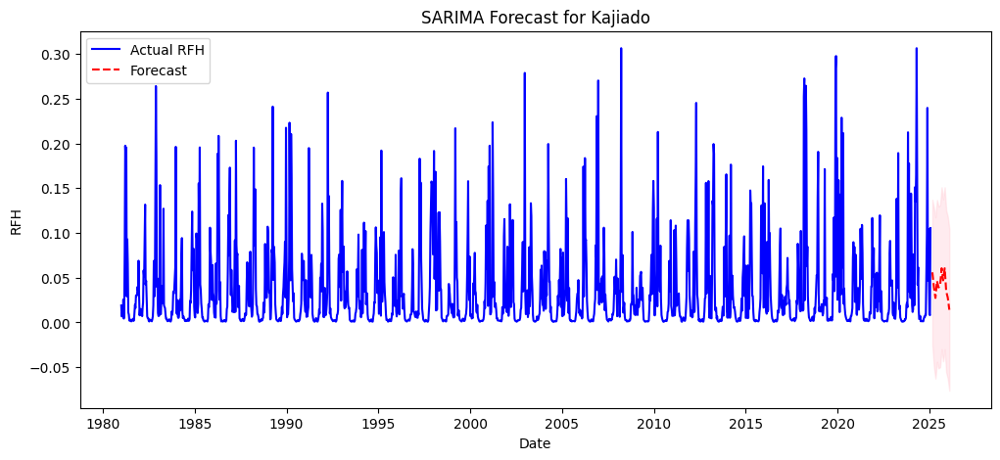


Fitting SARIMA for Isiolo...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                3390.354
Date:                            Mon, 24 Feb 2025   AIC                          -6770.707
Time:                                    11:34:12   BIC                          -6743.945
Sample:                                         0   HQIC                         -6760.757
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5401      0.012     45.978      0.000       0.517       0.563
ma.L1

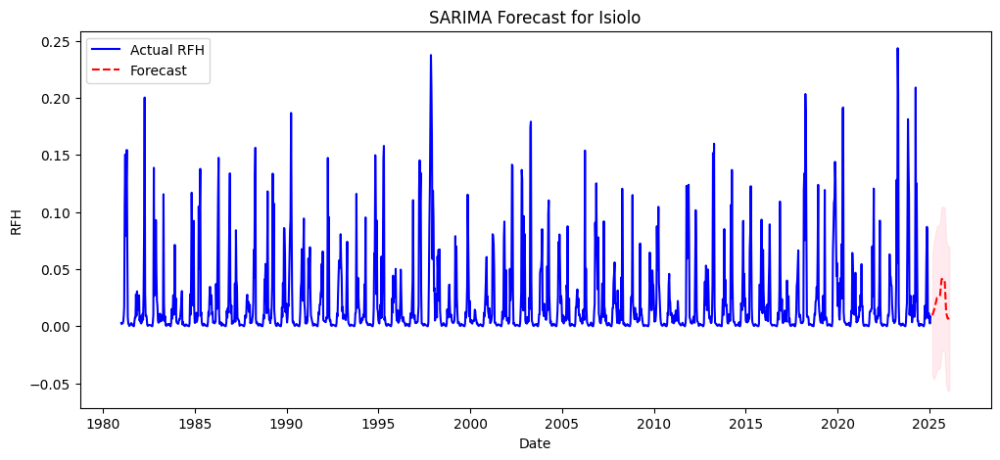


Fitting SARIMA for Makueni...
                                     SARIMAX Results                                      
Dep. Variable:                         rfh_scaled   No. Observations:                 1587
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood                2449.945
Date:                            Mon, 24 Feb 2025   AIC                          -4889.890
Time:                                    11:34:19   BIC                          -4863.128
Sample:                                         0   HQIC                         -4879.940
                                           - 1587                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4490      0.016     28.806      0.000       0.418       0.480
ma.L

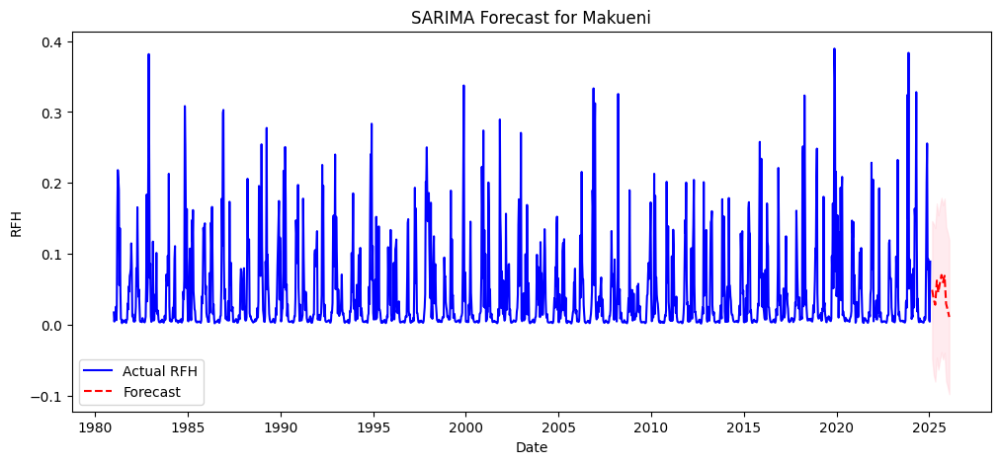

SARIMA models fitted for all counties.


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

df_cleaned['date'] = pd.to_datetime(df_cleaned['date'])
df_cleaned = df_cleaned.sort_values(by='date')

# Step 2: Check available counties
counties = df_cleaned['ADM1_EN'].unique()
print(f"Counties found: {counties}")

# Step 3: Function to Fit SARIMA for Each County
def fit_sarima(df_county, county_name):
    print(f"\nFitting SARIMA for {county_name}...")

    # Step 3.1: Set date as index and keep 'rfh'
    df_county = df_county.set_index('date')['rfh_scaled']

    # Step 3.4: Fit SARIMA Model
    p, d, q = 1, 1, 1  # ARIMA components
    P, D, Q, s = 1, 1, 1, 12  # Seasonal components (12 for monthly data)

    model = SARIMAX(df_county, order=(p, d, q), seasonal_order=(P, D, Q, s), enforce_stationarity=False, enforce_invertibility=False)
    sarima_fit = model.fit()

    print(sarima_fit.summary())

    # Step 3.5: Forecasting
    future_steps = 12  # Predict next 12 time periods
    forecast = sarima_fit.get_forecast(steps=future_steps)
    forecast_index = pd.date_range(start=df_county.index[-1], periods=future_steps + 1, freq="M")[1:]
    forecast_values = forecast.predicted_mean
    conf_int = forecast.conf_int()

    # Step 3.6: Plot Forecast
    plt.figure(figsize=(12, 5))
    plt.plot(df_county.index, df_county, label="Actual RFH", color='blue')
    plt.plot(forecast_index, forecast_values, label="Forecast", color='red', linestyle="dashed")
    plt.fill_between(forecast_index, conf_int.iloc[:, 0], conf_int.iloc[:, 1], color='pink', alpha=0.3)
    plt.title(f"SARIMA Forecast for {county_name}")
    plt.xlabel("Date")
    plt.ylabel("RFH")
    plt.legend()
    plt.show()

    return sarima_fit

# Step 4: Run SARIMA for All Counties
models = {}
for county in counties:
    df_county = df_cleaned[df_cleaned['ADM1_EN'] == county].copy()
    if not df_county.empty:
        models[county] = fit_sarima(df_county, county)

print("SARIMA models fitted for all counties.")


**Interpretation**

The SARIMA model graphs give us a clear picture of how rainfall has behaved over time and what we can expect in the future. The **blue line** shows the actual rainfall patterns, while the **red dashed line** represents the model's predictions for the coming months. Around these predictions, the **pink shaded area** marks the confidence interval, meaning the expected range of rainfall. If the forecast closely follows past trends, the model is doing a good job at capturing seasonal changes.

Epoch 1/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 8s 35ms/step - loss: 0.0304 - val_loss: 0.0258
Epoch 2/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - loss: 0.0159 - val_loss: 0.0230
Epoch 3/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0171 - val_loss: 0.0226
Epoch 4/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.0160 - val_loss: 0.0236
Epoch 5/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0167 - val_loss: 0.0246
Epoch 6/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0176 - val_loss: 0.0233
Epoch 7/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0154 - val_loss: 0.0223
Epoch 8/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.0156 - val_loss: 0.0230
Epoch 9/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0152 - val_loss: 0.0232
Epoch 10/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0155 - val_loss: 0.0226
Epoch 11/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0159 - val_loss: 0.0233
Epoch 12/50
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0

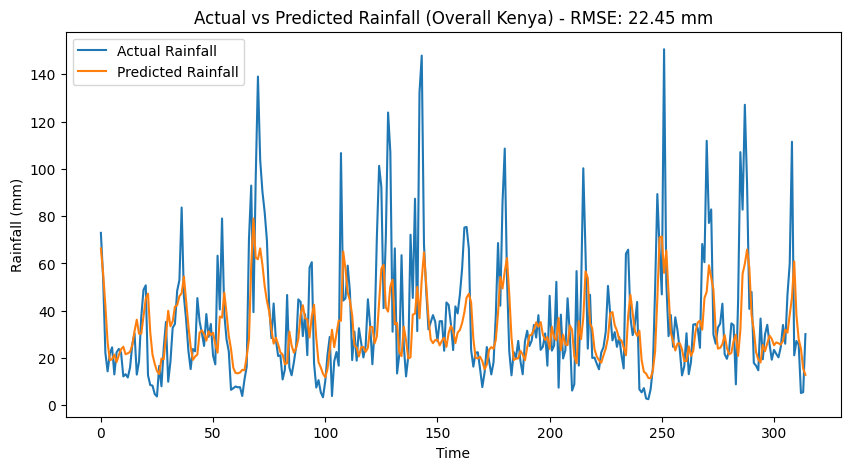

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Convert date column to datetime format
df_cleaned["date"] = pd.to_datetime(df_cleaned["date"])

# Aggregate rainfall data for all counties (e.g., taking the average)
df_grouped = df_cleaned.groupby("date")["rfh"].mean().reset_index()

# Sort by date
df_grouped = df_grouped.sort_values(by="date")

# Select rainfall data
rainfall_data = df_grouped[["rfh"]].values

# Normalize the data using MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
rainfall_scaled = scaler.fit_transform(rainfall_data)

# Function to create sequences (time-series sliding window)
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i : i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Define sequence length (e.g., 12 months for yearly seasonality)
SEQ_LENGTH = 12

# Create sequences
X, y = create_sequences(rainfall_scaled, SEQ_LENGTH)

# Split into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Build GRU model
model = Sequential([
    GRU(64, return_sequences=True, input_shape=(SEQ_LENGTH, 1)),  # First GRU layer
    Dropout(0.2),  # Dropout to prevent overfitting
    GRU(32, return_sequences=False),  # Second GRU layer
    Dropout(0.2),
    Dense(1)  # Output layer for rainfall prediction
])

# Compile the model
model.compile(optimizer="adam", loss="mean_squared_error")

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=16, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_pred = model.predict(X_test)

# Inverse transform to get actual rainfall values
y_pred_actual = scaler.inverse_transform(y_pred)
y_test_actual = scaler.inverse_transform(y_test)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test_actual, y_pred_actual))
print(f"Root Mean Squared Error (RMSE): {rmse:.2f} mm")

# Plot actual vs predicted values
plt.figure(figsize=(10,5))
plt.plot(y_test_actual, label="Actual Rainfall")
plt.plot(y_pred_actual, label="Predicted Rainfall", linestyle="solid")
plt.legend()
plt.title(f"Actual vs Predicted Rainfall (Overall Kenya) - RMSE: {rmse:.2f} mm")
plt.xlabel("Time")
plt.ylabel("Rainfall (mm)")
plt.show()


##**Optimized GRU model**

Epoch 1/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 11s 80ms/step - loss: 1.2497 - val_loss: 0.0607
Epoch 2/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - loss: 1.0294 - val_loss: 0.0488
Epoch 3/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step - loss: 1.0798 - val_loss: 0.0484
Epoch 4/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - loss: 1.0016 - val_loss: 0.0456
Epoch 5/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 56ms/step - loss: 0.8783 - val_loss: 0.0452
Epoch 6/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - loss: 0.8700 - val_loss: 0.0457
Epoch 7/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - loss: 0.8316 - val_loss: 0.0545
Epoch 8/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.7972 - val_loss: 0.0545
Epoch 9/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - loss: 0.7185 - val_loss: 0.0546
Epoch 10/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step - loss: 0.6495 - val_loss: 0.0497
Epoch 11/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 57ms/step - loss: 0.7329 - val_loss: 0.0439
Epoch 12/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/ste

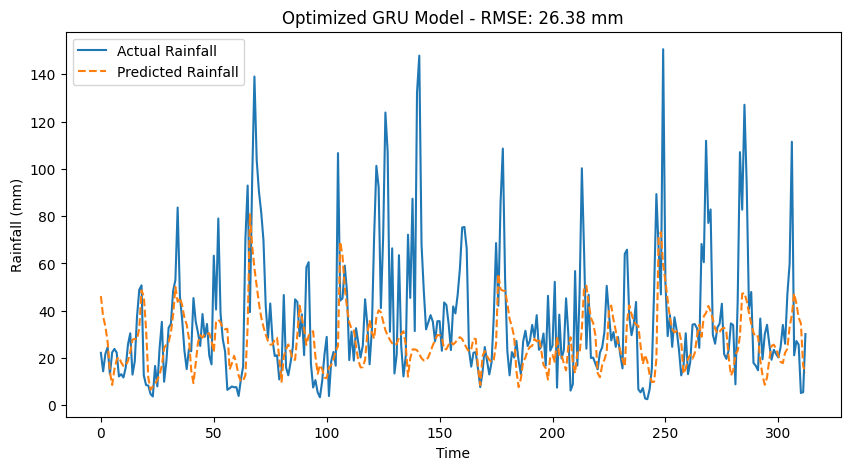

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Convert date column to datetime format
df_cleaned["date"] = pd.to_datetime(df_cleaned["date"])

# Aggregate rainfall data for all counties (e.g., taking the average)
df_grouped = df_cleaned.groupby("date")["rfh"].mean().reset_index()

# Sort by date
df_grouped = df_grouped.sort_values(by="date")

# Select rainfall data
rainfall_data = df_grouped[["rfh"]].values

# Normalize the data using MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
rainfall_scaled = scaler.fit_transform(rainfall_data)

# Function to create sequences (time-series sliding window)
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i : i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Increase sequence length for better long-term patterns
SEQ_LENGTH = 24  # Increased from 12 to 24 (2-year trend)

# Create sequences
X, y = create_sequences(rainfall_scaled, SEQ_LENGTH)

# Split into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Build an improved GRU model
model = Sequential([
    GRU(128, return_sequences=True, input_shape=(SEQ_LENGTH, 1)),  # Increased units
    BatchNormalization(),
    Dropout(0.3),  # Higher dropout

    GRU(64, return_sequences=True),
    BatchNormalization(),
    Dropout(0.3),

    GRU(32, return_sequences=False),
    BatchNormalization(),
    Dropout(0.3),

    Dense(1)  # Output layer
])

# Compile the model with a lower learning rate
optimizer = Adam(learning_rate=0.0001)  # Reduced learning rate
model.compile(optimizer=optimizer, loss="mean_squared_error")

# Train the model for more epochs
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_pred = model.predict(X_test)

# Inverse transform to get actual rainfall values
y_pred_actual = scaler.inverse_transform(y_pred)
y_test_actual = scaler.inverse_transform(y_test)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test_actual, y_pred_actual))
print(f"Root Mean Squared Error (RMSE): {rmse:.2f} mm")

# Plot actual vs predicted values
plt.figure(figsize=(10,5))
plt.plot(y_test_actual, label="Actual Rainfall")
plt.plot(y_pred_actual, label="Predicted Rainfall", linestyle="dashed")
plt.legend()
plt.title(f"Optimized GRU Model - RMSE: {rmse:.2f} mm")
plt.xlabel("Time")
plt.ylabel("Rainfall (mm)")
plt.show()


##**GRU with robust scaler**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


# Convert date column to datetime format
df_cleaned["date"] = pd.to_datetime(df_cleaned["date"])

# Aggregate rainfall data for all counties (e.g., taking the average)
df_grouped = df_cleaned.groupby("date")["rfh"].mean().reset_index()

# Sort by date
df_grouped = df_grouped.sort_values(by="date")

# Select rainfall data
rainfall_data = df_grouped[["rfh"]].values

# Normalize the data using RobustScaler
scaler = RobustScaler()
rainfall_scaled = scaler.fit_transform(rainfall_data)

# Function to create sequences (time-series sliding window)
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i : i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Increase sequence length for better long-term patterns
SEQ_LENGTH = 24  # Using a 2-year trend

# Create sequences
X, y = create_sequences(rainfall_scaled, SEQ_LENGTH)

# Split into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Build an improved GRU model
model = Sequential([
    GRU(128, return_sequences=True, input_shape=(SEQ_LENGTH, 1)),  # First GRU layer
    BatchNormalization(),
    Dropout(0.3),  # Dropout to prevent overfitting

    GRU(64, return_sequences=True),
    BatchNormalization(),
    Dropout(0.3),

    GRU(32, return_sequences=False),
    BatchNormalization(),
    Dropout(0.3),

    Dense(1)  # Output layer
])

# Compile the model with a lower learning rate
optimizer = Adam(learning_rate=0.0005)  # Reduced learning rate
model.compile(optimizer=optimizer, loss="mean_squared_error")

# Train the model for more epochs
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_pred = model.predict(X_test)

# Inverse transform to get actual rainfall values
y_pred_actual = scaler.inverse_transform(y_pred)
y_test_actual = scaler.inverse_transform(y_test)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test_actual, y_pred_actual))
print(f"Root Mean Squared Error (RMSE): {rmse:.2f} mm")

# Plot actual vs predicted values
plt.figure(figsize=(10,5))
plt.plot(y_test_actual, label="Actual Rainfall")
plt.plot(y_pred_actual, label="Predicted Rainfall", linestyle="dashed")
plt.legend()
plt.title(f"Optimized GRU Model with RobustScaler - RMSE: {rmse:.2f} mm")
plt.xlabel("Time")
plt.ylabel("Rainfall (mm)")
plt.show()


In [ ]:
# Dictionary to store county datasets
county_dfs = {}

for county in df_cleaned['ADM1_EN'].unique():
    county_dfs[county] = df_cleaned[df_cleaned['ADM1_EN'] == county]

In [ ]:
for county, county_df in county_dfs.items():
    print(f"Training LSTM model for {county}...")

    # Preprocess county-specific data
    county_data = county_df[['date', 'rfh']]  # Select relevant columns
    county_data.set_index('date', inplace=True)  # Set date as index
    county_data = county_data.sort_index()  # Ensure chronological order
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

# preprocess the data
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df_cleaned[['rfh']])  # Scale the target variable

Training LSTM model for Kirinyaga...
Training LSTM model for Murang'a...
Training LSTM model for Baringo...
Training LSTM model for Bomet...
Training LSTM model for Kajiado...
Training LSTM model for Elgeyo-Marakwet...
Training LSTM model for Kericho...
Training LSTM model for Kiambu...
Training LSTM model for Laikipia...
Training LSTM model for Bungoma...
Training LSTM model for Nakuru...
Training LSTM model for Siaya...
Training LSTM model for Marsabit...
Training LSTM model for Vihiga...
Training LSTM model for Busia...
Training LSTM model for Kakamega...
Training LSTM model for West Pokot...
Training LSTM model for Uasin Gishu...
Training LSTM model for Turkana...
Training LSTM model for Trans Nzoia...
Training LSTM model for Narok...
Training LSTM model for Samburu...
Training LSTM model for Nyandarua...
Training LSTM model for Garissa...
Training LSTM model for Mandera...
Training LSTM model for Wajir...
Training LSTM model for Kisii...
Training LSTM model for Homa Bay...
Trainin

In [ ]:
# Create sequences
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:i+seq_length])
        y.append(data[i+seq_length])
    return np.array(X), np.array(y)

seq_length = 10  # Use 10 days of past data to predict the next day
X, y = create_sequences(df_scaled, seq_length)

# Split into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
# Reshape for LSTM (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Build LSTM model
model = Sequential([
    LSTM(50, return_sequences=True, input_shape=(seq_length, 1)),
    Dropout(0.2),
    LSTM(50, return_sequences=False),
    Dropout(0.2),
    Dense(25, 'relu'),
    Dense(1, 'linear')
])

model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 10, 50)              │          10,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 10, 50)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 50)                  │          20,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_10 (Dropout)                 │ (None, 50)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 25)                  │           1,275 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 1)                   │              26 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 31,901 (124.61 KB)

 Trainable params: 31,901 (124.61 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile the model
cp1 = ModelCheckpoint('model/best_model.keras', save_best_only=True)
model.compile(optimizer=Adam(learning_rate=0.0001), metrics=[RootMeanSquaredError()], loss=MeanSquaredError())

In [ ]:
# Train the model
model.fit(X_train, y_train, batch_size=16, epochs=20, validation_data=(X_test, y_test), callbacks=[cp1])

# Make predictions
predictions = model.predict(X_test)
predictions = scaler.inverse_transform(predictions)  # Rescale to original values

Epoch 1/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 69s 11ms/step - loss: 0.0042 - root_mean_squared_error: 0.0648 - val_loss: 0.0040 - val_root_mean_squared_error: 0.0632
Epoch 2/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 67s 12ms/step - loss: 0.0033 - root_mean_squared_error: 0.0573 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0622
Epoch 3/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 68s 12ms/step - loss: 0.0033 - root_mean_squared_error: 0.0574 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0624
Epoch 4/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 82s 12ms/step - loss: 0.0033 - root_mean_squared_error: 0.0575 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0621
Epoch 5/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 65s 11ms/step - loss: 0.0033 - root_mean_squared_error: 0.0574 - val_loss: 0.0038 - val_root_mean_squared_error: 0.0619
Epoch 6/20
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 80s 11ms/step - loss: 0.0033 - root_mean_squared_error: 0.0576 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0622
Epoch 7/20
5792/5792 ━━━━━━━

In [ ]:
from tensorflow.keras.models import load_model
model1 = load_model('model/best_model.keras')

In [ ]:
train_predictions = model.predict(X_train).flatten()  # Flatten the predictions to 1D
y_train = y_train.flatten()  # Flatten the actuals to 1D if necessary

train_results = pd.DataFrame(data={'Train Predictions': train_predictions, 'Actuals': y_train})
train_results


2896/2896 ━━━━━━━━━━━━━━━━━━━━ 12s 4ms/step


,Train Predictions,Actuals
0,0.176733,0.388474
1,0.202307,0.146405
2,0.137344,0.341976
3,0.150087,0.210575
4,0.133556,0.040243
...,...,...
92667,0.012196,0.006763
92668,0.012478,0.012759
92669,0.019214,0.007317
92670,0.016010,0.006239


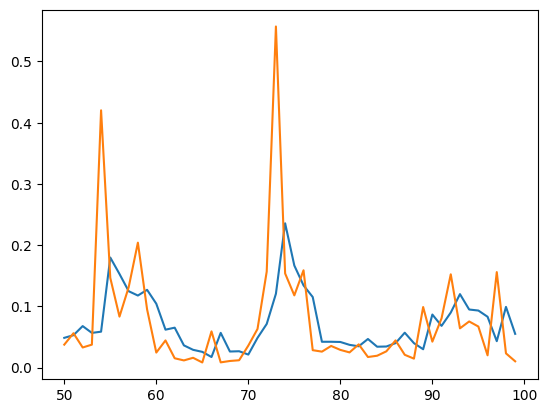

In [ ]:
plt.plot(train_results['Train Predictions'][50:100])
plt.plot(train_results['Actuals'][50:100])

In [ ]:
val_predictions = model1.predict(X_test).flatten()
y_test = y_test.flatten()
val_results = pd.DataFrame(data={'Val Predictions':val_predictions, 'Actuals':y_test})
val_results

725/725 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step


,Val Predictions,Actuals
0,0.024085,0.015049
1,0.030750,0.016000
2,0.033709,0.014622
3,0.033255,0.015495
4,0.033976,0.012890
...,...,...
23164,0.084650,0.066138
23165,0.103070,0.073387
23166,0.080375,0.010148
23167,0.031395,0.013797


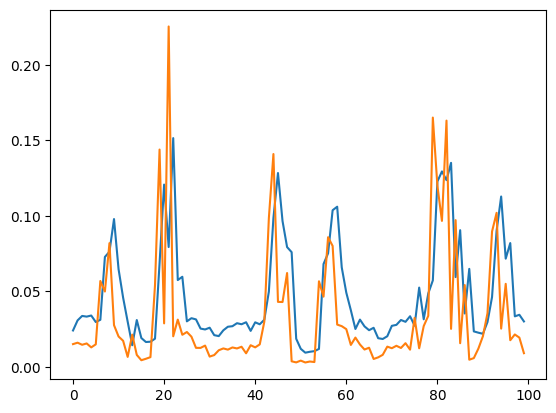

In [ ]:
plt.plot(val_results['Val Predictions'][:100])
plt.plot(val_results['Actuals'][:100])

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Load and preprocess data
scaler = MinMaxScaler(feature_range=(0, 1))
df_scaled = scaler.fit_transform(df_cleaned[['rfh']])

# Create sequences
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:i+seq_length])
        y.append(data[i+seq_length])
    return np.array(X), np.array(y)

seq_length = 10
X, y = create_sequences(df_scaled, seq_length)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape for LSTM
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

# Build the optimized LSTM model
model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(seq_length, 1)),
    BatchNormalization(),
    Dropout(0.2),

    LSTM(64, return_sequences=False),
    BatchNormalization(),
    Dropout(0.2),

    Dense(32, activation='relu'),
    Dense(1, activation='linear')
])

# Compile model
optimizer = Adam(learning_rate=1e-5)
model.compile(optimizer=optimizer, loss='mse', metrics=[tf.keras.metrics.RootMeanSquaredError()])

# Callbacks
es = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
cp1 = ModelCheckpoint('model/best_model.keras', save_best_only=True)

# Train the model
model.fit(X_train, y_train, batch_size=16, epochs=50, validation_data=(X_test, y_test), shuffle=True, callbacks=[es, cp1])

# Make predictions
predictions = model.predict(X_test)
y_test_inv = scaler.inverse_transform(y_test.reshape(-1, 1))
predictions_inv = scaler.inverse_transform(predictions)

# Evaluate performance
rmse = np.sqrt(mean_squared_error(y_test_inv, predictions_inv))
print(f"Test RMSE: {rmse}")


Epoch 1/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 73s 12ms/step - loss: 0.1422 - root_mean_squared_error: 0.3746 - val_loss: 0.0064 - val_root_mean_squared_error: 0.0801
Epoch 2/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 72s 12ms/step - loss: 0.0463 - root_mean_squared_error: 0.2148 - val_loss: 0.0060 - val_root_mean_squared_error: 0.0773
Epoch 3/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 73s 13ms/step - loss: 0.0213 - root_mean_squared_error: 0.1457 - val_loss: 0.0054 - val_root_mean_squared_error: 0.0734
Epoch 4/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 77s 12ms/step - loss: 0.0126 - root_mean_squared_error: 0.1121 - val_loss: 0.0045 - val_root_mean_squared_error: 0.0670
Epoch 5/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 81s 12ms/step - loss: 0.0086 - root_mean_squared_error: 0.0925 - val_loss: 0.0046 - val_root_mean_squared_error: 0.0681
Epoch 6/50
5792/5792 ━━━━━━━━━━━━━━━━━━━━ 85s 12ms/step - loss: 0.0063 - root_mean_squared_error: 0.0794 - val_loss: 0.0044 - val_root_mean_squared_error: 0.0663
Epoch 7/50
5792/5792 ━━━━━━━

In [ ]:
train_predictions = model.predict(X_train).flatten()  # Flatten the predictions to 1D
y_train = y_train.flatten()  # Flatten the actuals to 1D if necessary

train_results = pd.DataFrame(data={'Train Predictions': train_predictions, 'Actuals': y_train})
train_results


2896/2896 ━━━━━━━━━━━━━━━━━━━━ 14s 5ms/step


,Train Predictions,Actuals
0,0.164235,0.388474
1,0.194914,0.146405
2,0.144345,0.341976
3,0.164886,0.210575
4,0.140094,0.040243
...,...,...
92667,0.018497,0.006763
92668,0.019179,0.012759
92669,0.023091,0.007317
92670,0.022753,0.006239


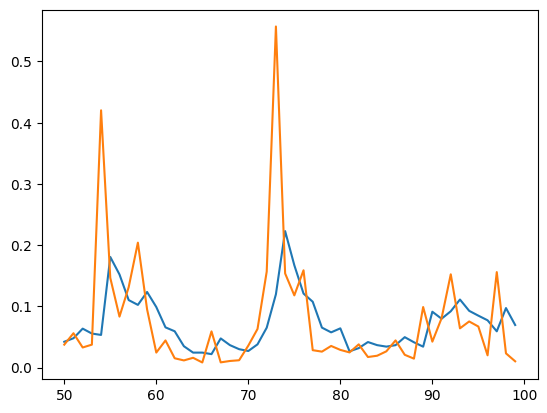

In [ ]:
plt.plot(train_results['Train Predictions'][50:100])
plt.plot(train_results['Actuals'][50:100])

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Convert date column to datetime format
df_cleaned["date"] = pd.to_datetime(df_cleaned["date"])

# Aggregate rainfall data for all counties (e.g., taking the average)
df_grouped = df_cleaned.groupby("date")["rfh"].mean().reset_index()

# Sort by date
df_grouped = df_grouped.sort_values(by="date")

# Select rainfall data
rainfall_data = df_grouped[["rfh"]].values

# Normalize the data using MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
rainfall_scaled = scaler.fit_transform(rainfall_data)

# Function to create sequences (time-series sliding window)
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i : i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Define sequence length (e.g., 12 months for yearly seasonality)
SEQ_LENGTH = 12

# Create sequences
X, y = create_sequences(rainfall_scaled, SEQ_LENGTH)

# Split into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Build LSTM model
model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(SEQ_LENGTH, 1)),  # First LSTM layer
    Dropout(0.2),  # Dropout to prevent overfitting
    LSTM(32, return_sequences=False),  # Second LSTM layer
    Dropout(0.2),
    Dense(1)  # Output layer for rainfall prediction
])

# Compile the model
model.compile(optimizer="adam", loss="mean_squared_error")

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=16, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_pred = model.predict(X_test)

# Inverse transform to get actual rainfall values
y_pred_actual = scaler.inverse_transform(y_pred)
y_test_actual = scaler.inverse_transform(y_test)

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(y_test_actual, y_pred_actual))
print(f"Root Mean Squared Error (RMSE): {rmse:.2f} mm")

# Plot actual vs predicted values
plt.figure(figsize=(10,5))
plt.plot(y_test_actual, label="Actual Rainfall")
plt.plot(y_pred_actual, label="Predicted Rainfall", linestyle="dashed")
plt.legend()
plt.title(f"Actual vs Predicted Rainfall (Overall Kenya) - RMSE: {rmse:.2f} mm")
plt.xlabel("Time")
plt.ylabel("Rainfall (mm)")
plt.show()


In [ ]:
train_predictions = model.predict(X_train).flatten()  # Flatten the predictions to 1D
y_train = y_train.flatten()  # Flatten the actuals to 1D if necessary

train_results = pd.DataFrame(data={'Train Predictions': train_predictions, 'Actuals': y_train})
train_results


In [ ]:
plt.plot(train_results['Train Predictions'][:100])
plt.plot(train_results['Actuals'][:100])

In [ ]:
val_predictions = model1.predict(X_test).flatten()
y_test = y_test.flatten()
val_results = pd.DataFrame(data={'Val Predictions':val_predictions, 'Actuals':y_test})
val_results

In [ ]:
plt.plot(val_results['Val Predictions'][:100])
plt.plot(val_results['Actuals'][:100])

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Load dataset
# Assume DF_CLEANED has a 'month' column

def create_lag_features(df, lags):
    for col in ['rfh', 'r1h', 'r3h', 'rfq', 'r1q', 'r3q']:
        for lag in lags:
            df_cleaned[f'{col}_lag_{lag}'] = df_cleaned[col].shift(lag)
    return df.dropna()

def train_model(df):
    models = {}
    scalers = {}
    metrics = {}

    selected_features = ['rfh', 'r1h', 'r3h', 'rfq', 'r1q', 'r3q', 'month']

    df = create_lag_features(df, [1, 2, 3, 4, 5])
    df = df[selected_features]

    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(df)

    X = scaled_data[:, :-1]  # Features
    y = scaled_data[:, -1]   # Target variable (rfh)

    # Splitting the dataset
    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, shuffle=False)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)

    # Reshape input
    X_train = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
    X_val = X_val.reshape((X_val.shape[0], 1, X_val.shape[1]))
    X_test = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

    # Define the model
    model = Sequential()
    model.add(Bidirectional(LSTM(50, return_sequences=True), input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(0.2))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(1))

    model.compile(optimizer='adam', loss='mean_squared_error')

    def scheduler(epoch, lr):
        return lr if epoch < 10 else lr * np.exp(-0.1)

    lr_scheduler = LearningRateScheduler(scheduler)
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Train the model
    model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_val, y_val),
              callbacks=[lr_scheduler, early_stopping], verbose=1)

    # Evaluate the model
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)

    # Inverse transform predictions
    y_train_inv = scaler.inverse_transform(np.concatenate((X_train.reshape(X_train.shape[0], -1),
                                                           y_train.reshape(-1, 1)), axis=1))[:, -1]
    y_test_inv = scaler.inverse_transform(np.concatenate((X_test.reshape(X_test.shape[0], -1),
                                                          y_test.reshape(-1, 1)), axis=1))[:, -1]
    train_predict_inv = scaler.inverse_transform(np.concatenate((X_train.reshape(X_train.shape[0], -1),
                                                                 train_predict), axis=1))[:, -1]
    test_predict_inv = scaler.inverse_transform(np.concatenate((X_test.reshape(X_test.shape[0], -1),
                                                                test_predict), axis=1))[:, -1]

    train_rmse = np.sqrt(mean_squared_error(y_train_inv, train_predict_inv))
    test_rmse = np.sqrt(mean_squared_error(y_test_inv, test_predict_inv))
    train_mae = mean_absolute_error(y_train_inv, train_predict_inv)
    test_mae = mean_absolute_error(y_test_inv, test_predict_inv)

    print(f'Train RMSE: {train_rmse}, Test RMSE: {test_rmse}')
    print(f'Train MAE: {train_mae}, Test MAE: {test_mae}')

    # Store model and scaler
    models['rainfall_model'] = model
    scalers['rainfall_scaler'] = scaler
    metrics['rainfall_metrics'] = {'train_rmse': train_rmse, 'test_rmse': test_rmse, 'train_mae': train_mae, 'test_mae': test_mae}

    return models, scalers, metrics

# Train model without county filter
models, scalers, metrics = train_model(df_cleaned)


Epoch 1/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.1112 - val_loss: 0.0991 - learning_rate: 0.0010
Epoch 2/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 20s 6ms/step - loss: 0.0984 - val_loss: 0.0966 - learning_rate: 0.0010
Epoch 3/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 23s 7ms/step - loss: 0.0979 - val_loss: 0.0942 - learning_rate: 0.0010
Epoch 4/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 15s 6ms/step - loss: 0.0947 - val_loss: 0.0861 - learning_rate: 0.0010
Epoch 5/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 21s 6ms/step - loss: 0.0920 - val_loss: 0.0834 - learning_rate: 0.0010
Epoch 6/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 18s 5ms/step - loss: 0.0897 - val_loss: 0.0816 - learning_rate: 0.0010
Epoch 7/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - loss: 0.0869 - val_loss: 0.0806 - learning_rate: 0.0010
Epoch 8/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 15s 6ms/step - loss: 0.0855 - val_loss: 0.0785 - learning_rate: 0.0010
Epoch 9/100
2535/2535 ━━━━━━━━━━━━━━━━━━━━ 16s 6ms/step - loss: 0.0836 - val_loss: 0.076

3621/3621 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step


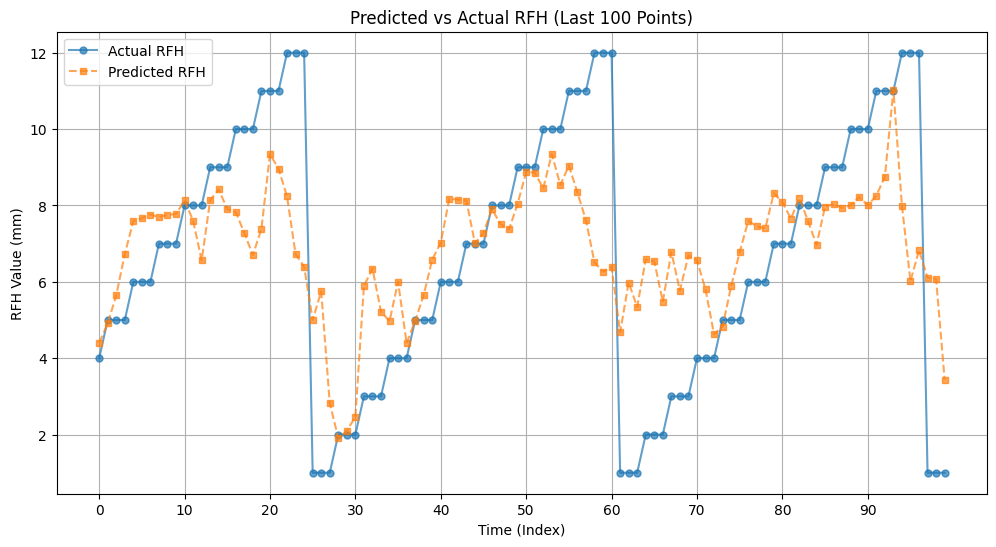

In [ ]:
import matplotlib.pyplot as plt

def plot_predicted_vs_actual(models, scalers, df, sample_size=100):
    model = models['rainfall_model']
    scaler = scalers['rainfall_scaler']

    selected_features = ['rfh', 'r1h', 'r3h', 'rfq', 'r1q', 'r3q', 'month']

    # Use the most recent data and drop NaN values
    df = df[selected_features].dropna()

    # Scale data
    scaled_data = scaler.transform(df)

    # Split data into features and target
    X = scaled_data[:, :-1]
    y_actual = scaled_data[:, -1]

    # Reshape for LSTM
    X_reshaped = X.reshape((X.shape[0], 1, X.shape[1]))

    # Predict
    y_pred_scaled = model.predict(X_reshaped)

    # Inverse transform predictions and actual values
    y_actual_inv = scaler.inverse_transform(np.concatenate((X, y_actual.reshape(-1, 1)), axis=1))[:, -1]
    y_pred_inv = scaler.inverse_transform(np.concatenate((X, y_pred_scaled), axis=1))[:, -1]

    # Select the most recent sample_size points
    y_actual_inv = y_actual_inv[-sample_size:]
    y_pred_inv = y_pred_inv[-sample_size:]
    x_range = range(len(y_actual_inv))  # X-axis indices

    # Plot
    plt.figure(figsize=(12, 6))
    plt.plot(x_range, y_actual_inv, label="Actual RFH", marker='o', linestyle='-', alpha=0.7, markersize=5)
    plt.plot(x_range, y_pred_inv, label="Predicted RFH", marker='s', linestyle='--', alpha=0.7, markersize=5)

    plt.xlabel("Time (Index)")
    plt.ylabel("RFH Value (mm)")
    plt.title(f"Predicted vs Actual RFH (Last {sample_size} Points)")
    plt.legend()
    plt.grid(True)
    plt.xticks(range(0, sample_size, max(1, sample_size // 10)))  # Reduce x-axis labels
    plt.show()

# Call the function (Plot last 100 points for clarity)
plot_predicted_vs_actual(models, scalers, df_cleaned, sample_size=100)
